# ECG EDA

Verify usage of GPU. If Num GPUs Available is 0, consider enabling at least one. Otherwise, the models take too long to fit. 

To avoid an error when loading *torch\lib\cublas64_11.dll*, we have to import torch before tensorflow.

In [1]:
# import torch
# print("Num GPUs Available: ", torch.cuda.device_count())

In [2]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


Import modules.

In [3]:
# Data manipulation
import numpy as np
import pandas as pd

# Python waveform-database (WFDB) package
import wfdb

# Visualization
import matplotlib.pyplot as plt
import matplotlib
from matplotlib.lines import Line2D
import seaborn as sns

# scikit-learn
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

# Tensorflow
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, InputLayer
from tensorflow.keras.layers import Conv2D, Conv1D, MaxPool1D, MaxPool2D
from tensorflow.keras.layers import Dense, Flatten, Concatenate
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.layers import ReLU, LeakyReLU
from tensorflow.keras.layers import concatenate 
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import L1 


# # PyTorch
# from torch import nn
# #!pip install torchsummary
# from torchsummary import summary

# Other
import os
import random
from loess.loess_1d import loess_1d
from statsmodels.nonparametric.smoothers_lowess import lowess

# User defined
import scripts.plots_aux as pa
import scripts.load_data_aux as ld
import scripts.manipulate_data_aux as md
import scripts.utils_ecg as ue

# Downloaded scripts
from scripts.antonior92 import get_model

# Allow user defined modules to be dinamically updated
%load_ext autoreload
%autoreload 2

## Parameters

In [4]:
# Path to imagess folder
imgs_path = "imgs/"

# General random seed for replicability
random_state = 203129

# N of examples when plotting for each dx
n_sample = 5

# Fixed set of colors to identify the urgency level
urgency_colors = {1: '#EC0D0D', 2:'#EC7D0D', 3:'#E9EC0D', 4:'#0DEC84'}

# N of examples to plot the confusion matrix
n_ex = 500

# Thresholds to have more recall on specific classes
mi_threshold = 0.2
ms_threshold = 0.3
thresholds = {'PTB-XL':               
              {'MI' : 
                {'idx' : 0, 
                 'threshold' : mi_threshold},               
               'MI&STTC' : 
                {'idx' : 2,
                 'threshold' : ms_threshold}
              }
             }

# N of epochs for training models
epochs = 50

# Batch size for training models
batch_size = 64

## Load labels

In [5]:
labels = ld.load_labels('data/')
labels.head()

,Diagnostic Description,Abbreviation,Urgency,CPSC,CPSC-Extra,StPetersburg,PTB,PTB-XL,Georgia,Total,Notes,Kind
SNOMED CT Code,,,,,,,,,,,,
270492004,1st degree av block,IAVB,4,722,106,0,0,797,769,2394,NaN,most
164889003,atrial fibrillation,AF,4,1221,153,2,15,1514,570,3475,NaN,most
164890007,atrial flutter,AFL,4,0,54,0,1,73,186,314,NaN,most
426627000,bradycardia,Brady,4,0,271,11,0,0,6,288,NaN,most
713427006,complete right bundle branch block,CRBBB,3,0,113,0,0,542,28,683,We score 713427006 and 59118001 as the same di...,most


## Initial exploration

We first visualize the data we are working with.

In [6]:
current_db = 'PTB-XL'
path = f'data/{current_db}/'
files = os.listdir(path)
hea_files = [file[:-4] for file in files if 'hea' in file]

Let's plot some of these.

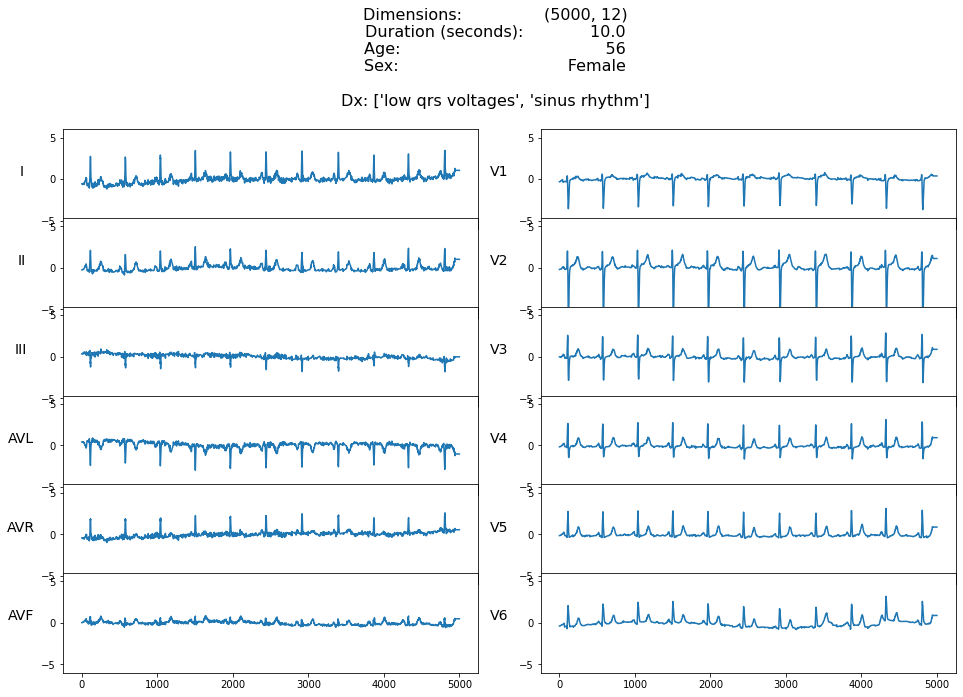

In [7]:
k = 0
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

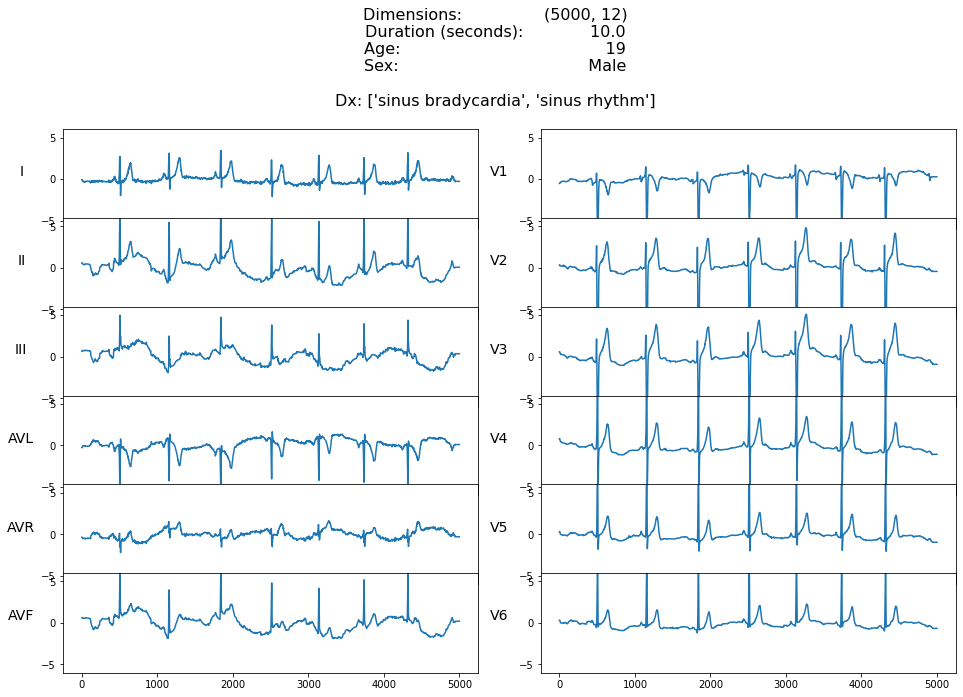

In [8]:
k = 1
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

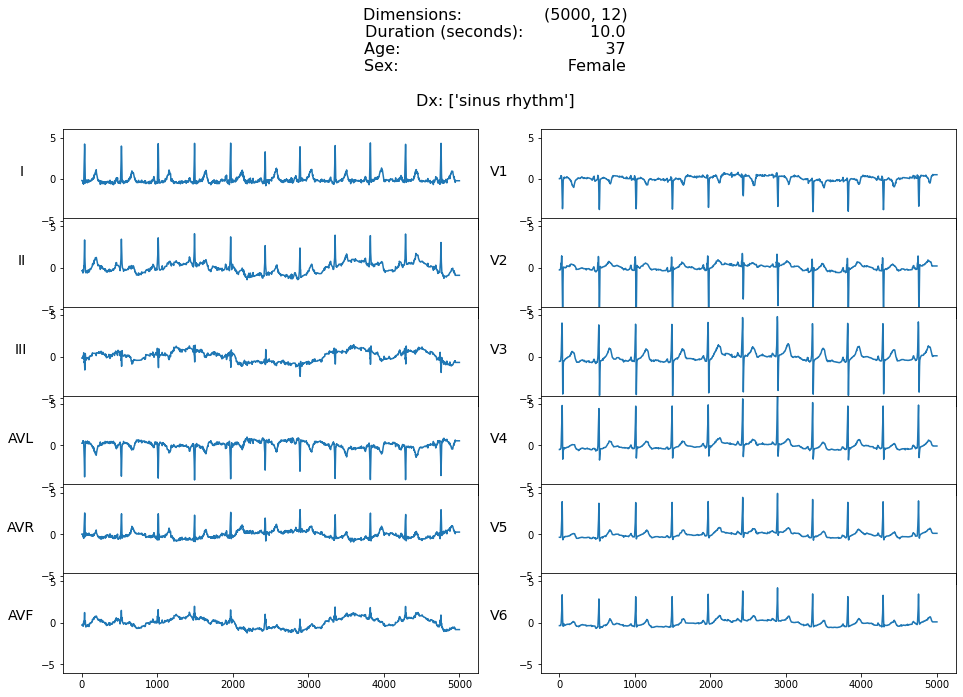

In [9]:
k = 2
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

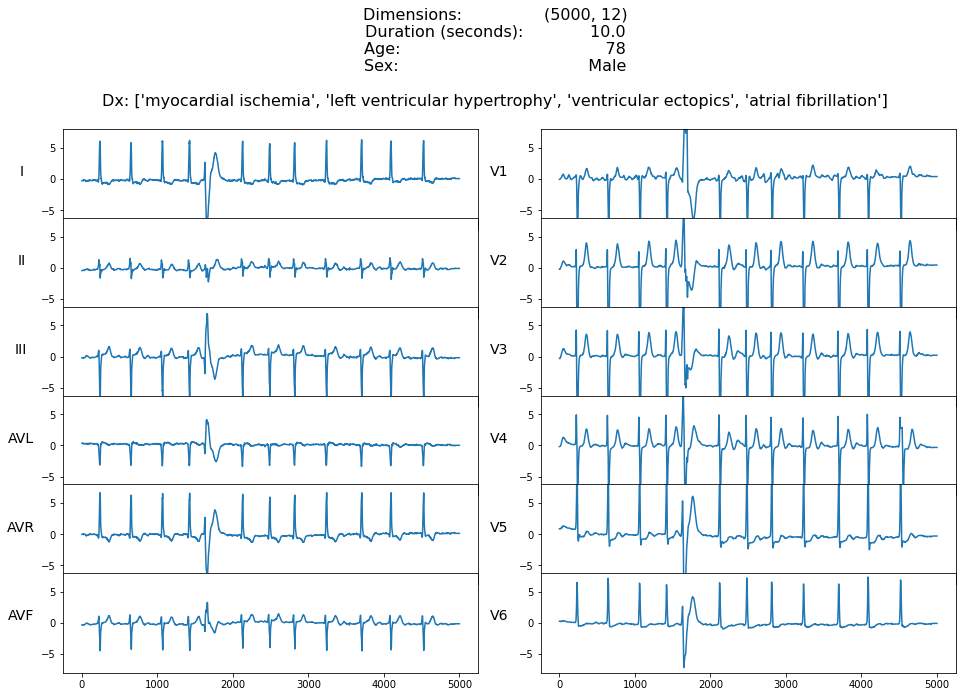

In [10]:
k = 451
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], ylim=(-8,8), metadata=metadata)

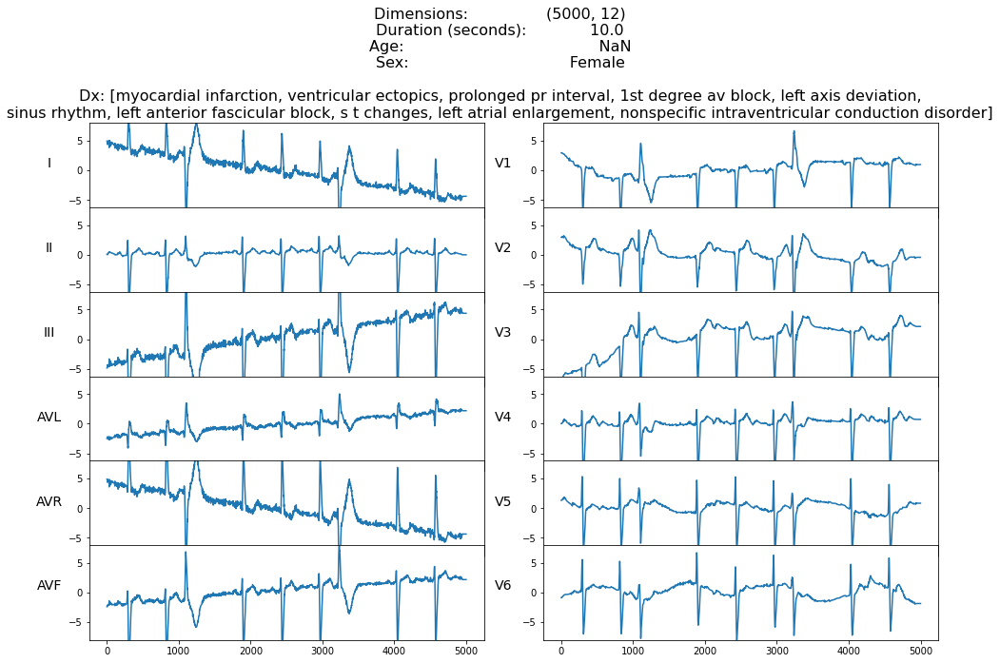

In [11]:
# We put this example just to remember that we still need to make some upgrades to the visualization
k = 1188
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], ylim=(-8,8), metadata=metadata)

### Get all data

Retrieve the signal and the metadata for each file. This takes a like 2-3 minutes for the PTB-XL db.

# Note: It would be best to have a process do the loading and the initial data preprocessing in one go, since doing both separated is slower I think.

In [12]:
# Initialize empty lists
X = []
Y = []

# Given the wfdb.rdsamp tuple, pass its values to X and Y, respectively
for file in hea_files:
    f = wfdb.rdsamp(path+file)
    X.append(f[0])
    Y.append(f[1])

Preprocess these to make them more easily usable. This takes like 4 minutes for the PTB-XL db.

In [13]:
X, Y = md.initial_data_preproc(X, Y)

Get some insight of what we just retrieved.

In [13]:
print(X.shape)
print(Y.shape)

(21837, 5000, 12)
(21837, 11)


In [14]:
print("An example of signals in raw format:\n", X[0])
print("\nMinimum value of signals:", X.min())
print("\nMaximum value of signals:", X.max())
print("\nQuantile 0.1% of signals:", np.quantile(X, 0.001))
print("\nQuantile 99.9% of signals:", np.quantile(X, 0.999))

An example of signals in raw format:
 [[-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 ...
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]]

Minimum value of signals: -163.5

Maximum value of signals: 163.6

Quantile 0.1% of signals: -9.3125

Quantile 99.9% of signals: 8.6484375


#### Note : We cannot simply eliminate registers for which some value exceeds these quantiles. This would not eliminate the 43 mentioned registers but many more. We still have to think about what would be the best way to compress the signals.

In [15]:
lost_if_cut = int(X.shape[0] - X.shape[0] * 0.999 + X.shape[0] * 0.001)
print("\n Number of lost registers if we cut at the aforementioned quantiles:", lost_if_cut)


 Number of lost registers if we cut at the aforementioned quantiles: 43


### It would be best to check how these outlier registers behave before removing them.

In [16]:
Y.head()

,age,sex,dx,rx,hx,sx,fs,sig_len,n_sig,units,sig_name
0,56,Female,"251146004,426783006",Unknown,Unknown,Unknown,500,5000,12,"[mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV]","[I, II, III, aVR, aVL, aVF, V1, V2, V3, V4, V5..."
1,19,Male,"426177001,426783006",Unknown,Unknown,Unknown,500,5000,12,"[mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV]","[I, II, III, aVR, aVL, aVF, V1, V2, V3, V4, V5..."
2,37,Female,426783006,Unknown,Unknown,Unknown,500,5000,12,"[mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV]","[I, II, III, aVR, aVL, aVF, V1, V2, V3, V4, V5..."
3,24,Male,426783006,Unknown,Unknown,Unknown,500,5000,12,"[mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV]","[I, II, III, aVR, aVL, aVF, V1, V2, V3, V4, V5..."
4,19,Female,426783006,Unknown,Unknown,Unknown,500,5000,12,"[mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV, mV]","[I, II, III, aVR, aVL, aVF, V1, V2, V3, V4, V5..."


We can see that only age, sex and dx change amongst the columns of Y, so we can omit them. However, this is the case for the PTB-XL db. It might be the case that other dbs have different values for these, so we will keep that in mind moving along the way.

In [17]:
print("# of unique values of Rx:", Y['rx'].nunique())
print("# of unique values of Hx:", Y['hx'].nunique())
print("# of unique values of Sx:", Y['sx'].nunique())
print("# of unique values of fs:", Y['fs'].nunique())
print("# of unique values of sig_len:", Y['sig_len'].nunique())
print("# of unique values of n_sig:", Y['n_sig'].nunique())
print("# of unique values of units:", Y['units'].astype(str).nunique())
print("# of unique values of sig_name:", Y['sig_name'].astype(str).nunique())

# of unique values of Rx: 1
# of unique values of Hx: 1
# of unique values of Sx: 1
# of unique values of fs: 1
# of unique values of sig_len: 1
# of unique values of n_sig: 1
# of unique values of units: 1
# of unique values of sig_name: 1


### Labelling for each Diagnosis

This one takes quite a long time, possibly around 10 minutes.

In [18]:
# Y_label = md.y_labelling(Y['dx'], labels.index)

For that reason, we better save all of it into one csv file for later use.

In [19]:
# Y_df = pd.concat([Y, Y_label], 1)
# Y_df.to_csv(path + 'Y.csv')

We read it now to avoid possible future type mismatches

In [20]:
Y_df = pd.read_csv(path + 'Y.csv', index_col=0)
Y_df.columns = list(Y_df.columns[:11]) + list(Y_df.columns[11:].astype(np.int64))

#### Note: We are setting NaN values in age as 0. This is not necessarily correct, but it is a way to move forward. It's important to keep this in mind since we might later on chose something else, like setting an overall mean or a grouped by dx mean.

In [21]:
Y_df['age'] = Y_df['age'].fillna(0)
Y_df['age'] = Y_df['age'].apply(lambda x: int(x))

### Verification of diagnosis

Dr. Araiza asked of us to plot several examples of some diagnosis to check if they are indeed what we will eventually try to predict.

We define these requirements given the way we defined the plotting function. They are basically path or variable pointers.

In [22]:
requirements = {'path' : path, 'hea_files' : hea_files, 'imgs_path' : imgs_path,
                'current_db' : current_db, 'labels' : labels}

#### Urgency level 1

In [20]:
urgency = md.dx_by_urgency(urgency_level=1, requirements=requirements)
urgency

,Diagnostic Description,Abbreviation,PTB-XL,Total,Kind
SNOMED CT Code,,,,,
164909002,left bundle branch block,LBBB,536,1041,most
54329005,anterior myocardial infarction,AnMI,354,416,less
164865005,myocardial infarction,MI,5261,6021,less
164931005,st elevation,STE,28,452,less


For Urgency level 1, we show some examples in the nb. However, for the rest of the Urgency levels we refrain from it given they occupy too much visual space.

Register number  15062  plotted
Register number  15218  plotted
Register number  18747  plotted
Register number  6594  plotted


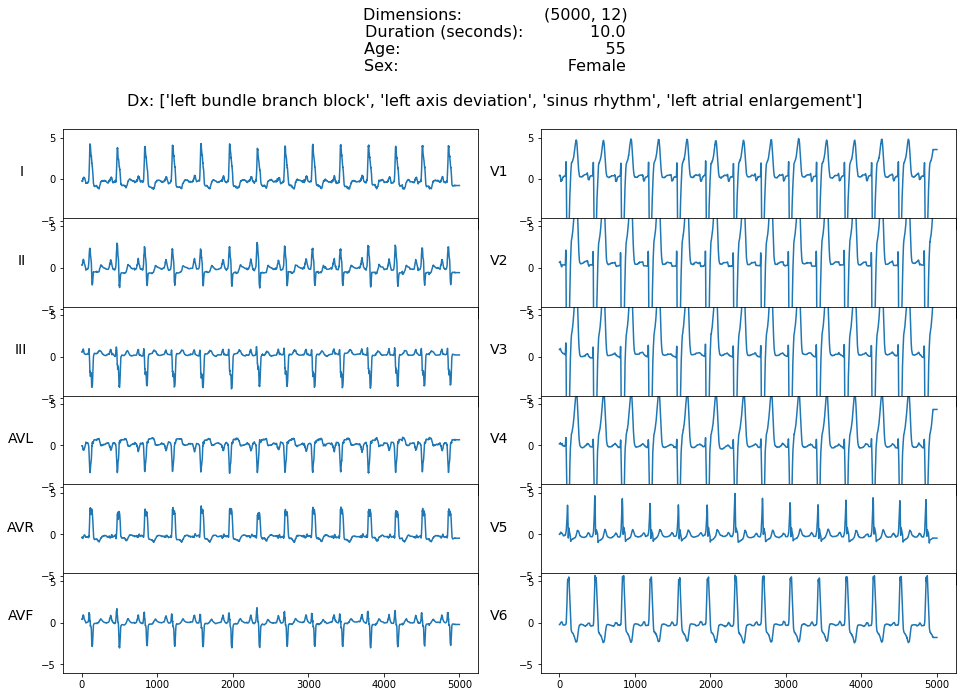

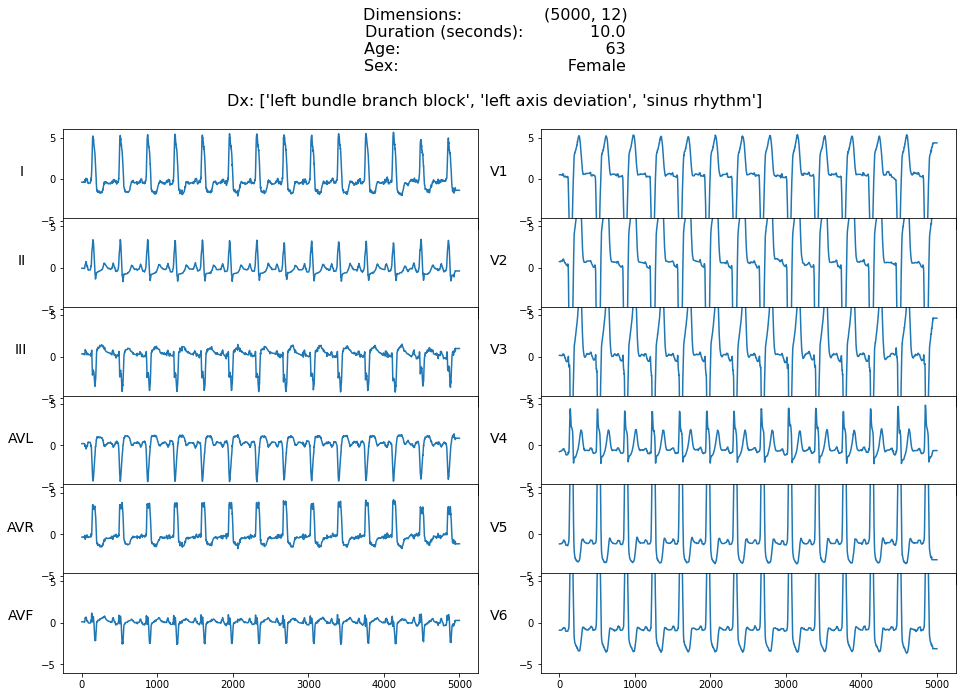

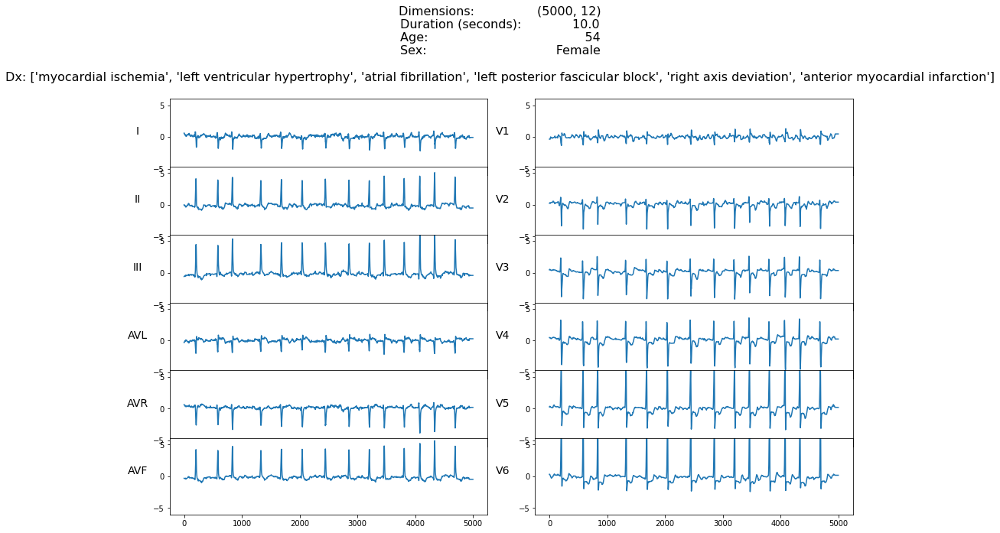

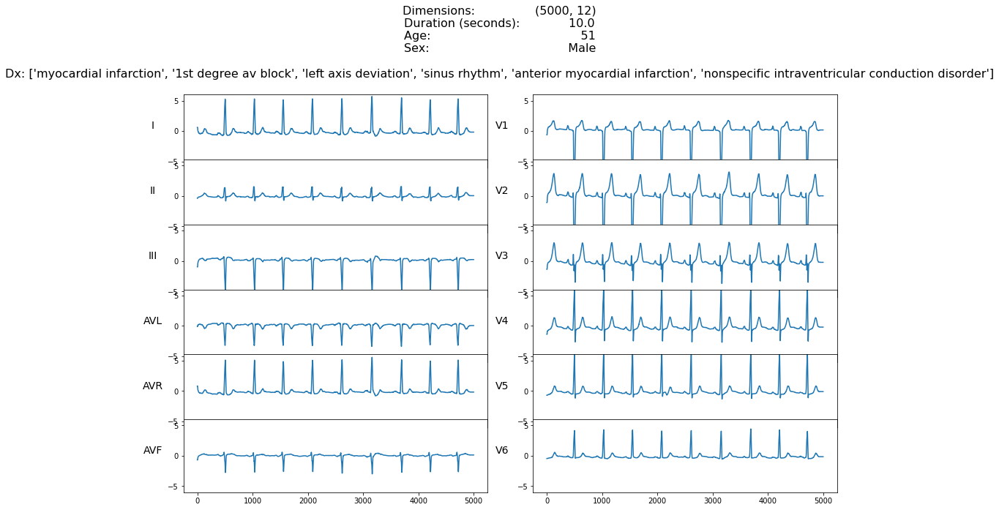

In [21]:
# For each of the codes, select n_sample random examples and plot them.
# Note that there can be intersections and thus repetition of examples.

for code in list(urgency.index)[:2]:    
    
    Y_code = md.sample_Y_by_code(Y_df, code, n_sample=2, random_state=203129)    
    pa.plot_various_given_code(Y_code, code, requirements, n_sample=2, verbose=True, show=True)

We plot some more without showing them and store them.

In [26]:
# for code in urgency.index:    
    
#     Y_code = md.sample_Y_by_code(Y_df, code, n_sample=n_sample, random_state=203129)    
#     pa.plot_various_given_code(Y_code, code, requirements, n_sample=n_sample, verbose=False, show=False)

#### Urgency level 2

We basically repeat everything with Urgency level 2, 3 and 4.

In [27]:
urgency = md.dx_by_urgency(urgency_level=2, requirements=requirements)
urgency

,Diagnostic Description,Abbreviation,PTB-XL,Total,Kind
SNOMED CT Code,,,,,
164917005,qwave abnormal,QAb,548,1013,most
164934002,t wave abnormal,TAb,2345,4673,most
59931005,t wave inversion,TInv,294,1112,most
426434006,anterior ischemia,AnMIs,44,325,less
425419005,inferior ischaemia,IIs,219,670,less
425623009,lateral ischaemia,LIs,142,1045,less
164861001,myocardial ischemia,MIs,2175,2559,less
429622005,st depression,STD,1009,1977,less


In [28]:
# for code in urgency.index:    
    
#     Y_code = md.sample_Y_by_code(Y_df, code, n_sample=n_sample, random_state=203129)    
#     pa.plot_various_given_code(Y_code, code, requirements, n_sample=n_sample, verbose=False, show=False)

#### Urgency level 3

In [29]:
urgency = md.dx_by_urgency(urgency_level=3, requirements=requirements)
urgency

,Diagnostic Description,Abbreviation,PTB-XL,Total,Kind
SNOMED CT Code,,,,,
713427006,complete right bundle branch block,CRBBB,542,683,most
713426002,incomplete right bundle branch block,IRBBB,1118,1611,most
445118002,left anterior fascicular block,LAnFB,1626,1806,most
698252002,nonspecific intraventricular conduction disorder,NSIVCB,789,997,most
164951009,abnormal QRS,abQRS,3389,3389,less
251120003,incomplete left bundle branch block,ILBBB,77,205,less
445211001,left posterior fascicular block,LPFB,177,202,less
164873001,left ventricular hypertrophy,LVH,2359,3759,less
428750005,nonspecific st t abnormality,NSSTTA,381,3554,less


In [30]:
# for code in urgency.index:    
    
#     Y_code = md.sample_Y_by_code(Y_df, code, n_sample=n_sample, random_state=203129)    
#     pa.plot_various_given_code(Y_code, code, requirements, n_sample=n_sample, verbose=False, show=False)

#### Urgency level 4

In [31]:
urgency = md.dx_by_urgency(urgency_level=4, requirements=requirements)
urgency

,Diagnostic Description,Abbreviation,PTB-XL,Total,Kind
SNOMED CT Code,,,,,
270492004,1st degree av block,IAVB,797,2394,most
164889003,atrial fibrillation,AF,1514,3475,most
164890007,atrial flutter,AFL,73,314,most
39732003,left axis deviation,LAD,5146,6086,most
251146004,low qrs voltages,LQRSV,182,556,most
10370003,pacing rhythm,PR,296,299,most
284470004,premature atrial contraction,PAC,398,1729,most
164947007,prolonged pr interval,LPR,340,340,most
111975006,prolonged qt interval,LQT,118,1513,most


In [32]:
# for code in urgency.index:    
    
#     Y_code = md.sample_Y_by_code(Y_df, code, n_sample=n_sample, random_state=203129)    
#     pa.plot_various_given_code(Y_code, code, requirements, n_sample=n_sample, verbose=False, show=False)

### Adding urgency to Y + EDA on DX

There are certain approaches we can take to classify the diagnoses:

    1. Have a multi-binary classification model that checks whether there is precense of the dx.
    2. Have a multi-class classification model that checks the urgency of opoeration for the patient.
    
Note how in a way the former one includes the latter, since having a strong indication of a dx that belongs 
to a certain urgency level would implicitly determine it.

In the latter one, we still have to determine how the combination of urgencies in each patient can change the overall
urgency. For example, suppose a patient has 3 dx with urgency level 2, and 3 with urgency level 3. Would this patient
be classified as an urgency level 2 one because the maximum urgency level is 2, or should it be ascended to 1 since it has multiple dx.

For the moment, we will assume the maximum per dx urgency level as the overall patient's one.

In [23]:
# Get OHE on the urgency of the diagnosis
Y_urgencies = np.array(pd.get_dummies(labels['Urgency']))

# Multiply by the dx in each row to get the total amount of dx per urgency
Y_urgencies = np.array(Y_df.iloc[:, 11:]) @ Y_urgencies

print(Y_urgencies.shape)
Y_urgencies

(21837, 4)


array([[0, 0, 0, 2],
       [0, 0, 0, 2],
       [0, 0, 0, 1],
       ...,
       [0, 1, 0, 1],
       [0, 0, 0, 2],
       [0, 0, 0, 1]], dtype=int64)

The maximum number of dx per patient in PTB-XL is 10


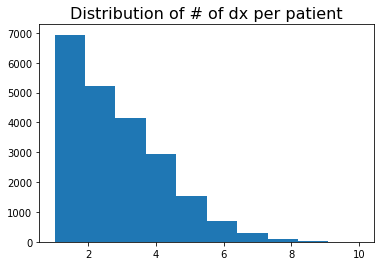

In [24]:
fig, ax = plt.subplots()
ax.hist(Y_urgencies.sum(1))
ax.set_title('Distribution of # of dx per patient', fontsize=16)
print("The maximum number of dx per patient in {} is {}".format(current_db, Y_urgencies.sum(1).max()))

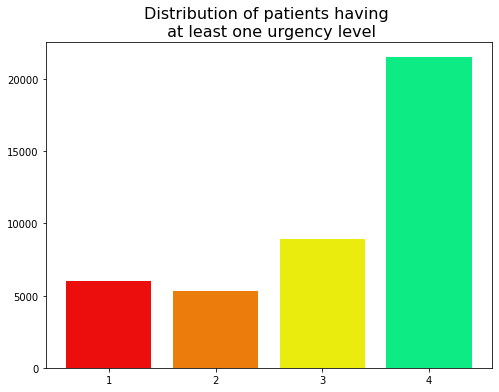

In [25]:
fig, ax = plt.subplots(figsize = (8,6))
ax.bar(['1','2','3','4'], (Y_urgencies > 0).sum(0), color=list(urgency_colors.values()))
ax.set_title('Distribution of patients having \n at least one urgency level', fontsize=16);

As mentioned, the patient's urgency level will be the highest priority urgency level per dx. Thus,
we multiply each of the previous matrix columns (urgencies) by wieghts, so that the maximum per row reflects the maximum urgency.

In [26]:
Y_urgencies_max = Y_urgencies.copy()

Y_urgencies_max[:, 0] = Y_urgencies_max[:, 0] * 1000000
Y_urgencies_max[:, 1] = Y_urgencies_max[:, 1] * 10000
Y_urgencies_max[:, 3] = Y_urgencies_max[:, 3] * 100

Y_urgencies_max = Y_urgencies_max.argmax(1) + 1

Y_urgencies_max

array([4, 4, 4, ..., 2, 4, 4], dtype=int64)

We note that given the maximum value approach, there are too few observations in the urgency level 3, leaving it practically unusable.

Urgency level 3 has 77 registers.


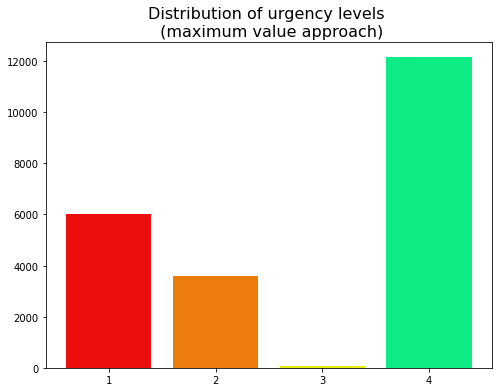

In [26]:
fig, ax = plt.subplots(figsize = (8,6))
ax.bar(['1','2','3','4'], np.histogram(Y_urgencies_max, bins=4)[0], color=list(urgency_colors.values()))
ax.set_title('Distribution of urgency levels \n (maximum value approach)', fontsize=16);
print("Urgency level 3 has", np.histogram(Y_urgencies_max, bins=4)[0][2], "registers.")

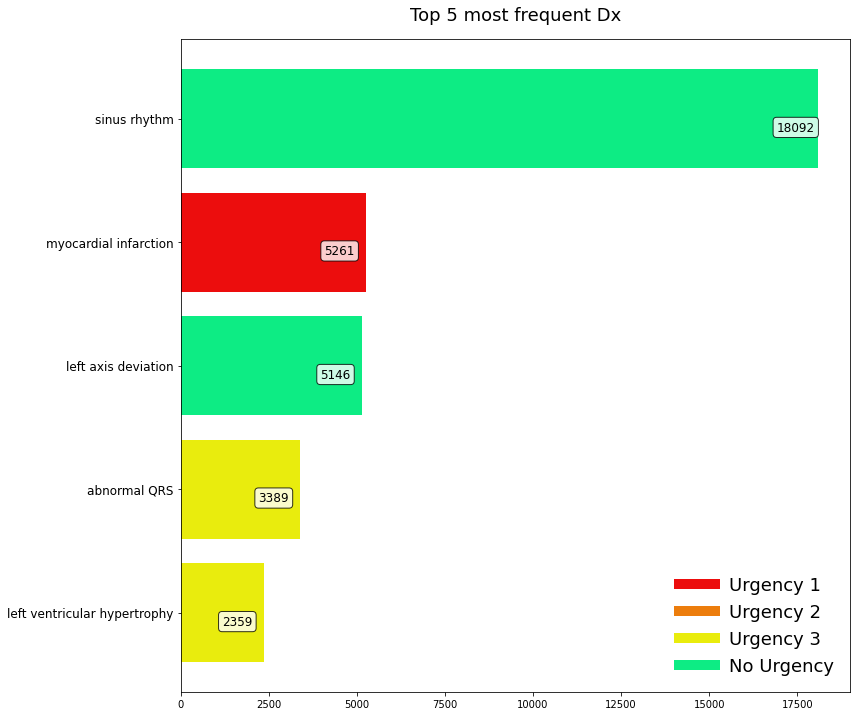

In [27]:
pa.top_n_dx_plot(n=5, Y_df=Y_df.iloc[:,11:], requirements=requirements)

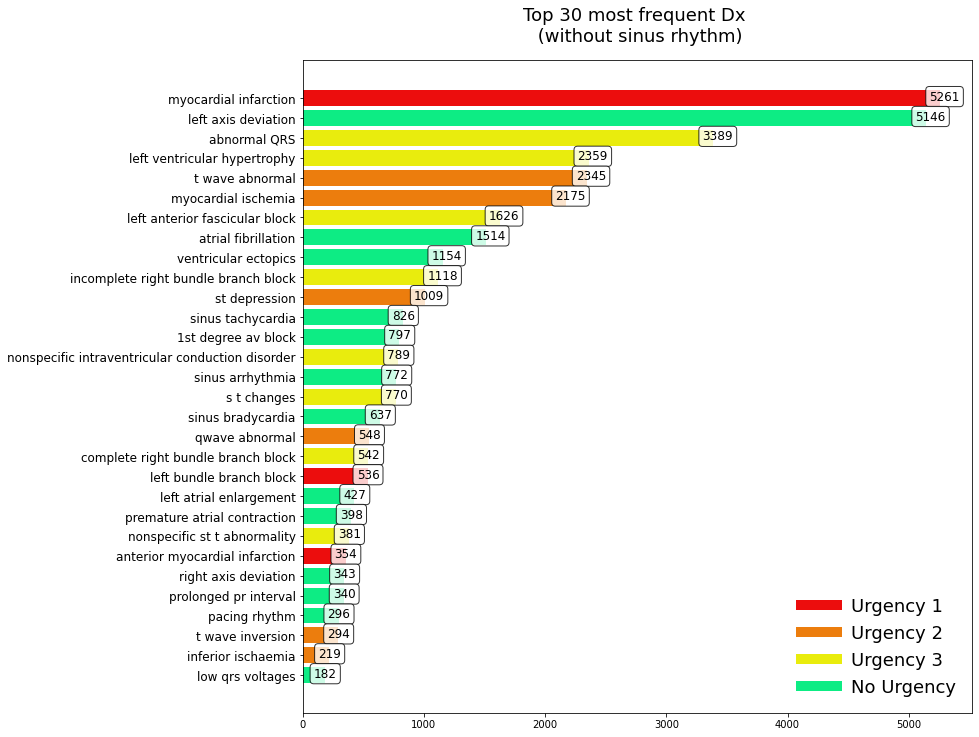

In [28]:
pa.top_n_dx_plot(n=30,Y_df=Y_df.iloc[:,11:], requirements=requirements, m=1, 
                 title="Top 30 most frequent Dx \n (without sinus rhythm)")

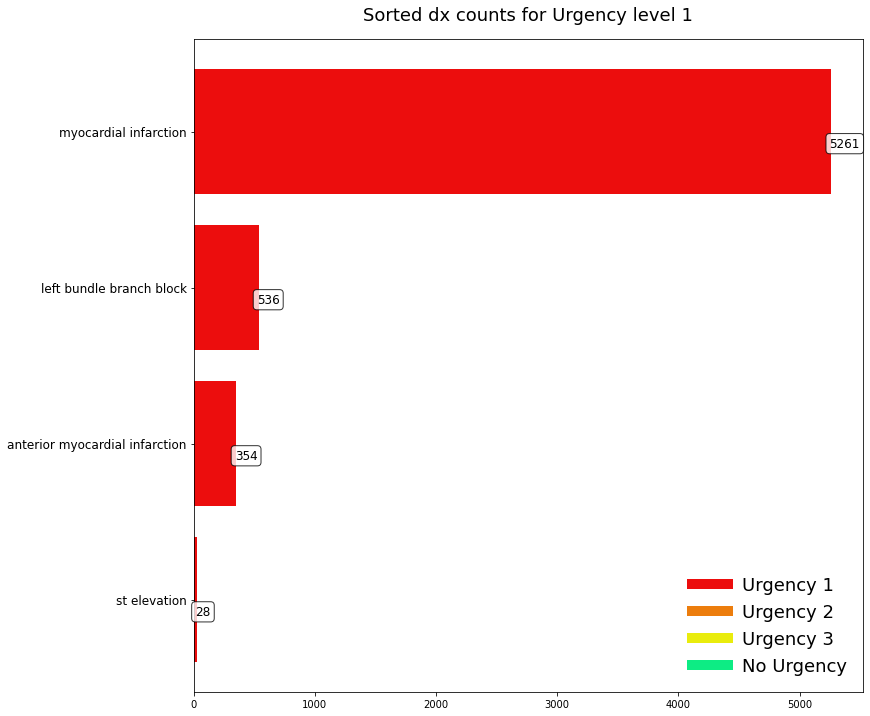

In [29]:
urgency = md.dx_by_urgency(1, requirements)
pa.top_n_dx_plot(n=5,Y_df=Y_df[urgency.index], requirements=requirements,
                title="Sorted dx counts for Urgency level 1")

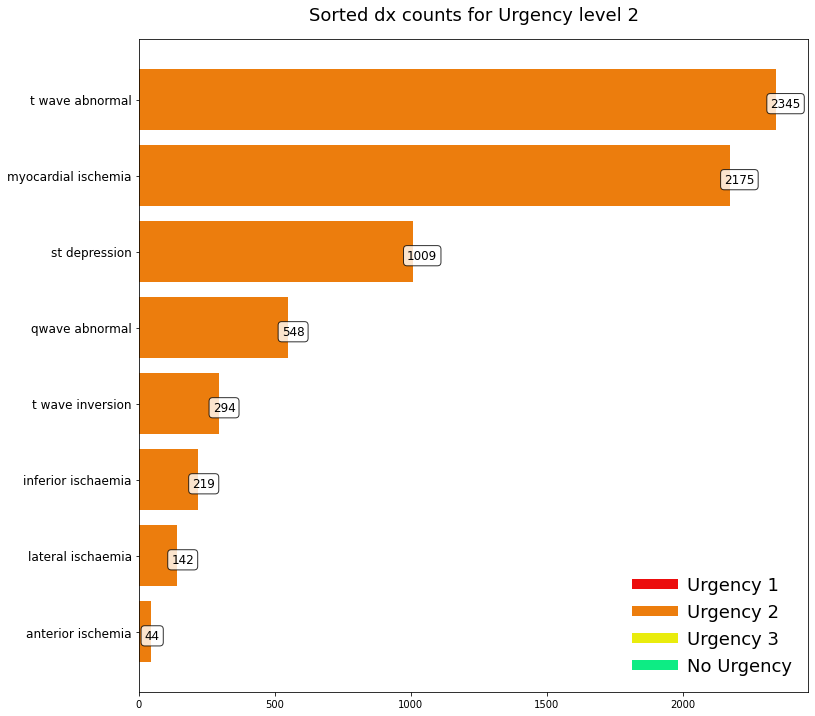

In [30]:
urgency = md.dx_by_urgency(2, requirements)
pa.top_n_dx_plot(n=10,Y_df=Y_df[urgency.index], requirements=requirements,
                title="Sorted dx counts for Urgency level 2")

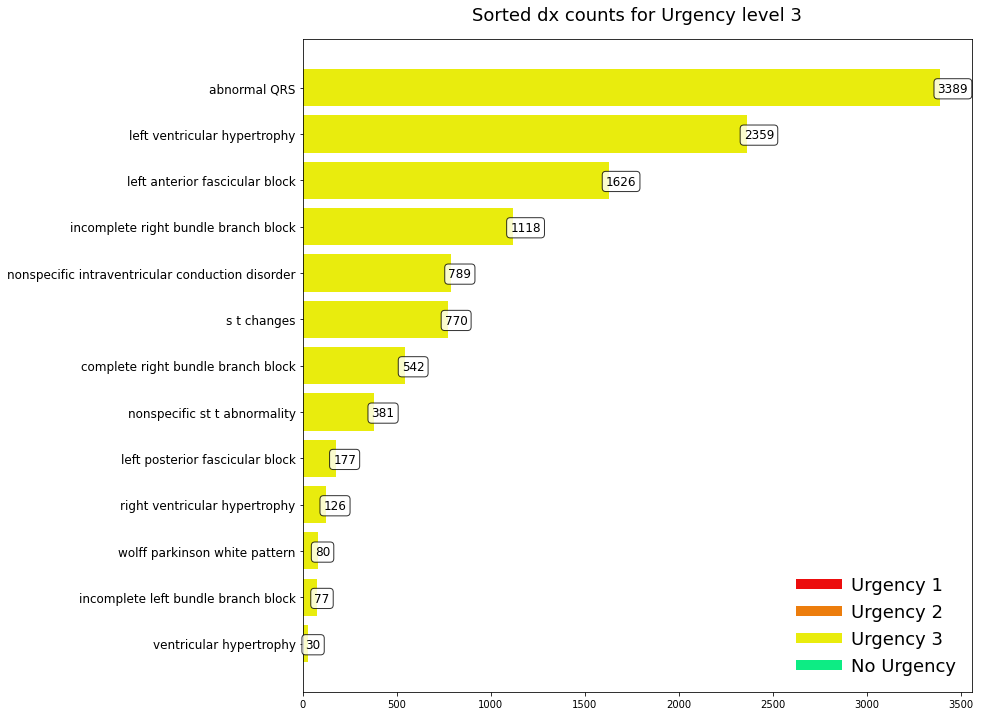

In [31]:
urgency = md.dx_by_urgency(3, requirements)
pa.top_n_dx_plot(n=15,Y_df=Y_df[urgency.index], requirements=requirements,
                title="Sorted dx counts for Urgency level 3")

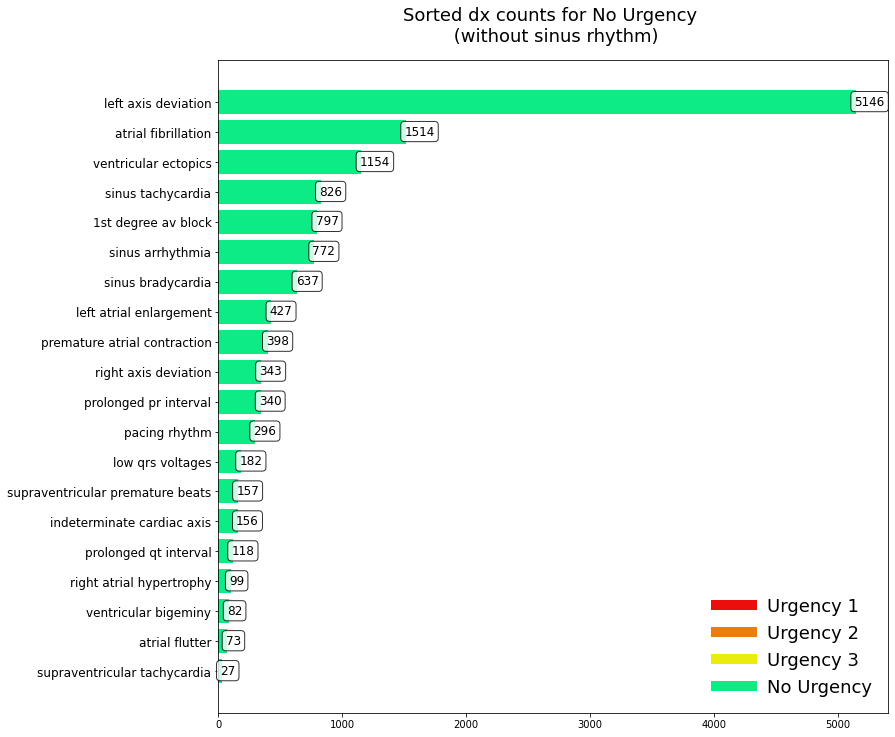

In [32]:
urgency = md.dx_by_urgency(4, requirements)
pa.top_n_dx_plot(n=20,Y_df=Y_df[urgency.index], requirements=requirements, m=1,
                title="Sorted dx counts for No Urgency \n (without sinus rhythm)")

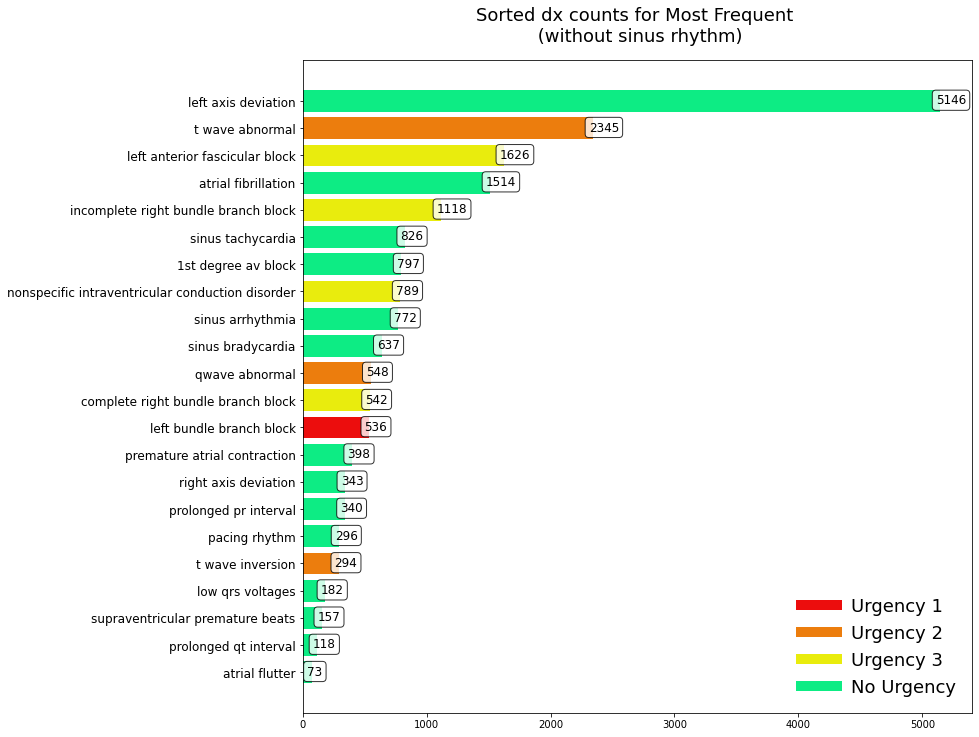

In [33]:
kind = md.dx_by_kind('most', requirements)
pa.top_n_dx_plot(n=30,Y_df=Y_df[kind.index], requirements=requirements, m=1,
                 title="Sorted dx counts for Most Frequent \n (without sinus rhythm)")

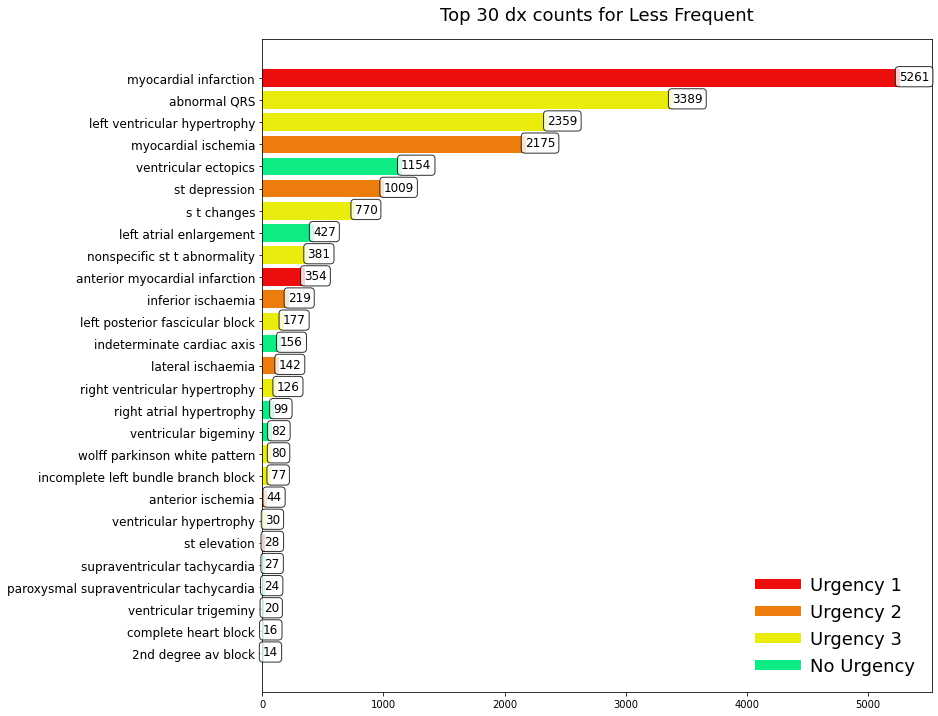

In [34]:
kind = md.dx_by_kind('less', requirements)
pa.top_n_dx_plot(n=30,Y_df=Y_df[kind.index], requirements=requirements,
                 title="Top 30 dx counts for Less Frequent")

## Urgency Level Approach

### Train, Validation & Test

We first reduce the length of the signals since it would be too computationally costly otherwise atm.

In [26]:
# Notice that this way to cut currently works only for PTB-XL, since all records are the of
# the same duration and frequency sampling

cut = 0.3
X_cut = X[:, :int(cut * X.shape[1]), :]

#### Note: For this excercise, we will predict urgency levels (1,2,3,4) in a multi-binary way. That is, for example, if the patient has 2 urgency 1 dx, 1 urgency 2 dx and 3 urgency 4 dx, then y_i = [1, 1, 0, 1].

In [27]:
Y_urgs = Y_urgencies // Y_urgencies

<ipython-input-27-dc3bbaf43b20>:1: RuntimeWarning: divide by zero encountered in floor_divide
  Y_urgs = Y_urgencies // Y_urgencies


Define the proportions for each set.

In [28]:
val_size = 0.2
test_size = 0.2

#### Note: It is still not clear how to stratify since the labels are *not* mutually exclusive. For the moment we don't do it, but this should be later revised

In [29]:
# Train and test
train_set_x, test_set_x = train_test_split(X_cut, test_size=test_size, random_state=random_state)
train_set_y, test_set_y = train_test_split(Y_urgs, test_size=test_size, random_state=random_state)

# Train and val
train_set_x, val_set_x = train_test_split(train_set_x, test_size=val_size, random_state=random_state)
train_set_y, val_set_y = train_test_split(train_set_y, test_size=val_size, random_state=random_state)

n_total_train = train_set_x.shape[0]
batches = n_total_train//batch_size

# train_set_y = np.array(train_set_y)
# val_set_y = np.array(val_set_y)
# test_set_y = np.array(test_set_y)

In [30]:
print(train_set_y.shape)
print(val_set_y.shape)
print(test_set_y.shape)

(13975, 4)
(3494, 4)
(4368, 4)


### CNN Implementation

#### Basic Initial Model

In [31]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256

optimizer = 'adam'

In [38]:
CNN = Sequential([
    InputLayer(input_shape=(img_h, img_w)),
    
    Conv1D(64, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    Conv1D(128, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    Conv1D(256, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    #Conv1D(64, 3, activation='relu'),
    #MaxPool2D(),

    Flatten(),
    Dense(128, activation='relu'),
    Dense(4, activation='sigmoid')
])

CNN.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_6 (Conv1D)           (None, 1500, 64)          2368      
                                                                 
 max_pooling1d_6 (MaxPooling  (None, 750, 64)          0         
 1D)                                                             
                                                                 
 conv1d_7 (Conv1D)           (None, 750, 128)          24704     
                                                                 
 max_pooling1d_7 (MaxPooling  (None, 375, 128)         0         
 1D)                                                             
                                                                 
 conv1d_8 (Conv1D)           (None, 375, 256)          98560     
                                                                 
 max_pooling1d_8 (MaxPooling  (None, 187, 256)        

In [39]:
# Compile: Define training parameters
CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Train model
epochs = 50
batches = n_total_train//batch_size

### Following line overflows memory
fitted_model = CNN.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                       epochs=epochs, validation_data=(val_set_x, val_set_y),
                       callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])

Epoch 1/50
873/873 [==============================] - 18s 18ms/step - loss: 0.4090 - accuracy: 0.4146 - val_loss: 0.3559 - val_accuracy: 0.4176
Epoch 2/50
873/873 [==============================] - 27s 31ms/step - loss: 0.3390 - accuracy: 0.4183 - val_loss: 0.3821 - val_accuracy: 0.4181
Epoch 3/50
873/873 [==============================] - 2083s 2s/step - loss: 0.2940 - accuracy: 0.4278 - val_loss: 0.3723 - val_accuracy: 0.4316
Epoch 4/50
873/873 [==============================] - 79s 91ms/step - loss: 0.2357 - accuracy: 0.4490 - val_loss: 0.4660 - val_accuracy: 0.4373
Epoch 5/50
873/873 [==============================] - 13s 15ms/step - loss: 0.1572 - accuracy: 0.4614 - val_loss: 0.6307 - val_accuracy: 0.4385
Epoch 6/50
873/873 [==============================] - 10s 12ms/step - loss: 0.1003 - accuracy: 0.4635 - val_loss: 0.7243 - val_accuracy: 0.4342
Epoch 7/50
873/873 [==============================] - 10s 12ms/step - loss: 0.0552 - accuracy: 0.4739 - val_loss: 0.9623 - val_accuracy:

KeyboardInterrupt: 

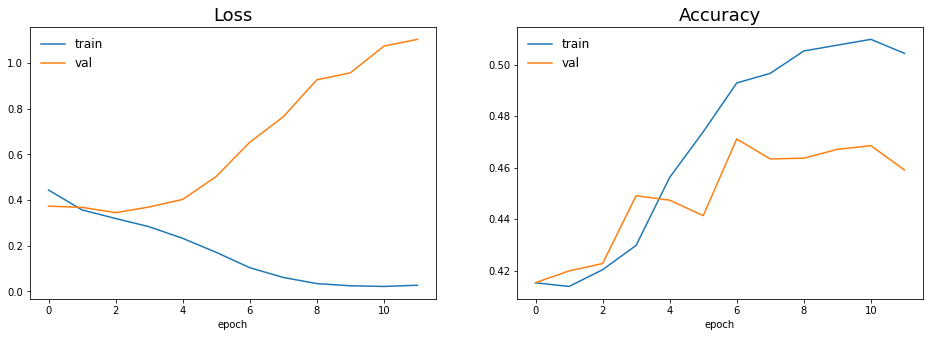

In [33]:
pa.plot_model_history(fitted_model)

#### Adding ...

In [36]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]

optimizer = 'adam'

In [37]:
CNN = Sequential([
    InputLayer(input_shape=(img_h, img_w)),
    
    Conv1D(128, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),

    Conv1D(256, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),

    Conv1D(d_model, 10, activation='relu', strides=2, padding="same"),
    MaxPool1D(),

    #Conv1D(64, 3, activation='relu'),
    #MaxPool2D(),

    Flatten(),
    Dense(d_model, activation='relu'),
    Dense(4, activation='sigmoid')
])

CNN.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 conv1d_4 (Conv1D)           (None, 84, 256)           459008    
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 42, 256)          0         
 1D)                                                             
                                                                 
 conv1d_5 (Conv1D)           (None, 21, 256)           655616    
                                                                 
 max_pooling1d_5 (MaxPooling  (None, 10, 256)         

In [38]:
# Compile: Define training parameters
CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Train model
epochs = 50
batches = n_total_train//batch_size

### Following line overflows memory
fitted_model = CNN.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                       epochs=epochs, validation_data=(val_set_x, val_set_y),
                       callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])

Epoch 1/50
218/218 [==============================] - 8s 32ms/step - loss: 0.3996 - accuracy: 0.4120 - val_loss: 0.3388 - val_accuracy: 0.4153
Epoch 2/50
218/218 [==============================] - 6s 30ms/step - loss: 0.3321 - accuracy: 0.4170 - val_loss: 0.3237 - val_accuracy: 0.4156
Epoch 3/50
218/218 [==============================] - 6s 29ms/step - loss: 0.3075 - accuracy: 0.4223 - val_loss: 0.3223 - val_accuracy: 0.4305
Epoch 4/50
218/218 [==============================] - 6s 29ms/step - loss: 0.2843 - accuracy: 0.4526 - val_loss: 0.3270 - val_accuracy: 0.4450
Epoch 5/50
218/218 [==============================] - 7s 31ms/step - loss: 0.2557 - accuracy: 0.4617 - val_loss: 0.3711 - val_accuracy: 0.4511
Epoch 6/50
218/218 [==============================] - 7s 30ms/step - loss: 0.2174 - accuracy: 0.4824 - val_loss: 0.4229 - val_accuracy: 0.4702
Epoch 7/50
218/218 [==============================] - 7s 31ms/step - loss: 0.1734 - accuracy: 0.4891 - val_loss: 0.4855 - val_accuracy: 0.4782

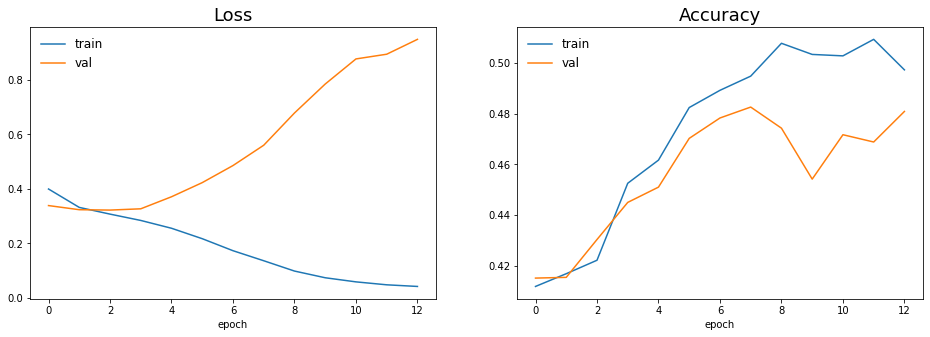

In [39]:
pa.plot_model_history(fitted_model)

## SNOMED CT Code Approach

### Train, Validation & Test

We first reduce the length of the signals since it would be too computationally costly otherwise atm.

In [43]:
# Notice that this way to cut currently works only for PTB-XL, since all records are the of
# the same duration and frequency sampling

cut = 0.3
X_cut = X[:, :int(cut * X.shape[1]), :]

We define a set of target SNOMED CT Codes that we want to predict. In particular we choose those with Urgency Level 1, 2 or 3, as well as registers that the current db (PTB-XL) actually contains.

In [44]:
target_snomed = set(labels[labels['Urgency'] < 4].index)
target_snomed = target_snomed.intersection(set(labels[labels[current_db] > 0].index))

Define the proportions for each set.

In [45]:
val_size = 0.2
test_size = 0.2

#### Note: It is still not clear how to stratify since the labels are *not* mutually exclusive. For the moment we don't do it, but this should be later revised. There could be some ideas we can take from the submitted codes for each team in the Physionet Challenge. I believe some of them had already some recommended folds for each dataset.

In [46]:
# Train and test
train_set_x, test_set_x = train_test_split(X_cut, test_size=test_size, random_state=random_state)
train_set_y, test_set_y = train_test_split(Y_df[target_snomed], test_size=test_size, random_state=random_state)

# Train and val
train_set_x, val_set_x = train_test_split(train_set_x, test_size=val_size, random_state=random_state)
train_set_y, val_set_y = train_test_split(train_set_y, test_size=val_size, random_state=random_state)

n_total_train = train_set_x.shape[0]

train_set_y = np.array(train_set_y)
val_set_y = np.array(val_set_y)
test_set_y = np.array(test_set_y)

In [47]:
print(train_set_y.shape)
print(val_set_y.shape)
print(test_set_y.shape)

(13975, 25)
(3494, 25)
(4368, 25)


### CNN Implementation

#### Basic Initial Model

In [61]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]

optimizer = 'adam'

In [67]:
CNN = Sequential([
    InputLayer(input_shape=(img_h, img_w)),
    
    Conv1D(64, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    Conv1D(128, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    Conv1D(256, 3, activation='relu', strides=1, padding="same"),
    MaxPool1D(),

    #Conv1D(64, 3, activation='relu'),
    #MaxPool2D(),

    Flatten(),
    Dense(128, activation='relu'),
    Dense(train_set_y.shape[1], activation='sigmoid')
])

CNN.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_27 (Conv1D)          (None, 1500, 64)          2368      
                                                                 
 max_pooling1d_27 (MaxPoolin  (None, 750, 64)          0         
 g1D)                                                            
                                                                 
 conv1d_28 (Conv1D)          (None, 750, 128)          24704     
                                                                 
 max_pooling1d_28 (MaxPoolin  (None, 375, 128)         0         
 g1D)                                                            
                                                                 
 conv1d_29 (Conv1D)          (None, 375, 256)          98560     
                                                                 
 max_pooling1d_29 (MaxPoolin  (None, 187, 256)        

In [69]:
# Compile: Define training parameters
# CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['categorical_accuracy'])

# Train model
epochs = 50
batches = n_total_train//batch_size

### Following line overflows memory
fitted_model = CNN.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                       epochs=epochs, validation_data=(val_set_x, val_set_y),                        
                       callbacks=[EarlyStopping(monitor='val_categorical_accuracy', patience=5)])

InternalError: Failed copying input tensor from /job:localhost/replica:0/task:0/device:CPU:0 to /job:localhost/replica:0/task:0/device:GPU:0 in order to run _EagerConst: Dst tensor is not initialized.

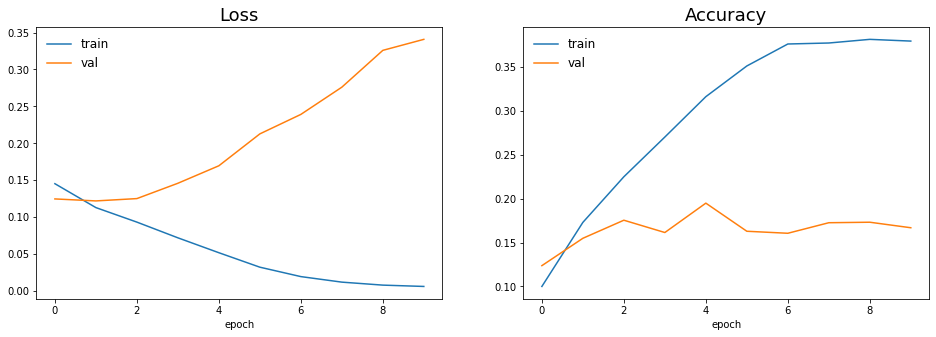

In [217]:
pa.plot_model_history(fitted_model)

#### Adding...

In [307]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256

optimizer = 'adam'

In [60]:
CNN = Sequential([
    InputLayer(input_shape=(img_h, img_w)),
    
    Conv1D(128, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),

    Conv1D(256, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),

    Conv1D(d_model, 10, activation='relu', strides=2, padding="same"),
    MaxPool1D(),

    #Conv1D(64, 3, activation='relu'),
    #MaxPool2D(),

    Flatten(),
    Dense(d_model, activation='relu'),
    Dense(len(target_snomed), activation='sigmoid')
])

CNN.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_21 (Conv1D)          (None, 500, 128)          21632     
                                                                 
 max_pooling1d_21 (MaxPoolin  (None, 250, 128)         0         
 g1D)                                                            
                                                                 
 conv1d_22 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_22 (MaxPoolin  (None, 42, 256)          0         
 g1D)                                                            
                                                                 
 conv1d_23 (Conv1D)          (None, 21, 256)           655616    
                                                                 
 max_pooling1d_23 (MaxPoolin  (None, 10, 256)         

In [314]:
# Compile: Define training parameters
# CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
CNN.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Train model
epochs = 50
batches = n_total_train//batch_size

### Following line overflows memory
fitted_model = CNN.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                       epochs=epochs, validation_data=(val_set_x, val_set_y),
                       callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])

Epoch 1/50
218/218 [==============================] - 35s 157ms/step - loss: 0.1462 - accuracy: 0.0920 - val_loss: 0.1224 - val_accuracy: 0.1291
Epoch 2/50
218/218 [==============================] - 37s 168ms/step - loss: 0.1097 - accuracy: 0.1960 - val_loss: 0.1112 - val_accuracy: 0.1737
Epoch 3/50
218/218 [==============================] - 40s 181ms/step - loss: 0.0980 - accuracy: 0.2190 - val_loss: 0.1049 - val_accuracy: 0.1820
Epoch 4/50
218/218 [==============================] - 40s 184ms/step - loss: 0.0881 - accuracy: 0.2365 - val_loss: 0.1023 - val_accuracy: 0.1915
Epoch 5/50
218/218 [==============================] - 40s 182ms/step - loss: 0.0792 - accuracy: 0.2475 - val_loss: 0.1143 - val_accuracy: 0.1697
Epoch 6/50
218/218 [==============================] - 40s 183ms/step - loss: 0.0683 - accuracy: 0.2742 - val_loss: 0.1191 - val_accuracy: 0.1938
Epoch 7/50
218/218 [==============================] - 41s 188ms/step - loss: 0.0546 - accuracy: 0.3032 - val_loss: 0.1355 - val_ac

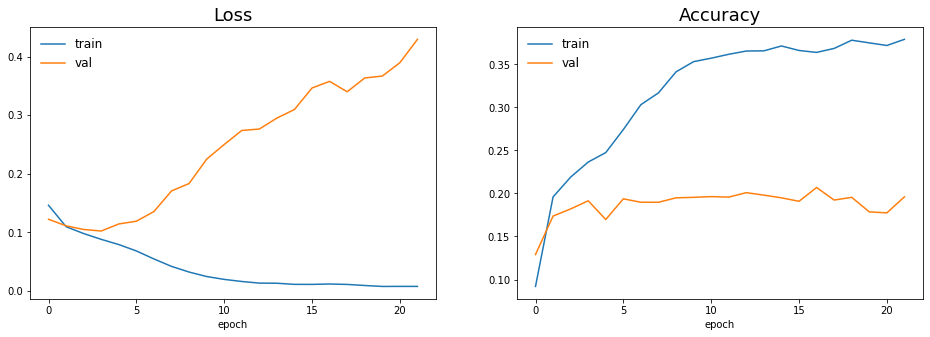

In [315]:
pa.plot_model_history(fitted_model)

# Earlier unused stuff

### Check Signals from different sources

This section was earlier used to compare from different sources. Since we have already done the analysis, they need not be run. Even they might not work given the pathing changes.

The most valuable lesson from this section was to understand the **mV** in the registers. It is a measure on the height of the signals. We need to eventualy convert all to have the same mV to make them comparable.

File 1
 [[-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 [-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 [-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 ...
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]]

File 2
 [[-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 ...
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]]

File 1

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  56
Patient's sex:  Female
Patient's diagnosis:  ['low qrs voltages', 'sinus rhythm']

File 2

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  56
Patient's sex:  Female
Patient's diagnosis:  ['low qrs voltages', 'sinus rhythm']


We can see that the c

C:\Users\Mike\Documents\maestria-itam\estancia-investigacion\proyecto-ecg\pruebas\scripts\plots_aux.py:242: RuntimeWarning: invalid value encountered in true_divide
  print('\nWe can see that the constant is 0.2 (or 5, depending on the order): (Unique values of the divisions)',


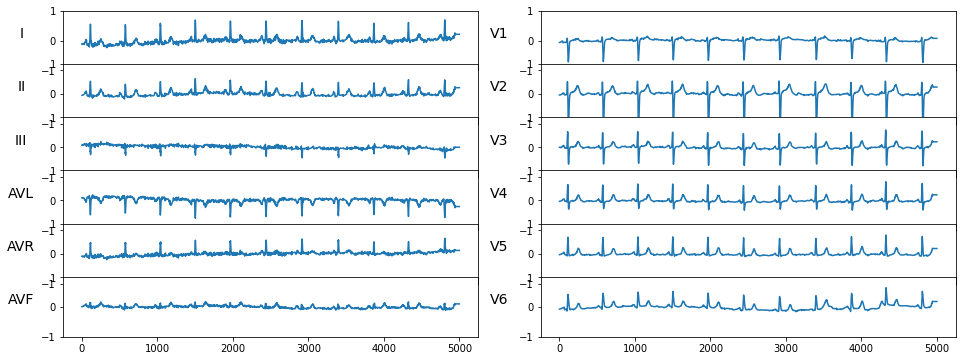

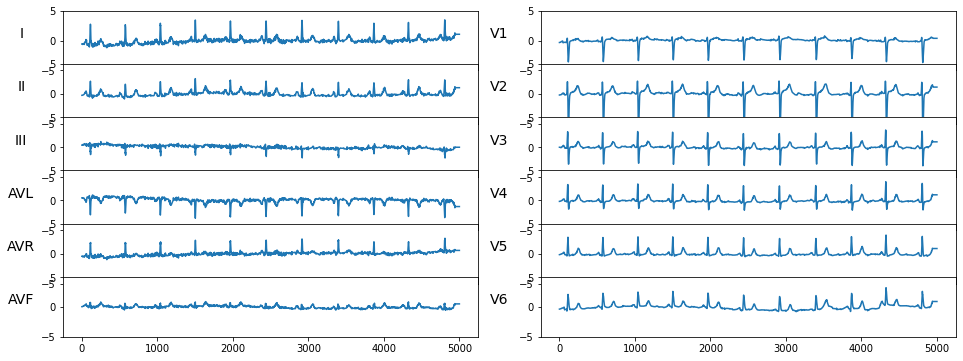

In [102]:
# # Choose a file
# filename = 'HR00001'

# # Compare Physionet (https://physionet.org/content/challenge-2020/1.0.2/)
# #      vs Kaggle (https://www.kaggle.com/code/bjoernjostein/physionet-challenge-2020/data?select=WFDB)
# pa.compare_2_ecgs(filename_1 = f'../data/{filename}', filename_2 = path+filename, 
#                   requirements = requirements, ylim_1 = (-1,1))

File 1
 [[-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 [-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 [-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 ...
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]]

File 2
 [[-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 [-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 [-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 ...
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]]

File 1

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  62
Patient's sex:  Male
Patient's diagnosis:  ['myocardial infarction', 'abnormal QRS', 'left axis deviation', 'sinus rhythm', 'left atrial enlargement', 'nonspecific intraventricular conduction disorder']

File 2

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Pat

C:\Users\Mike\Documents\maestria-itam\estancia-investigacion\proyecto-ecg\pruebas\scripts\plots_aux.py:242: RuntimeWarning: invalid value encountered in true_divide
  print('\nWe can see that the constant is 0.2 (or 5, depending on the order): (Unique values of the divisions)',


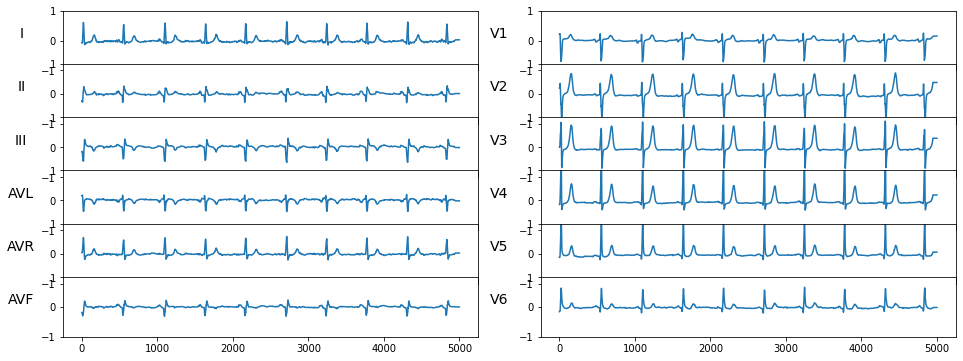

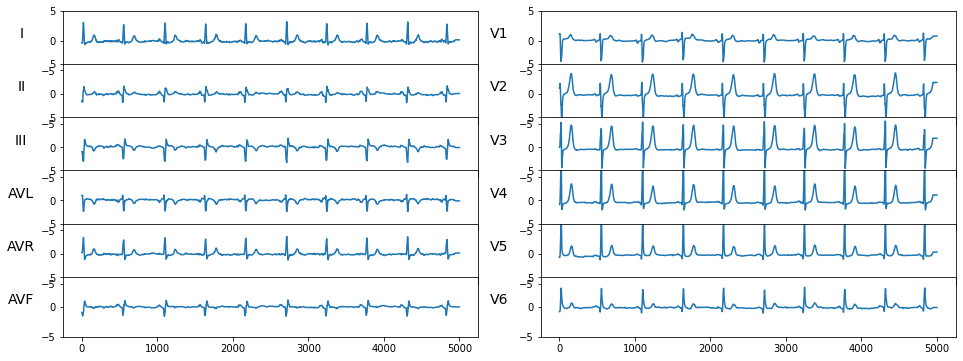

In [103]:
# # Choose a file
# filename = 'HR18052'

# # Compare Physionet (https://physionet.org/content/challenge-2020/1.0.2/)
# #      vs Kaggle (https://www.kaggle.com/code/bjoernjostein/physionet-challenge-2020/data?select=WFDB)
# pa.compare_2_ecgs(filename_1 = f'../data/{filename}', filename_2 = path+filename, 
#                   requirements = requirements, ylim_1 = (-1,1))

File 1
 [[-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 [-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 [-0.115 -0.05   0.065 ... -0.035 -0.035 -0.075]
 ...
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]
 [ 0.21   0.205 -0.005 ...  0.185  0.17   0.18 ]]

File 2
 [[-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 [-0.575 -0.25   0.325 ... -0.175 -0.175 -0.375]
 ...
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]
 [ 1.05   1.025 -0.025 ...  0.925  0.85   0.9  ]]

File 1

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  No Age
Patient's sex:  No Sex
Patient's diagnosis:  No Diagnoses

File 2

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  56
Patient's sex:  Female
Patient's diagnosis:  ['low qrs voltages', 'sinus rhythm']


We can see that the constant is 0.2 (or 5

C:\Users\Mike\Documents\maestria-itam\estancia-investigacion\proyecto-ecg\pruebas\scripts\plots_aux.py:266: RuntimeWarning: invalid value encountered in true_divide


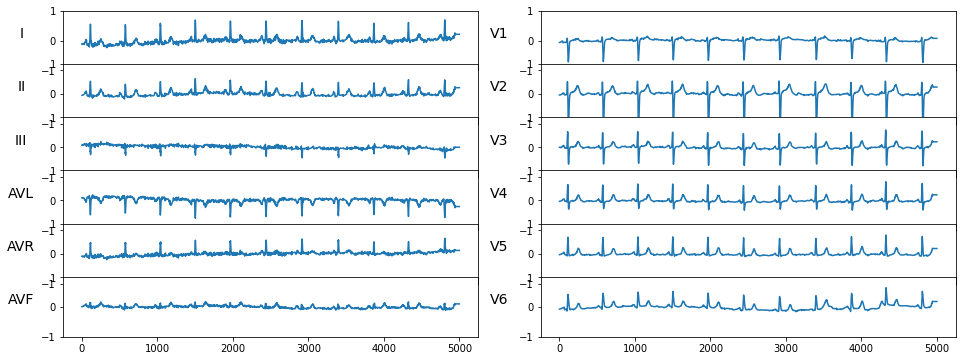

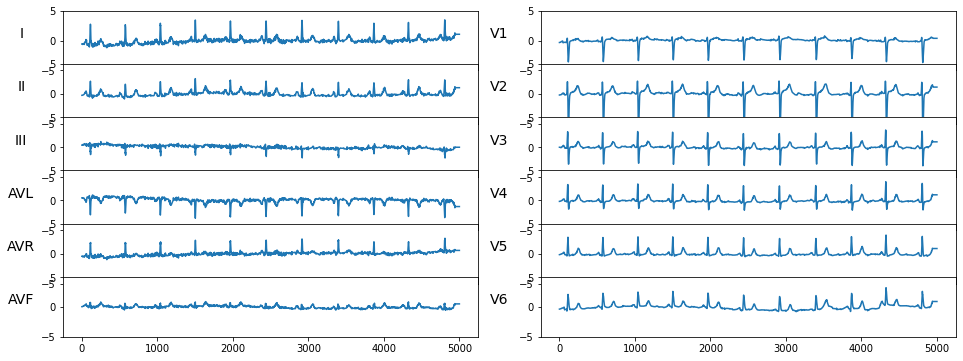

In [106]:
# # Choose a file
# filename_ptbxl = '00001_hr'
# filename = 'HR00001'

# # Compare PTB-XL Original (https://physionet.org/content/ptb-xl/1.0.0/)
# #      vs Kaggle (https://www.kaggle.com/code/bjoernjostein/physionet-challenge-2020/data?select=WFDB)
# pa.compare_2_ecgs(filename_1 = '../data/ptb-xl-a-large-publicly-available-electrocardiography-dataset-1.0.1/' + \
#                   f'records500/00000/{filename_ptbxl}', filename_2 = path+filename, 
#                   requirements = requirements, ylim_1 = (-1,1))

File 1
 [[-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 [-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 [-0.08  -0.23  -0.15  ... -0.135 -0.125 -0.16 ]
 ...
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]
 [ 0.025  0.01  -0.015 ...  0.18   0.05  -0.02 ]]

File 2
 [[-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 [-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 [-0.4   -1.15  -0.75  ... -0.675 -0.625 -0.8  ]
 ...
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]
 [ 0.125  0.05  -0.075 ...  0.9    0.25  -0.1  ]]

File 1

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  No Age
Patient's sex:  No Sex
Patient's diagnosis:  No Diagnoses

File 2

The dimensions of this ECG are:  (5000, 12)
Duration (seconds):  10.0
Patient's age:  62
Patient's sex:  Male
Patient's diagnosis:  ['myocardial infarction', 'abnormal QRS', 'left axis deviation', 'sinus rhythm', '

C:\Users\Mike\Documents\maestria-itam\estancia-investigacion\proyecto-ecg\pruebas\scripts\plots_aux.py:266: RuntimeWarning: invalid value encountered in true_divide
  frac = example_1[0]/example_2[0]


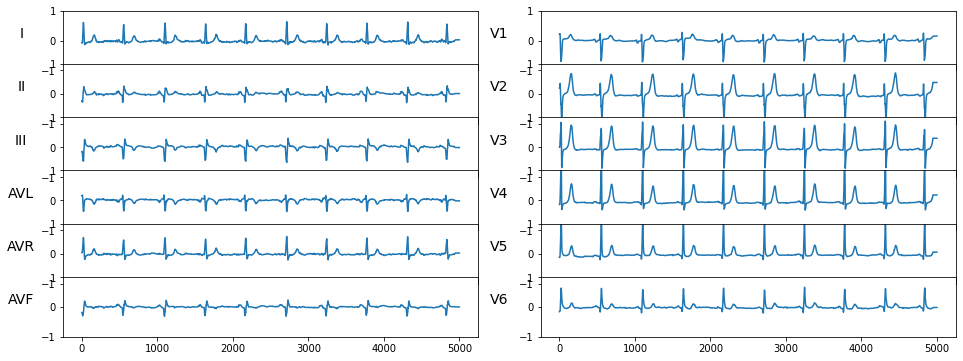

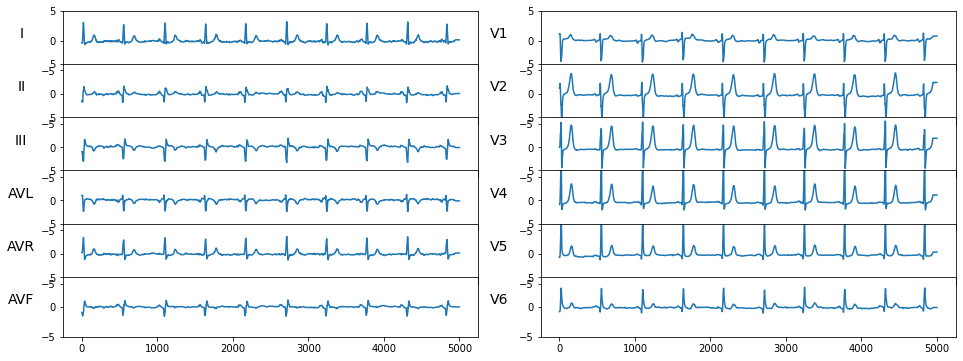

In [110]:
# # Choose a file
# filename_ptbxl = '18052_hr'
# filename = 'HR18052'

# # Compare PTB-XL Original (https://physionet.org/content/ptb-xl/1.0.0/)
# #      vs Kaggle (https://www.kaggle.com/code/bjoernjostein/physionet-challenge-2020/data?select=WFDB)
# pa.compare_2_ecgs(filename_1 = '../data/ptb-xl-a-large-publicly-available-electrocardiography-dataset-1.0.1/' + \
#                   f'records500/18000/{filename_ptbxl}', filename_2 = path+filename, 
#                   requirements = requirements, ylim_1 = (-1,1))

For a sanity check, we want to see how small is the sum of the squared differences between the files we first had (PTB-XL) and the ones downloaded from Kaggle once applied the scaling factor. We do this just for the first 100 values.

In [127]:
# X_PTB = []

# for i in range(99):
#     if i < 9:
#         X_PTB.append(wfdb.rdsamp('../data/ptb-xl-a-large-publicly-available-electrocardiography-dataset-1.0.1/' + \
#                               f'records500/00000/0000{i+1}_hr')[0])
#     else:
#         X_PTB.append(wfdb.rdsamp('../data/ptb-xl-a-large-publicly-available-electrocardiography-dataset-1.0.1/' + \
#                               f'records500/00000/000{i+1}_hr')[0])

# # The sum of the squared differences is virtually 0        
# diff = X_PTB - X[:99]*0.2
# print('The difference is practically 0:', (diff**2).sum())

The difference is practically 0: 4.085840097520608e-10


# Identifying Outliers

In [23]:
# min_X = torch.min(torch.min(torch.from_numpy(X), 1).values, 1).values.numpy()
# max_X = torch.max(torch.max(torch.from_numpy(X), 1).values, 1).values.numpy()

### Earlier slower way with np
min_X = X.min(1).min(1)
max_X = X.max(1).max(1)

In [24]:
lower_limit = np.quantile(min_X, 0.01)
upper_limit = np.quantile(max_X, 0.99)

In [25]:
lower_limit

-24.84375

In [26]:
upper_limit

24.967499999999973

In [27]:
X[(min_X > lower_limit) & (max_X < upper_limit)].shape

(21468, 5000, 12)

In [28]:
X.shape

(21837, 5000, 12)

In [29]:
outliers = pd.DataFrame({'outlier': (min_X < lower_limit) | (max_X > upper_limit)})
outliers = outliers[outliers['outlier']]

In [30]:
random.seed(random_state)
some_outliers = random.sample(list(outliers.index), 20)

In [31]:
path = f'data/{current_db}/'

The min value of this ECG is -12.725 and the max value is 27.625


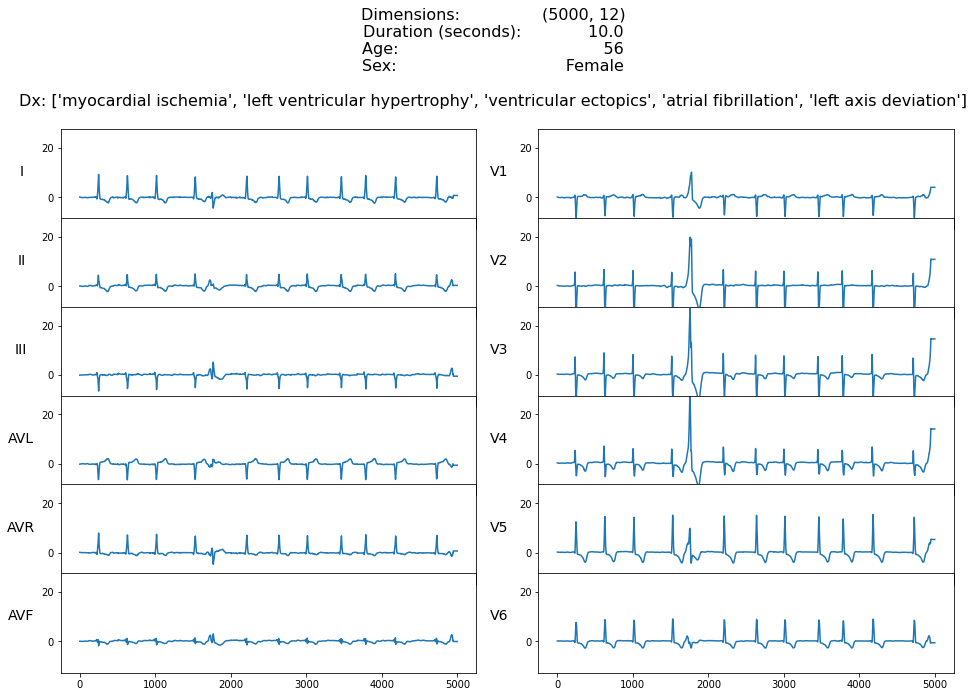

In [225]:
k = 0
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -43.21 and the max value is 13.005


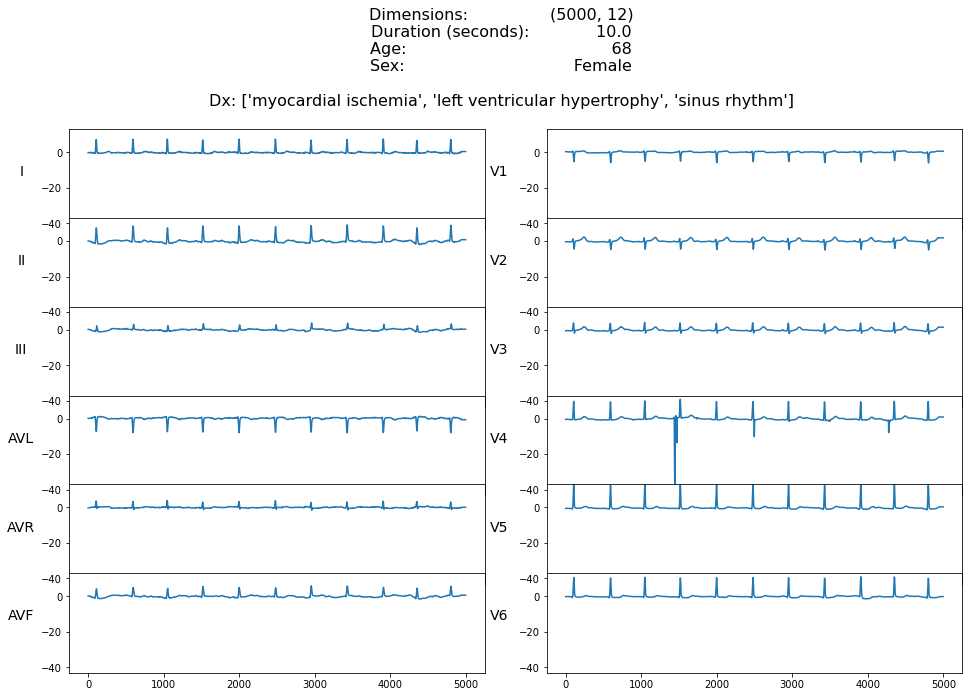

In [142]:
k = 1
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -28.29 and the max value is 19.73


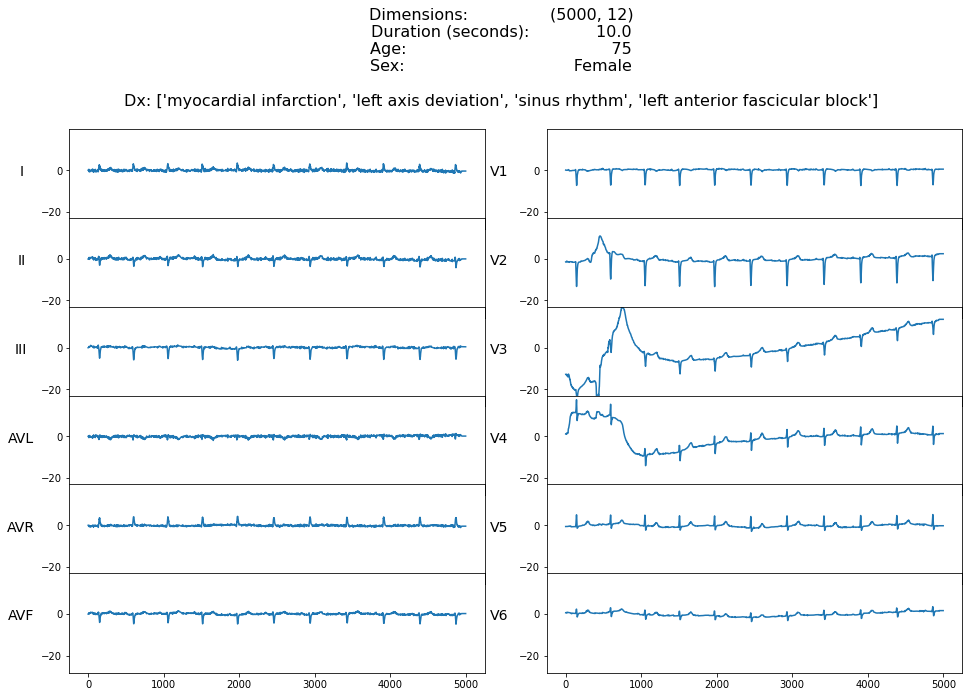

In [144]:
k = 3
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -20.485 and the max value is 27.11


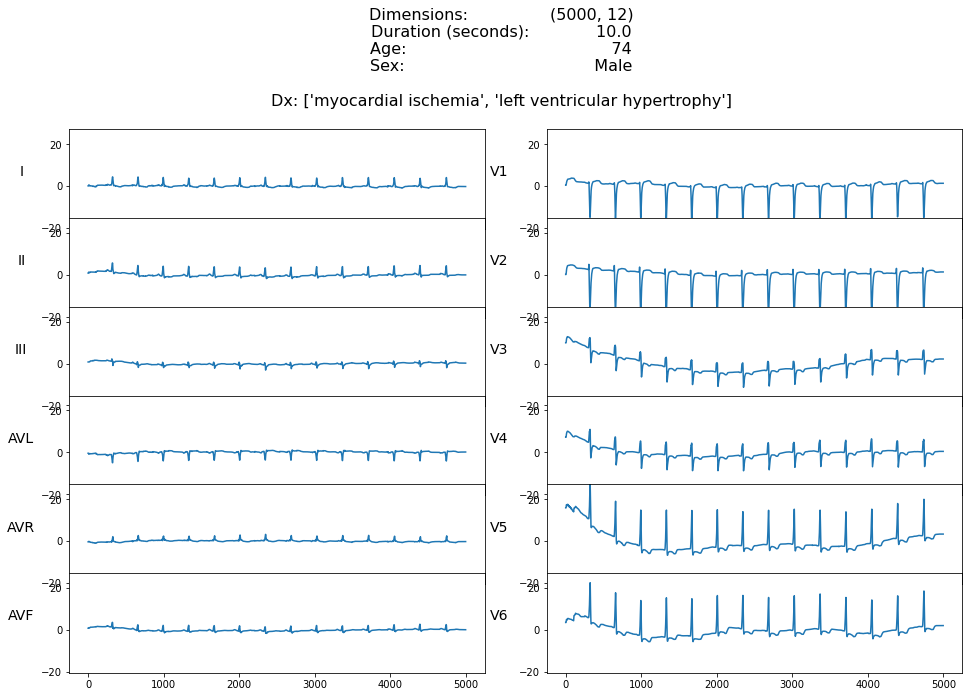

In [145]:
k = 4
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -18.14 and the max value is 35.055


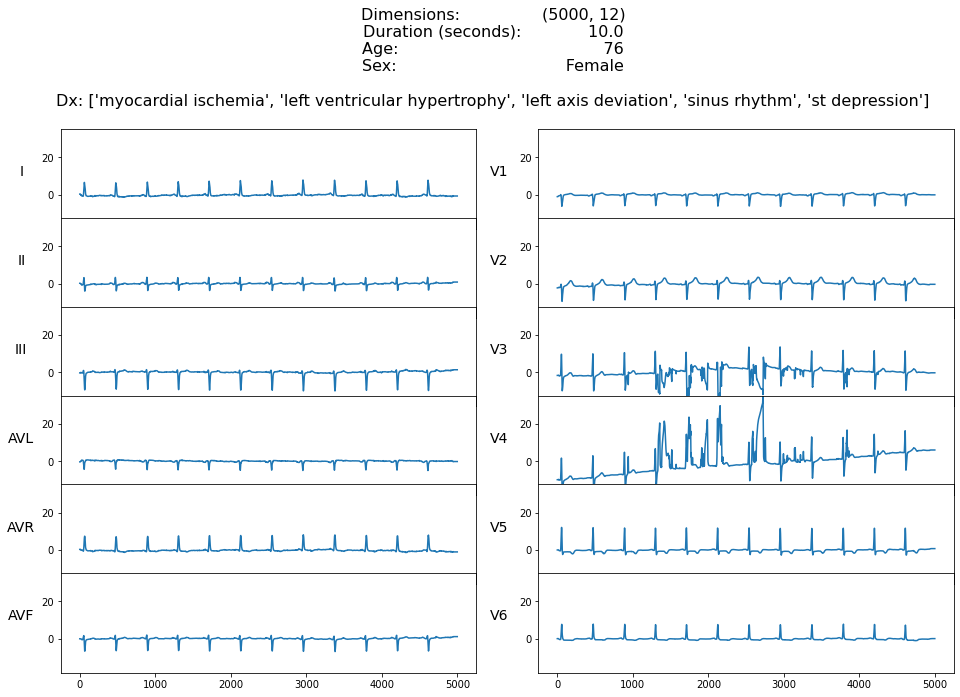

In [149]:
k = 6
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**Would myocardial infraction be detected if we had cut before 3 seconds?**

The min value of this ECG is -25.005 and the max value is 14.605


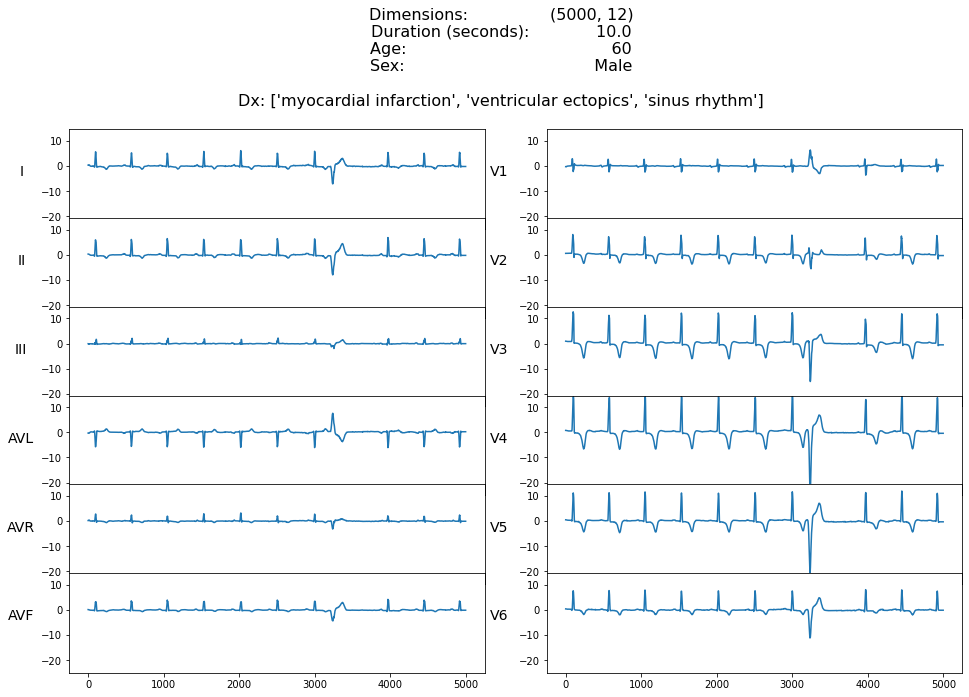

In [150]:
k = 7
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -25.7 and the max value is 12.95


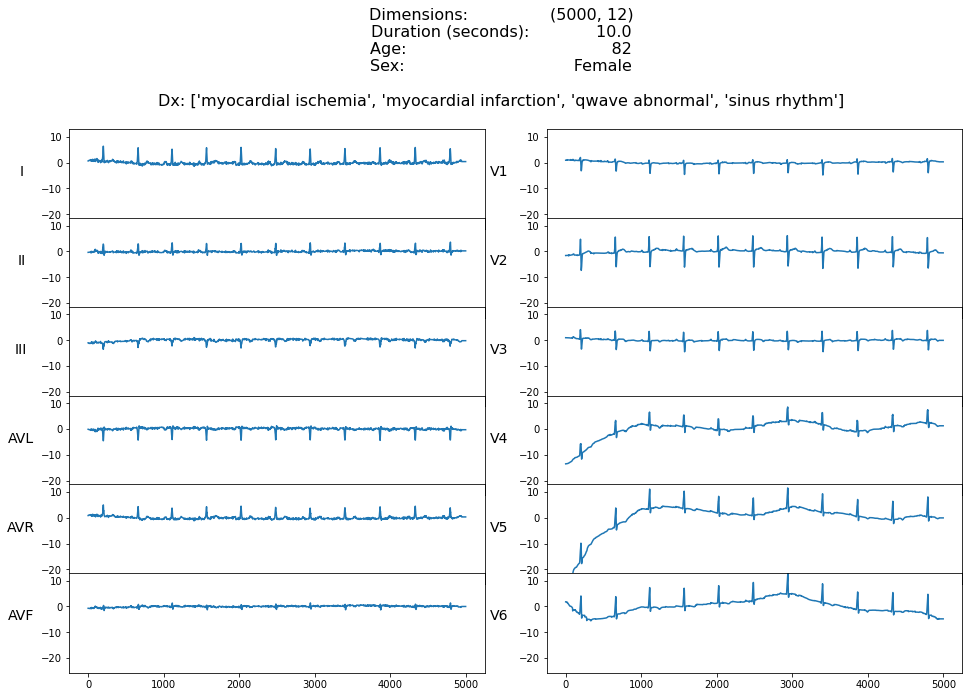

In [151]:
k = 8
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -71.325 and the max value is 58.0


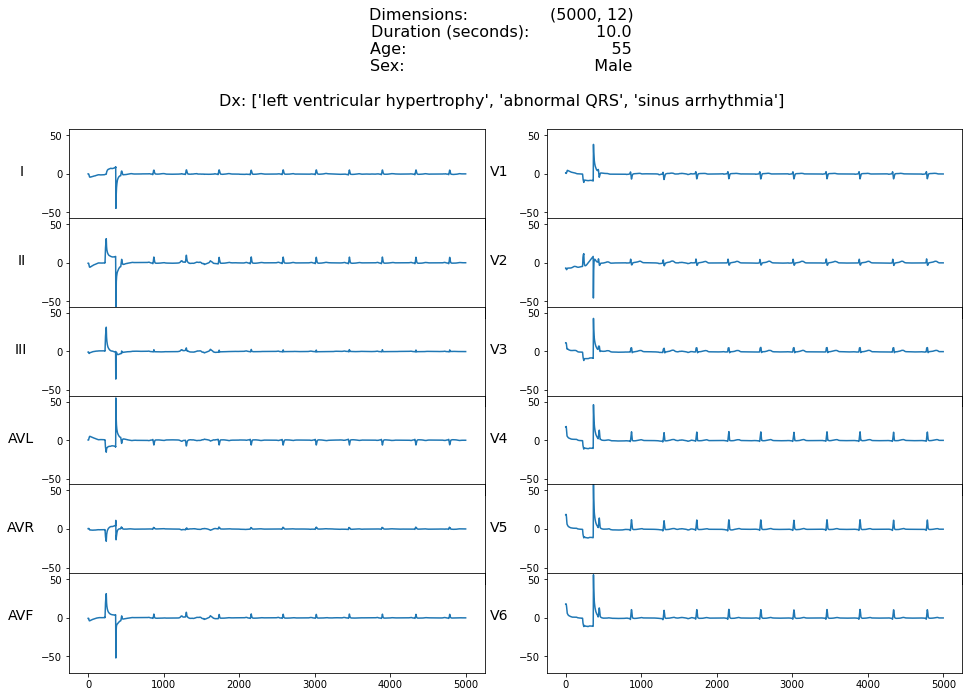

In [153]:
k = 10
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**Why only synus rhythm?**

The min value of this ECG is -56.65 and the max value is 16.1


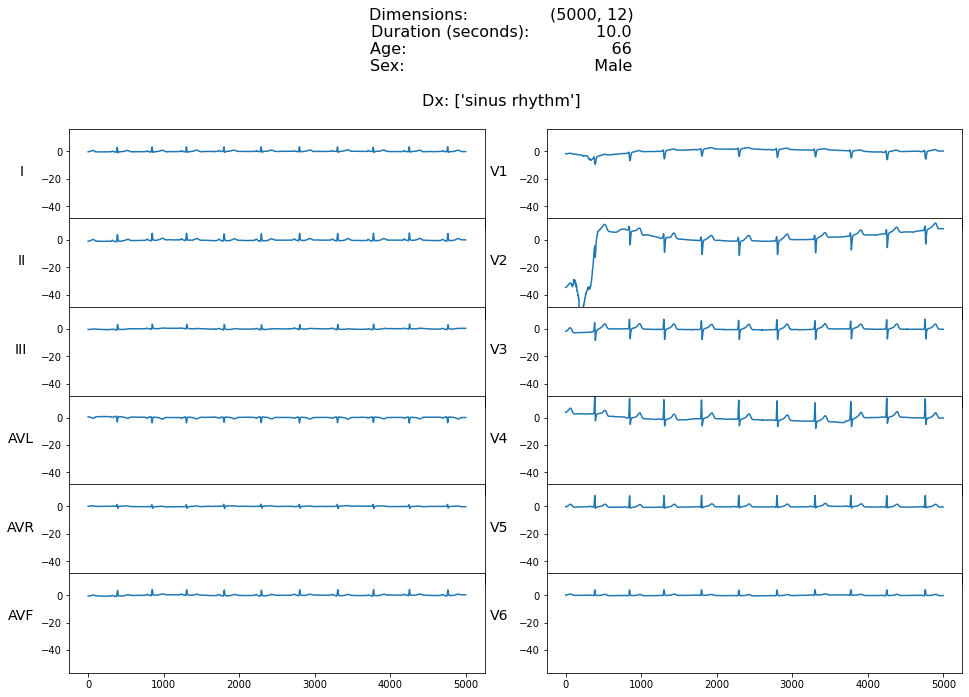

In [161]:
k = 18
example = wfdb.rdsamp(path+hea_files[some_outliers[k]])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**This one is very wierd overall, plus there is a lot of noise if seen closer.**

The min value of this ECG is -16.375 and the max value is 27.37


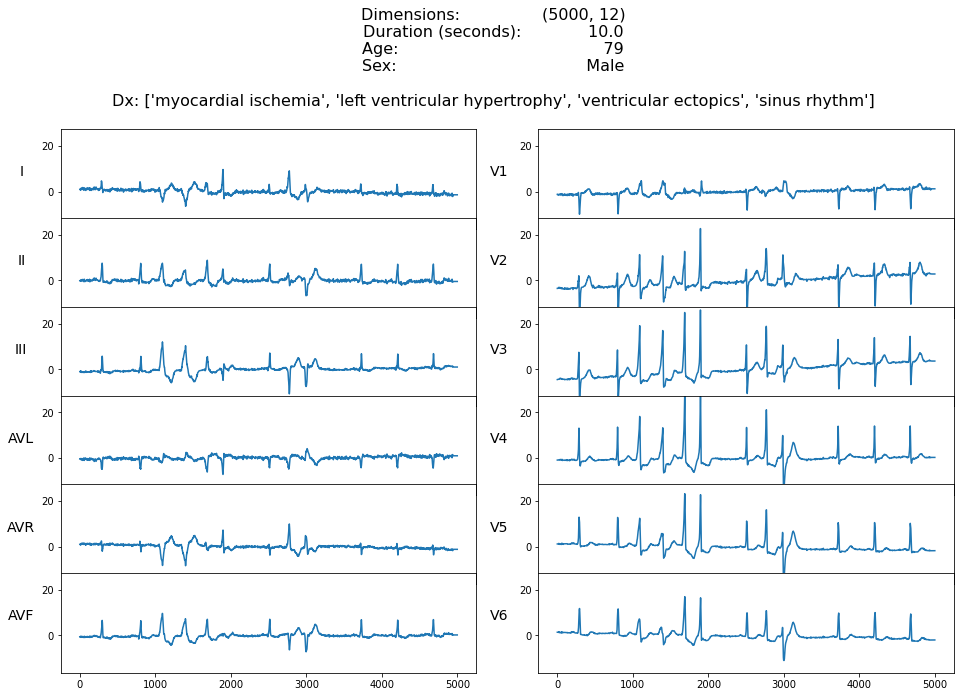

In [612]:
k = outliers.index[20]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

The min value of this ECG is -16.375 and the max value is 27.37


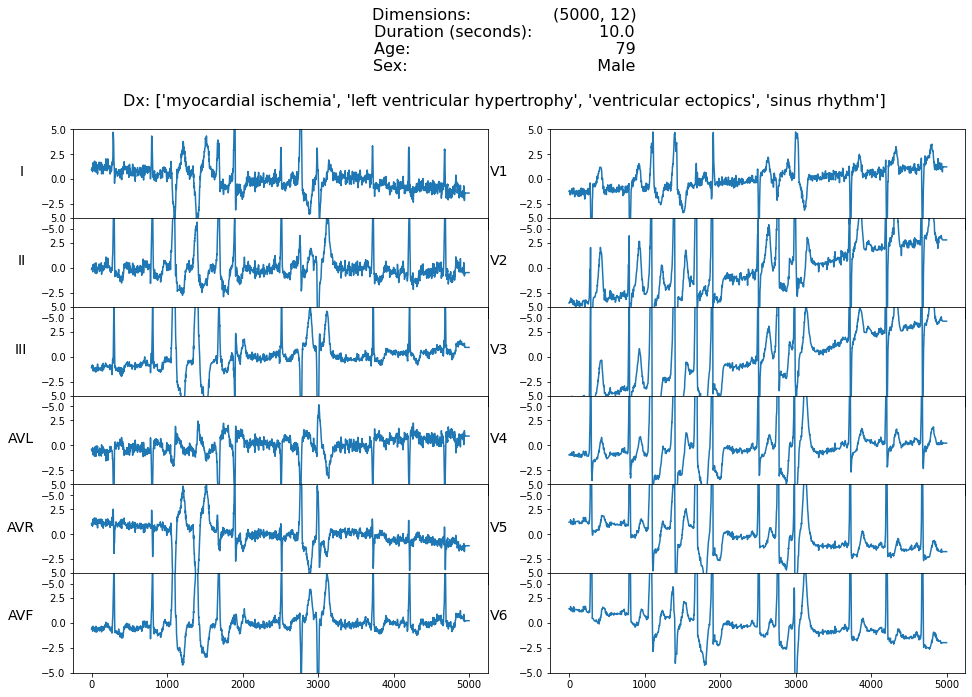

In [614]:
k = outliers.index[20]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
print('The min value of this ECG is', example[0].min(), 'and the max value is', example[0].max())
pa.plot_ecg(example[0], metadata=metadata, ylim=(-5, 5))

## Counting Data

Only PTB-XL files

In [286]:
# folders = ['PTB-XL']

# all_files = []

# for subfolder in folders:
    
#     subfolders = os.listdir(f'data/{subfolder}')
#     subfolders = [s for s in subfolders if 'g' in s]
    
#     for subsubfolder in subfolders:

#         files_ = os.listdir(f'data/{subfolder}/{subsubfolder}')
#         all_files.extend([file for file in files_ if '.hea' in file])

# print(len(all_files))

21837


All files

In [287]:
# folders = ['CPSC', 'CPSC-Extra', 'Georgia', 'PTB', 'PTB-XL', 'StPetersburg']

# all_files = []

# for subfolder in folders:
    
#     subfolders = os.listdir(f'data/{subfolder}')
#     subfolders = [s for s in subfolders if 'g' in s]
    
#     for subsubfolder in subfolders:

#         files_ = os.listdir(f'data/{subfolder}/{subsubfolder}')
#         all_files.extend([file for file in files_ if '.hea' in file])

# print(len(all_files))

43101


## Organizing ECG imgs by Urgency

To better show some examples given their urgency level, we rename the imgs files. First we build a temporary folder.

In [334]:
# import shutil

# try:
#     os.mkdir('C:/Users/Mike/Downloads/imgs_by_urgency')
# except FileExistsError:
#     pass

Then for each desired urgency level, we copy the files of each of its diagnoses with more descriptive names.

In [335]:
# for urgency_level in [1,2]:

#     urgency = md.dx_by_urgency(urgency_level=urgency_level, requirements=requirements)
#     urgency = urgency['Diagnostic Description']
#     urgency = list(urgency)
#     urgency = [urg.replace(' ', '_') for urg in urgency]
#     urgency

#     for urg in urgency:

#         folder = os.listdir(f'imgs/PTB-XL/ecg/dx_desc/{urg}')

#         for k, imx in enumerate(folder):

#             shutil.copy(f'imgs/PTB-XL/ecg/dx_desc/{urg}/{imx}', 
#                         f'C:/Users/Mike/Downloads/imgs_by_urgency/UL_{urgency_level}_DX_{urg}_EX_{k+1}.png')

# ----------------------------------------------------------------------------------------------------------

# =============================================================

## PTB-XL Superclasses

# =============================================================

# ----------------------------------------------------------------------------------------------------------

### Loading Superclasses

In [23]:
# import ast

# # load and convert annotation data
# Y_ptbxl = pd.read_csv('data/ptbxl_database.csv', index_col='ecg_id')
# Y_ptbxl.scp_codes = Y_ptbxl.scp_codes.apply(lambda x: ast.literal_eval(x))

# # Load scp_statements.csv for diagnostic aggregation
# agg_df = pd.read_csv('data/scp_statements.csv', index_col=0)
# agg_df = agg_df[agg_df.diagnostic == 1]

# def aggregate_diagnostic(y_dic):
#     tmp = []
#     for key in y_dic.keys():
#         if key in agg_df.index:
#             tmp.append(agg_df.loc[key].diagnostic_class)
#     return list(set(tmp))

# # Apply diagnostic superclass
# Y_ptbxl['diagnostic_superclass'] = Y_ptbxl.scp_codes.apply(aggregate_diagnostic)

# superclasses = set(agg_df.diagnostic_class)

This can take some time. For this reason we rather save it as a .csv file for later use.

In [24]:
# superclasses_df = pd.DataFrame(columns = superclasses)

# for i in range(len(Y_ptbxl.diagnostic_superclass)):
    
#     class_aux = pd.DataFrame(index = [0], columns = superclasses)
    
#     for sc in Y_ptbxl.diagnostic_superclass.iloc[i]:
#         class_aux.loc[0, sc] = 1
        
        
#     superclasses_df = pd.concat([superclasses_df, class_aux])
    
# superclasses_df = superclasses_df.fillna(0)

# superclasses_df.to_csv('data/PTB-XL/Y_superclasses.csv')

Read the previously calculated DF:

In [32]:
superclasses_df = pd.read_csv('data/PTB-XL/Y_superclasses.csv', index_col=0)

We are mostly interested in the MI and STTC classes. For this reason, we OHE so that we have mutually exclusive columns for:

    i. MI (no STTC)
    ii. STTC (no MI)
    iii MI & STTC
    iv. Other

In [33]:
# Copy and keep only the classes of interest
strat_df = superclasses_df.copy()
strat_df = strat_df.reset_index()
strat_df.index = strat_df.index + 1
strat_df = strat_df[['MI', 'STTC']]

# Intersection between MI & STTC
strat_df['MI&STTC'] = (strat_df['MI'] == 1) & (strat_df['STTC'] == 1)
strat_df['MI&STTC'] = strat_df['MI&STTC'].astype(int)

# Correct MI and STTC columns given an intersection
strat_df['MI'] = strat_df['MI'] - strat_df['MI&STTC']
strat_df['STTC'] = strat_df['STTC'] - strat_df['MI&STTC']

# Create the OTHER column as the complement
strat_df['OTHER'] = (strat_df['MI'] == 0) & (strat_df['STTC'] == 0) & (strat_df['MI&STTC'] == 0)
strat_df['OTHER'] = strat_df['OTHER'].astype(int)

# Add a label column 
strat_df['label'] = strat_df.idxmax(axis=1)
print(strat_df.shape)
strat_df.head()

(21837, 5)


,MI,STTC,MI&STTC,OTHER,label
1,0,0,0,1,OTHER
2,0,0,0,1,OTHER
3,0,0,0,1,OTHER
4,0,0,0,1,OTHER
5,0,0,0,1,OTHER


### Train, Validation & Test

We first reduce the length of the signals since it would be too computationally costly otherwise atm.

In [38]:
# Notice that this way to cut currently works only for PTB-XL, since all records are the of
# the same duration and frequency sampling

cut = 0.3
X_cut = X[:, :int(cut * X.shape[1]), :]

Define the proportions for each set.

In [35]:
val_size = 0.2
test_size = 0.2

Define the indices so that we can recover them later

In [36]:
indices = np.arange(len(X_cut))

Retrieve the train, validation and test sets for:

    x : The signals
    y : The labels
    idx : The indices of the original X and Y
    age_n_sex : The age and sex

In [37]:
# Train and test
train_set_x, test_set_x = train_test_split(X_cut, test_size=test_size, random_state=random_state)
train_set_y, test_set_y = train_test_split(strat_df.drop(['label'], 1), test_size=test_size, random_state=random_state)
train_set_idx, test_set_idx = train_test_split(indices, test_size=test_size, random_state=random_state)

# Train and val
train_set_x, val_set_x = train_test_split(train_set_x, test_size=val_size, random_state=random_state)
train_set_y, val_set_y = train_test_split(train_set_y, test_size=val_size, random_state=random_state)
train_set_idx, val_set_idx = train_test_split(train_set_idx, test_size=test_size, random_state=random_state)

# Get the age and sex given the indices
train_set_age_n_sex, mean_age = md.age_and_sex_set(Y, train_set_idx)
val_set_age_n_sex = md.age_and_sex_set(Y, val_set_idx, mean_age)
test_set_age_n_sex = md.age_and_sex_set(Y, test_set_idx, mean_age)

n_total_train = train_set_x.shape[0]
batches = n_total_train//batch_size

train_set_y = np.array(train_set_y)
val_set_y = np.array(val_set_y)
test_set_y = np.array(test_set_y)

Verify if the total amount of values for each set is adequate

In [184]:
print(train_set_y.shape)
print(val_set_y.shape)
print(test_set_y.shape)

(13975, 4)
(3494, 4)
(4368, 4)


Verify the age and sex were correctly processed. 

### Note: At the moment, we are only using PTB-XL. When we use the other datasets, there is no guarantee that the preprocessing for age and sex will be the same.

In [192]:
Y.iloc[train_set_idx][['age', 'sex']].head()

,age,sex
5000,69,Male
16835,67,Female
12356,49,Female
3450,24,Male
10222,63,Male


In [193]:
train_set_age_n_sex[:5]

array([[69,  1],
       [67,  0],
       [49,  0],
       [24,  1],
       [63,  1]], dtype=int64)

We verify that we have a stratified distribution of labels inthe 3 sets.

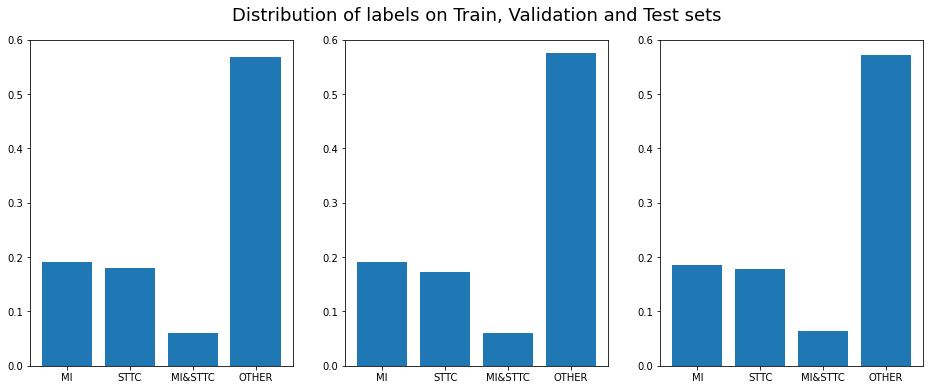

In [35]:
fig, axs = plt.subplots(1,3, figsize = (16,6))
axs[0].bar(strat_df.columns[:-1], train_set_y.sum(0) /  train_set_y.sum(), )
axs[1].bar(strat_df.columns[:-1], val_set_y.sum(0) /  val_set_y.sum())
axs[2].bar(strat_df.columns[:-1], test_set_y.sum(0) /  test_set_y.sum())
[ax.set_ylim(0,0.6) for ax in axs]

axs[1].set_title('Distribution of labels on Train, Validation and Test sets', y = 1.04, fontsize=18);

# =============================================================

### CNN Implementation

# =============================================================

#### Multibinary - Simplest model

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [36]:
model_id = 'PTB-XL_labels/own/multibinary_1.h5'

Parameters

In [37]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [38]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(64, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Conv1D(128, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Conv1D(256, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Flatten(),
            Dense(128, activation='relu'),
            Dense(4, activation='sigmoid')
])

Summary.

In [39]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 1500, 64)          2368      
                                                                 
 max_pooling1d (MaxPooling1D  (None, 750, 64)          0         
 )                                                               
                                                                 
 conv1d_1 (Conv1D)           (None, 750, 128)          24704     
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 375, 128)         0         
 1D)                                                             
                                                                 
 conv1d_2 (Conv1D)           (None, 375, 256)          98560     
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 187, 256)         0

In [40]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 11s 27ms/step - loss: 0.4126 - accuracy: 0.6176 - val_loss: 0.3479 - val_accuracy: 0.6949
Epoch 2/50
218/218 [==============================] - 6s 28ms/step - loss: 0.3280 - accuracy: 0.7109 - val_loss: 0.3510 - val_accuracy: 0.6875
Epoch 3/50
218/218 [==============================] - 7s 31ms/step - loss: 0.2867 - accuracy: 0.7507 - val_loss: 0.3199 - val_accuracy: 0.7207
Epoch 4/50
218/218 [==============================] - 7s 31ms/step - loss: 0.2496 - accuracy: 0.7892 - val_loss: 0.3437 - val_accuracy: 0.7204
Epoch 5/50
218/218 [==============================] - 7s 31ms/step - loss: 0.1914 - accuracy: 0.8490 - val_loss: 0.4037 - val_accuracy: 0.7098
Epoch 6/50
218/218 [==============================] - 7s 31ms/step - loss: 0.1284 - accuracy: 0.9096 - val_loss: 0.4967 - val_accuracy: 0.7003
Epoch 7/50
218/218 [==============================] - 7s 31ms/step - loss: 0.0745 - accuracy: 0.9577 - val_loss: 0.6273 - val_accuracy: 0.690

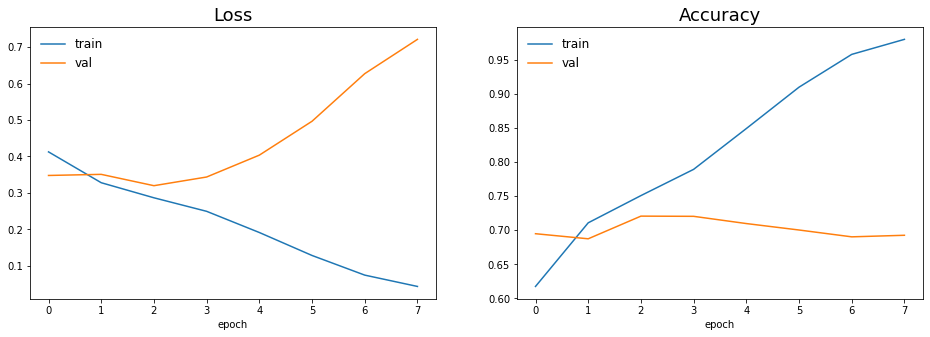

In [41]:
pa.plot_model_history(fitted_model)

**Without thresholds**

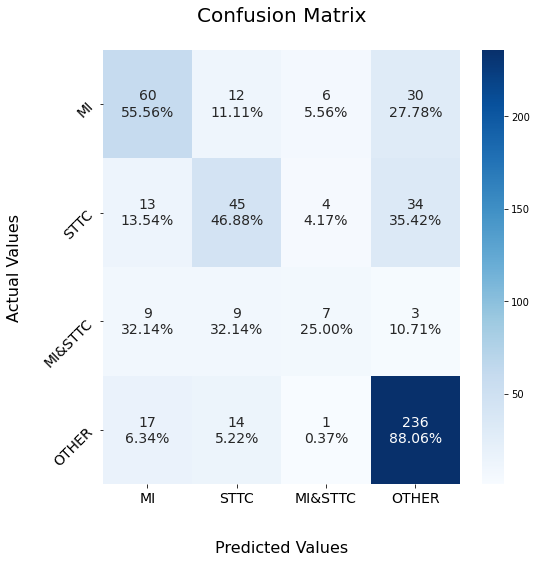

In [42]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

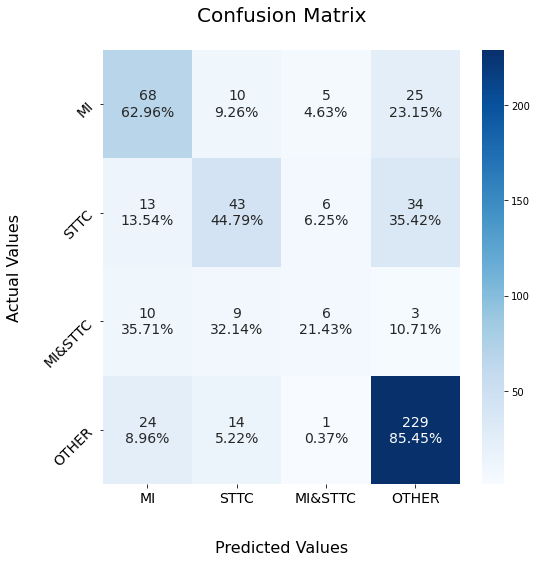

In [43]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [134]:
model_id = 'PTB-XL_labels/own/multibinary_2.h5'

Parameters

In [135]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [137]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same"),
            MaxPool1D(),

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
])

Summary.

In [138]:
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_22 (Conv1D)          (None, 500, 128)          21632     
                                                                 
 max_pooling1d_16 (MaxPoolin  (None, 250, 128)         0         
 g1D)                                                            
                                                                 
 conv1d_23 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_17 (MaxPoolin  (None, 42, 256)          0         
 g1D)                                                            
                                                                 
 conv1d_24 (Conv1D)          (None, 21, 256)           655616    
                                                                 
 max_pooling1d_18 (MaxPoolin  (None, 10, 256)         

In [139]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 8s 35ms/step - loss: 0.3854 - accuracy: 0.6477 - val_loss: 0.3147 - val_accuracy: 0.7189
Epoch 2/50
218/218 [==============================] - 7s 33ms/step - loss: 0.3004 - accuracy: 0.7411 - val_loss: 0.2943 - val_accuracy: 0.7398
Epoch 3/50
218/218 [==============================] - 7s 34ms/step - loss: 0.2747 - accuracy: 0.7647 - val_loss: 0.3007 - val_accuracy: 0.7421
Epoch 4/50
218/218 [==============================] - 7s 33ms/step - loss: 0.2457 - accuracy: 0.7886 - val_loss: 0.3263 - val_accuracy: 0.7293
Epoch 5/50
218/218 [==============================] - 7s 33ms/step - loss: 0.2197 - accuracy: 0.8172 - val_loss: 0.3309 - val_accuracy: 0.7476
Epoch 6/50
218/218 [==============================] - 7s 33ms/step - loss: 0.1786 - accuracy: 0.8511 - val_loss: 0.3938 - val_accuracy: 0.7330
Epoch 7/50
218/218 [==============================] - 7s 32ms/step - loss: 0.1378 - accuracy: 0.8917 - val_loss: 0.4917 - val_accuracy: 0.7353

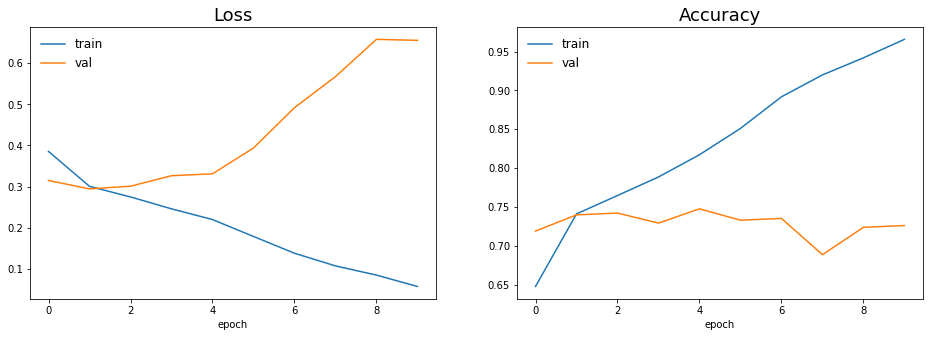

In [140]:
pa.plot_model_history(fitted_model)

**Without thresholds**

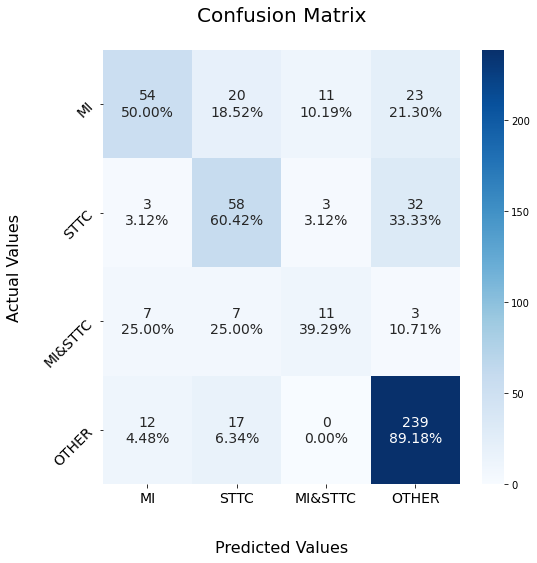

In [141]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

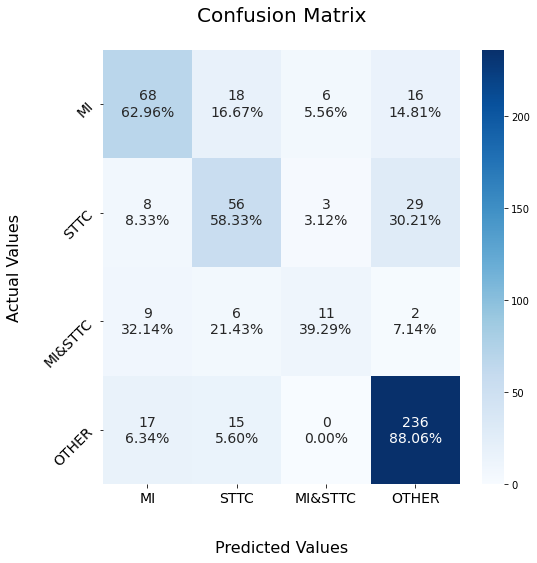

In [142]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [123]:
model_id = 'PTB-XL_labels/own/multibinary_bn_1.h5'

Parameters

In [124]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [125]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same", use_bias=False),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same", use_bias=False),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", use_bias=False),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", use_bias=False),
            BatchNormalization(),

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [126]:
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_18 (Conv1D)          (None, 500, 128)          21504     
                                                                 
 batch_normalization_18 (Bat  (None, 500, 128)         512       
 chNormalization)                                                
                                                                 
 conv1d_19 (Conv1D)          (None, 167, 256)          458752    
                                                                 
 batch_normalization_19 (Bat  (None, 167, 256)         1024      
 chNormalization)                                                
                                                                 
 conv1d_20 (Conv1D)          (None, 84, 256)           655360    
                                                                 
 batch_normalization_20 (Bat  (None, 84, 256)         

In [127]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 18s 74ms/step - loss: 0.5032 - accuracy: 0.6195 - val_loss: 0.3651 - val_accuracy: 0.6809
Epoch 2/50
218/218 [==============================] - 15s 70ms/step - loss: 0.3230 - accuracy: 0.7143 - val_loss: 0.3829 - val_accuracy: 0.6986
Epoch 3/50
218/218 [==============================] - 20s 90ms/step - loss: 0.2876 - accuracy: 0.7475 - val_loss: 0.3250 - val_accuracy: 0.7195
Epoch 4/50
218/218 [==============================] - 34s 154ms/step - loss: 0.2526 - accuracy: 0.7838 - val_loss: 0.3263 - val_accuracy: 0.7267
Epoch 5/50
218/218 [==============================] - 28s 130ms/step - loss: 0.2188 - accuracy: 0.8179 - val_loss: 0.3460 - val_accuracy: 0.7212
Epoch 6/50
218/218 [==============================] - 28s 127ms/step - loss: 0.1708 - accuracy: 0.8709 - val_loss: 0.3783 - val_accuracy: 0.7258
Epoch 7/50
218/218 [==============================] - 28s 130ms/step - loss: 0.1275 - accuracy: 0.9088 - val_loss: 0.4772 - val_accur

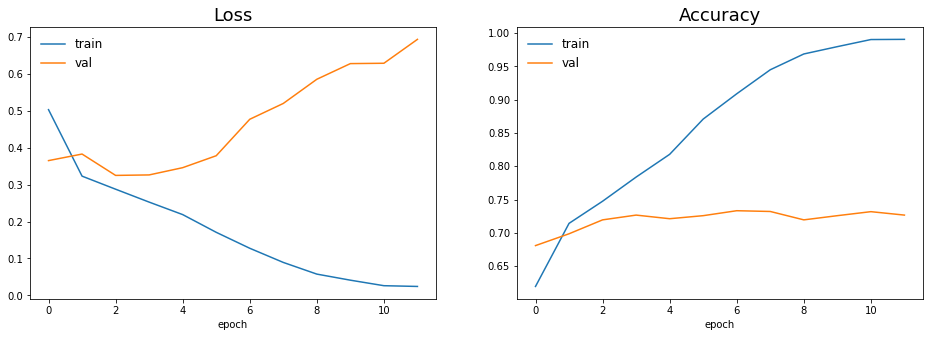

In [128]:
pa.plot_model_history(fitted_model)

**Without thresholds**

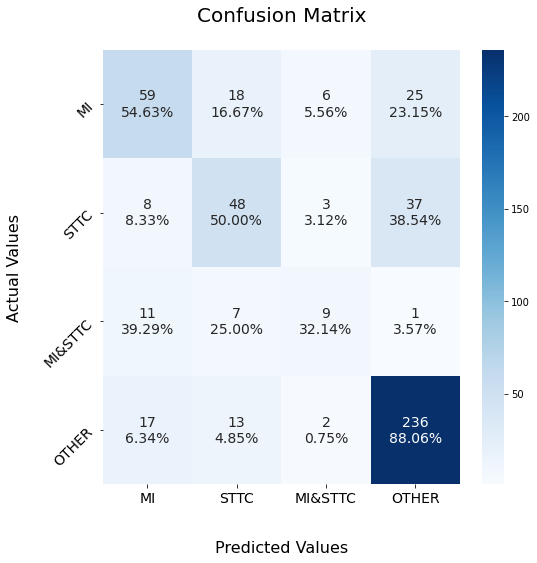

In [129]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

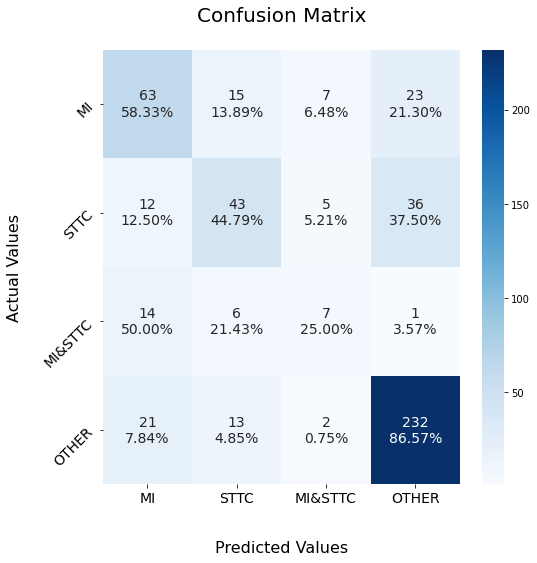

In [130]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [44]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_2.h5'

Parameters

In [45]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [46]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
            MaxPool1D(),
            BatchNormalization(),            

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [47]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 250, 128)         512       
 ormalization)                                                   
                                                                 
 conv1d_4 (Conv1D)           (None, 84, 256)           459008    
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 42, 256)          0         
 1D)                                                             
                                                      

In [48]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 9s 34ms/step - loss: 1.3691 - accuracy: 0.5531 - val_loss: 0.4933 - val_accuracy: 0.5678
Epoch 2/50
218/218 [==============================] - 8s 35ms/step - loss: 0.4762 - accuracy: 0.5764 - val_loss: 0.4606 - val_accuracy: 0.5830
Epoch 3/50
218/218 [==============================] - 8s 35ms/step - loss: 0.4600 - accuracy: 0.5948 - val_loss: 0.4666 - val_accuracy: 0.5987
Epoch 4/50
218/218 [==============================] - 8s 35ms/step - loss: 0.4426 - accuracy: 0.6251 - val_loss: 0.4097 - val_accuracy: 0.6677
Epoch 5/50
218/218 [==============================] - 8s 35ms/step - loss: 0.3894 - accuracy: 0.6855 - val_loss: 0.4050 - val_accuracy: 0.6857
Epoch 6/50
218/218 [==============================] - 8s 35ms/step - loss: 0.3723 - accuracy: 0.7056 - val_loss: 0.3890 - val_accuracy: 0.6857
Epoch 7/50
218/218 [==============================] - 8s 35ms/step - loss: 0.3570 - accuracy: 0.7203 - val_loss: 0.3803 - val_accuracy: 0.6938

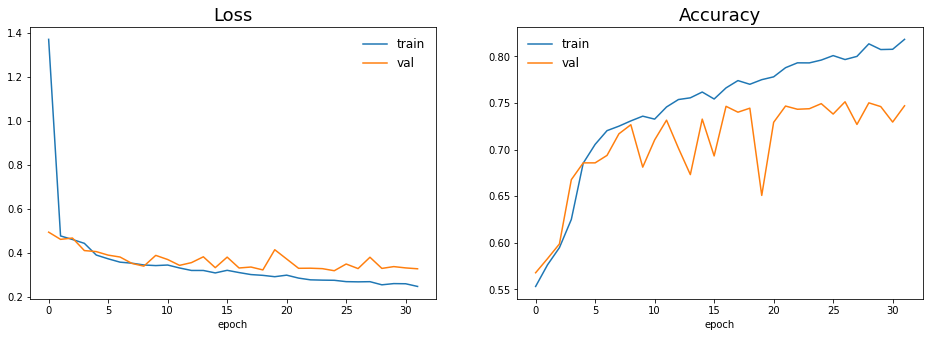

In [49]:
pa.plot_model_history(fitted_model)

**Without thresholds**

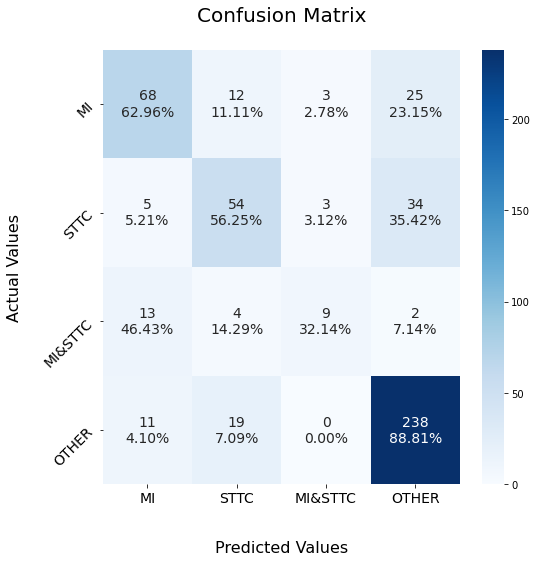

In [50]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

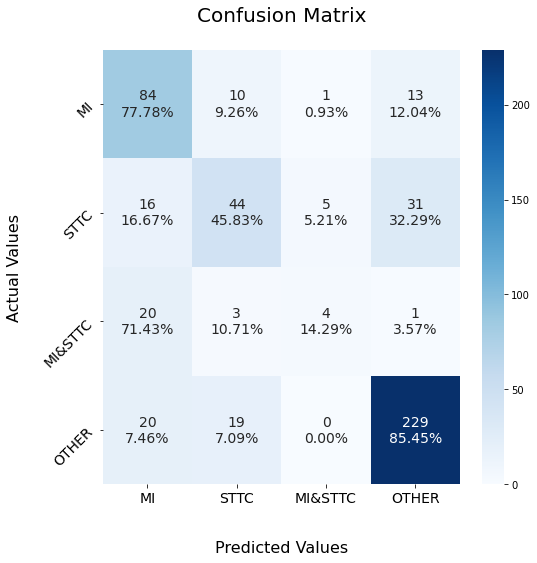

In [51]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer (playing with L1)

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [76]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_5.h5'

Parameters

In [77]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [78]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.006)),
            MaxPool1D(),
            BatchNormalization(),            

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [79]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_32 (Conv1D)          (None, 500, 128)          21632     
                                                                 
 max_pooling1d_12 (MaxPoolin  (None, 250, 128)         0         
 g1D)                                                            
                                                                 
 batch_normalization_24 (Bat  (None, 250, 128)         512       
 chNormalization)                                                
                                                                 
 conv1d_33 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_13 (MaxPoolin  (None, 42, 256)          0         
 g1D)                                                            
                                                      

In [80]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=10)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 8s 34ms/step - loss: 1.1487 - accuracy: 0.5596 - val_loss: 0.4707 - val_accuracy: 0.5744
Epoch 2/50
218/218 [==============================] - 8s 38ms/step - loss: 0.4291 - accuracy: 0.6018 - val_loss: 0.4070 - val_accuracy: 0.6162
Epoch 3/50
218/218 [==============================] - 9s 40ms/step - loss: 0.3948 - accuracy: 0.6459 - val_loss: 0.3811 - val_accuracy: 0.6629
Epoch 4/50
218/218 [==============================] - 8s 39ms/step - loss: 0.3722 - accuracy: 0.6896 - val_loss: 0.3717 - val_accuracy: 0.6674
Epoch 5/50
218/218 [==============================] - 8s 39ms/step - loss: 0.3800 - accuracy: 0.6984 - val_loss: 0.3562 - val_accuracy: 0.7132
Epoch 6/50
218/218 [==============================] - 9s 40ms/step - loss: 0.3414 - accuracy: 0.7240 - val_loss: 0.3447 - val_accuracy: 0.7095
Epoch 7/50
218/218 [==============================] - 8s 38ms/step - loss: 0.3320 - accuracy: 0.7310 - val_loss: 0.3378 - val_accuracy: 0.7192

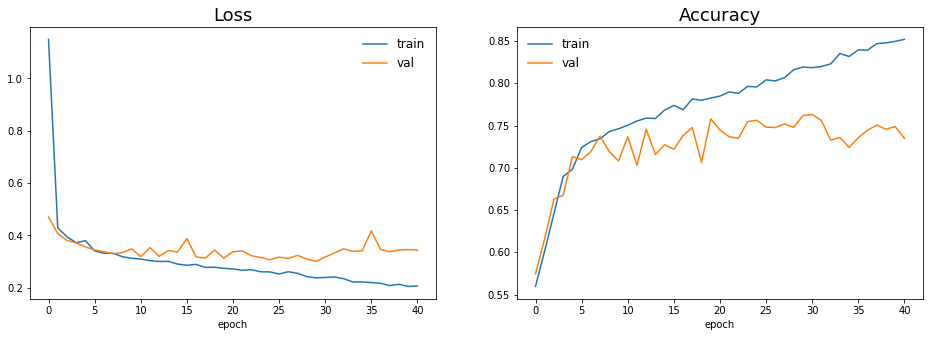

In [81]:
pa.plot_model_history(fitted_model)

**Without thresholds**

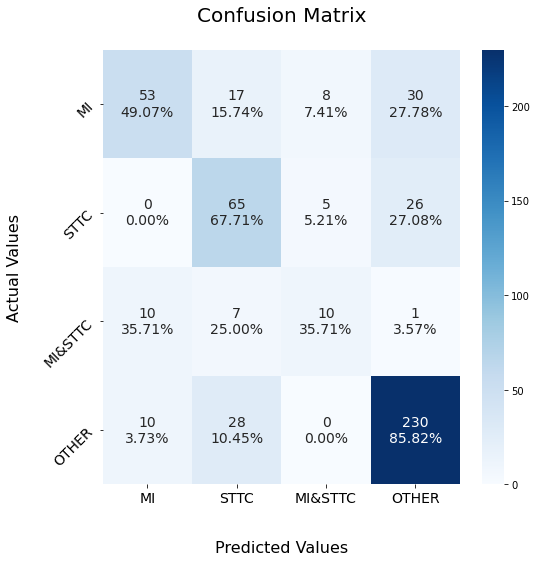

In [82]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

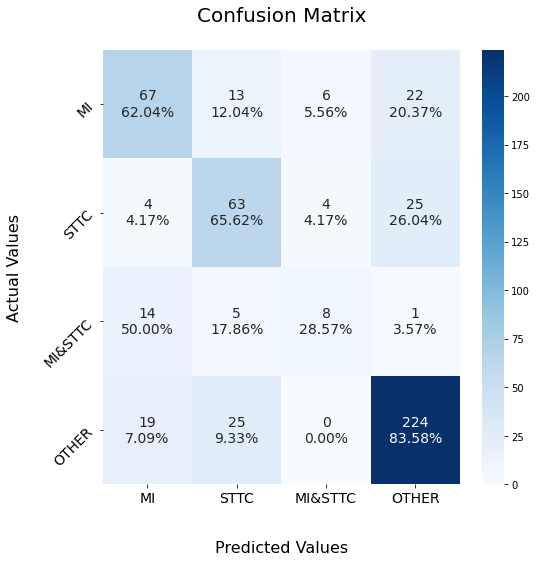

In [83]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Dropout

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [45]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_dr_9.h5'

Parameters

In [46]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [47]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),                 
            BatchNormalization(),
            Dropout(rate=0.3),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),
            Dropout(rate=0.3),
        
            Conv1D(d_model, 10, activation='relu', strides=2, padding="same"),
            MaxPool1D(),            
            BatchNormalization(),    
            Dropout(rate=0.3),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.006)),
            MaxPool1D(),            
            BatchNormalization(),            
            Dropout(rate=0.3),

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [48]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 batch_normalization_4 (Batc  (None, 250, 128)         512       
 hNormalization)                                                 
                                                                 
 dropout_2 (Dropout)         (None, 250, 128)          0         
                                                                 
 conv1d_5 (Conv1D)           (None, 84, 256)           459008    
                                                                 
 max_pooling1d_5 (MaxPooling  (None, 42, 256)         

In [49]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches-1,
                               epochs=125, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=15)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/125
217/217 [==============================] - 9s 34ms/step - loss: 0.8943 - accuracy: 0.5603 - val_loss: 0.4614 - val_accuracy: 0.5790
Epoch 2/125
217/217 [==============================] - 8s 39ms/step - loss: 0.4311 - accuracy: 0.6077 - val_loss: 0.3918 - val_accuracy: 0.6325
Epoch 3/125
217/217 [==============================] - 10s 45ms/step - loss: 0.4091 - accuracy: 0.6342 - val_loss: 0.4174 - val_accuracy: 0.6540
Epoch 4/125
217/217 [==============================] - 9s 43ms/step - loss: 0.3938 - accuracy: 0.6511 - val_loss: 0.3574 - val_accuracy: 0.6774
Epoch 5/125
217/217 [==============================] - 9s 43ms/step - loss: 0.3736 - accuracy: 0.6850 - val_loss: 0.3511 - val_accuracy: 0.6955
Epoch 6/125
217/217 [==============================] - 9s 43ms/step - loss: 0.3644 - accuracy: 0.6891 - val_loss: 0.3778 - val_accuracy: 0.6869
Epoch 7/125
217/217 [==============================] - 9s 43ms/step - loss: 0.3580 - accuracy: 0.6971 - val_loss: 0.3351 - val_accuracy

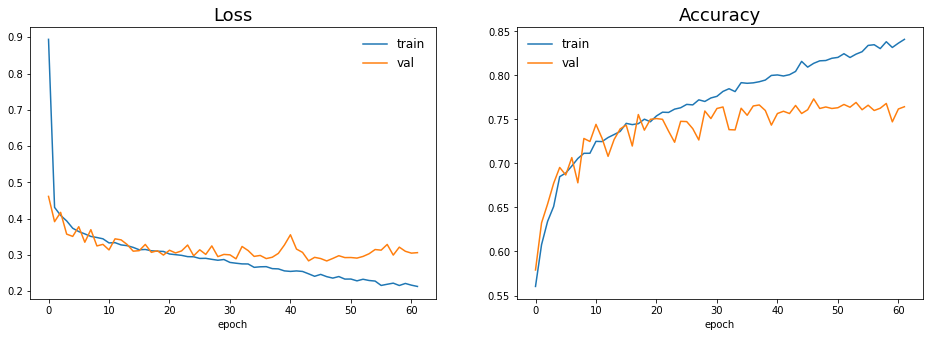

In [50]:
pa.plot_model_history(fitted_model)

**Without thresholds**

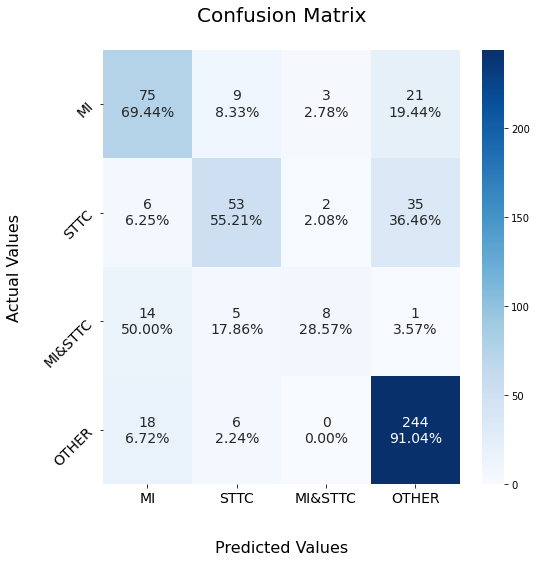

In [51]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

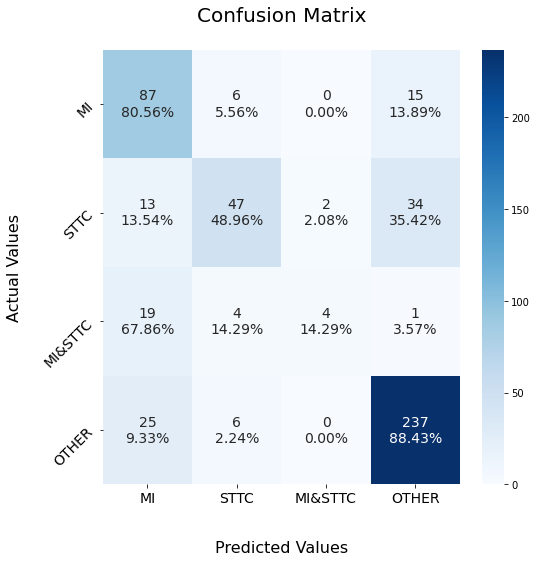

In [52]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Dropout + ResNet

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [98]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_dr_rn_1.h5'

Parameters

In [99]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [100]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            Dropout(rate=0.2),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            Dropout(rate=0.2),
            BatchNormalization(),
        
            Conv1D(d_model, 10, activation='relu', strides=2, padding="same"),
            MaxPool1D(),
            Dropout(rate=0.2),
            BatchNormalization(),    

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.006)),
            MaxPool1D(),
            Dropout(rate=0.2),
            BatchNormalization(),            

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [101]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_40 (Conv1D)          (None, 500, 128)          21632     
                                                                 
 max_pooling1d_20 (MaxPoolin  (None, 250, 128)         0         
 g1D)                                                            
                                                                 
 dropout_19 (Dropout)        (None, 250, 128)          0         
                                                                 
 batch_normalization_30 (Bat  (None, 250, 128)         512       
 chNormalization)                                                
                                                                 
 conv1d_41 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_21 (MaxPoolin  (None, 42, 256)         

In [102]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=10)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 11s 46ms/step - loss: 0.7719 - accuracy: 0.5622 - val_loss: 0.4523 - val_accuracy: 0.5767
Epoch 2/50
218/218 [==============================] - 10s 47ms/step - loss: 0.4170 - accuracy: 0.6125 - val_loss: 0.3889 - val_accuracy: 0.6279
Epoch 3/50
218/218 [==============================] - 11s 48ms/step - loss: 0.3968 - accuracy: 0.6327 - val_loss: 0.3987 - val_accuracy: 0.6483
Epoch 4/50
218/218 [==============================] - 11s 48ms/step - loss: 0.3752 - accuracy: 0.6735 - val_loss: 0.3357 - val_accuracy: 0.7101
Epoch 5/50
218/218 [==============================] - 11s 48ms/step - loss: 0.3595 - accuracy: 0.6907 - val_loss: 0.3766 - val_accuracy: 0.6926
Epoch 6/50
218/218 [==============================] - 11s 51ms/step - loss: 0.3539 - accuracy: 0.7007 - val_loss: 0.3265 - val_accuracy: 0.7221
Epoch 7/50
218/218 [==============================] - 12s 53ms/step - loss: 0.3437 - accuracy: 0.7115 - val_loss: 0.3647 - val_accuracy:

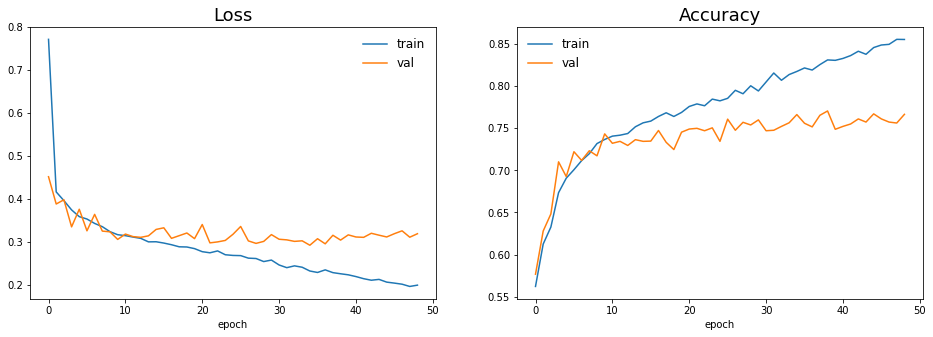

In [103]:
pa.plot_model_history(fitted_model)

**Without thresholds**

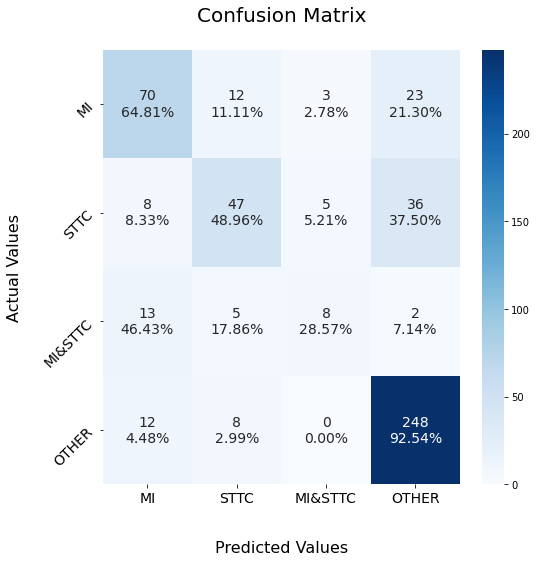

In [104]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

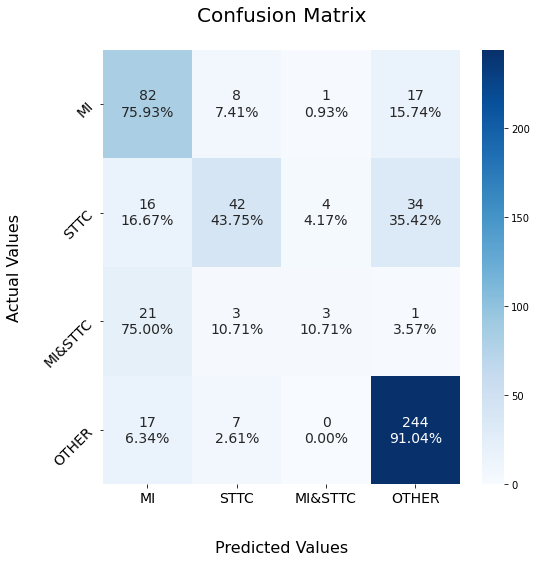

In [105]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Dropout + Age + Sex

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [230]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_dr_as_3.h5'

Parameters

In [231]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [232]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    
    ### Convolutional Model
    conv_input = Input(shape=(img_h, img_w))

    x = Conv1D(128, 14, activation='relu', strides=3, padding="same")(conv_input)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(256, 14, activation='relu', strides=3, padding="same")(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(d_model, 10, activation='relu', strides=2, padding="same")(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.006))(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Flatten()(x)

    x = Model(inputs = conv_input, outputs = x)
    
    
    ### Age and Sex Model
    wide_input = Input(shape=(2,))    
    y = Dense(10, activation='relu')(wide_input)    
    y = Model(inputs = wide_input, outputs = y)
    
    
    ### Combined Model
    combined = concatenate([x.output, y.output])
    z = Dense(d_model, activation='relu')(combined)
    z = Dense(4, activation='sigmoid')(z)

    model = Model(inputs=[x.input, y.input], outputs=z)

Summary.

In [233]:
model.summary()

Model: "model_26"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_26 (InputLayer)          [(None, 1500, 12)]   0           []                               
                                                                                                  
 conv1d_71 (Conv1D)             (None, 500, 128)     21632       ['input_26[0][0]']               
                                                                                                  
 max_pooling1d_71 (MaxPooling1D  (None, 250, 128)    0           ['conv1d_71[0][0]']              
 )                                                                                                
                                                                                                  
 dropout_14 (Dropout)           (None, 250, 128)     0           ['max_pooling1d_71[0][0]']

In [234]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit((train_set_x, train_set_age_n_sex), train_set_y, steps_per_epoch=batches,
                               epochs=100, validation_data=((val_set_x, val_set_age_n_sex), val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=15)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/100
218/218 [==============================] - 12s 47ms/step - loss: 0.8035 - accuracy: 0.5503 - val_loss: 0.4968 - val_accuracy: 0.5756
Epoch 2/100
218/218 [==============================] - 11s 49ms/step - loss: 0.4364 - accuracy: 0.5987 - val_loss: 0.4927 - val_accuracy: 0.5787
Epoch 3/100
218/218 [==============================] - 11s 49ms/step - loss: 0.4124 - accuracy: 0.6254 - val_loss: 0.4382 - val_accuracy: 0.6048
Epoch 4/100
218/218 [==============================] - 10s 48ms/step - loss: 0.4006 - accuracy: 0.6452 - val_loss: 0.3831 - val_accuracy: 0.6517
Epoch 5/100
218/218 [==============================] - 11s 49ms/step - loss: 0.3888 - accuracy: 0.6574 - val_loss: 0.3641 - val_accuracy: 0.6975
Epoch 6/100
218/218 [==============================] - 11s 48ms/step - loss: 0.3842 - accuracy: 0.6685 - val_loss: 0.3797 - val_accuracy: 0.6651
Epoch 7/100
218/218 [==============================] - 11s 48ms/step - loss: 0.3735 - accuracy: 0.6830 - val_loss: 0.3896 - val_ac

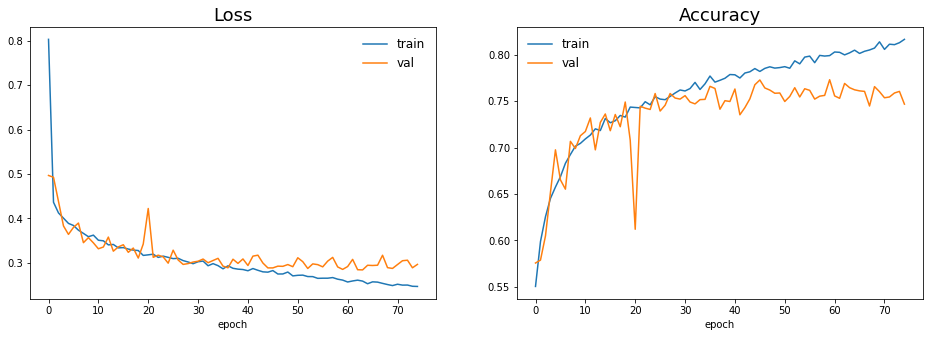

In [235]:
pa.plot_model_history(fitted_model)

**Without thresholds**

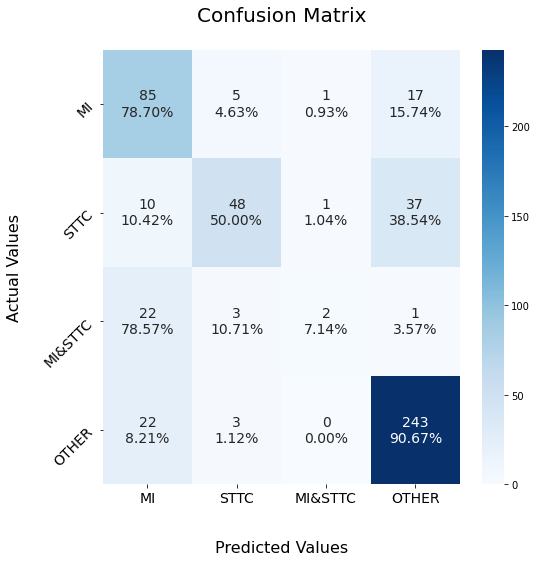

In [236]:
pa.plot_confusion_matrix(model, (test_set_x, test_set_age_n_sex), test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

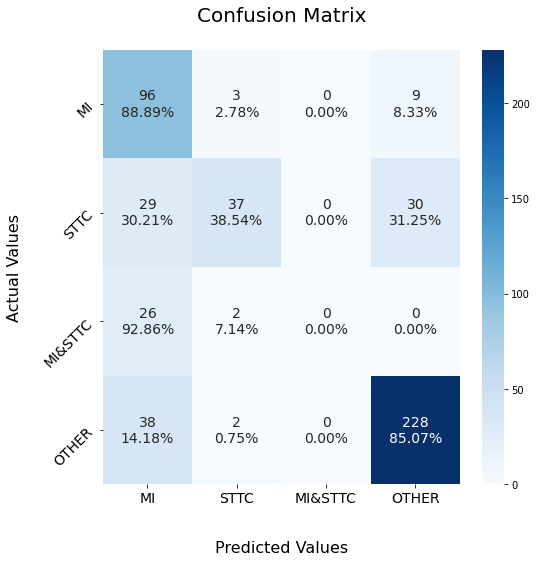

In [237]:
pa.plot_confusion_matrix(model, (test_set_x, test_set_age_n_sex), test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + LR Reduce

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [107]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_lr_1.h5'

Parameters

In [108]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1, verbose=1, mode='max',
    min_delta=0.0001, cooldown=0, min_lr=0
)

Load the model if it has been created, else create a new instance of it.

In [109]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
            MaxPool1D(),
            BatchNormalization(),            

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [110]:
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_12 (Conv1D)          (None, 500, 128)          21632     
                                                                 
 max_pooling1d_10 (MaxPoolin  (None, 250, 128)         0         
 g1D)                                                            
                                                                 
 batch_normalization_12 (Bat  (None, 250, 128)         512       
 chNormalization)                                                
                                                                 
 conv1d_13 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_11 (MaxPoolin  (None, 42, 256)          0         
 g1D)                                                            
                                                      

In [111]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5), reduce_lr])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 10s 41ms/step - loss: 1.3880 - accuracy: 0.5559 - val_loss: 0.4751 - val_accuracy: 0.5764 - lr: 0.0010
Epoch 2/50
217/218 [============================>.] - ETA: 0s - loss: 0.4310 - accuracy: 0.6095
Epoch 2: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
218/218 [==============================] - 9s 42ms/step - loss: 0.4306 - accuracy: 0.6100 - val_loss: 0.3932 - val_accuracy: 0.6451 - lr: 0.0010
Epoch 3/50
217/218 [============================>.] - ETA: 0s - loss: 0.3848 - accuracy: 0.6515
Epoch 3: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
218/218 [==============================] - 9s 41ms/step - loss: 0.3848 - accuracy: 0.6518 - val_loss: 0.3829 - val_accuracy: 0.6448 - lr: 1.0000e-04
Epoch 4/50
217/218 [============================>.] - ETA: 0s - loss: 0.3768 - accuracy: 0.6565
Epoch 4: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
218/218 [=====================

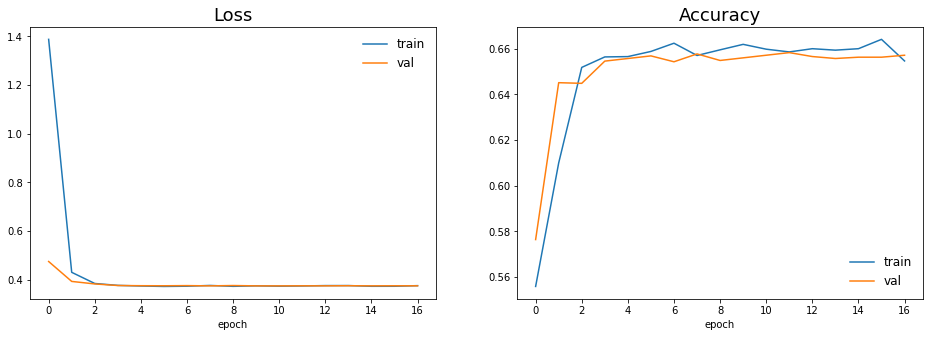

In [112]:
pa.plot_model_history(fitted_model)

**Without thresholds**

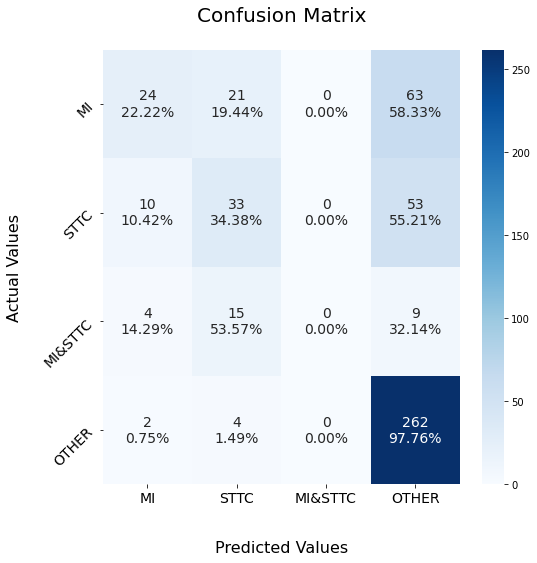

In [113]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

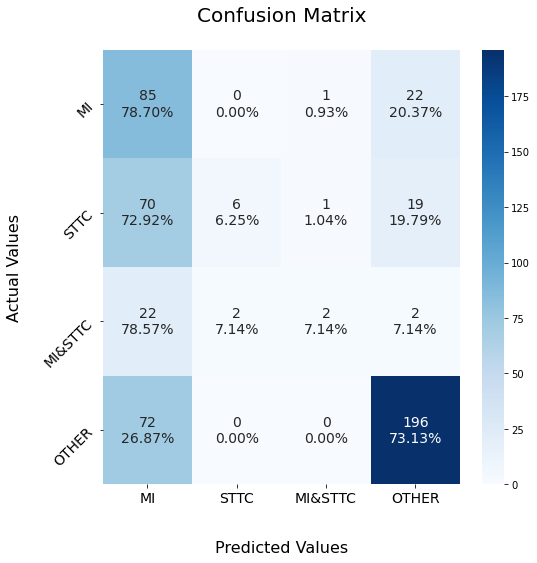

In [114]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Class Weights

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [96]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_cw_lr_1.h5'

Parameters

In [97]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

weights = md.calculating_class_weights(np.array(strat_df.drop(['label'], 1)))

reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1, verbose=1, mode='max',
    min_delta=0.0001, cooldown=0, min_lr=0
)

Load the model if it has been created, else create a new instance of it.

In [98]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
            MaxPool1D(),
            BatchNormalization(),

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [99]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_9 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_7 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 batch_normalization_9 (Batc  (None, 250, 128)         512       
 hNormalization)                                                 
                                                                 
 conv1d_10 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_8 (MaxPooling  (None, 42, 256)          0         
 1D)                                                             
                                                      

In [100]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),
                               class_weight=weights,
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5), reduce_lr])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 9s 33ms/step - loss: 2.8388 - accuracy: 0.4020 - val_loss: 0.6479 - val_accuracy: 0.1749 - lr: 0.0010
Epoch 2/50
217/218 [============================>.] - ETA: 0s - loss: 1.1197 - accuracy: 0.4710
Epoch 2: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
218/218 [==============================] - 8s 36ms/step - loss: 1.1212 - accuracy: 0.4711 - val_loss: 0.6148 - val_accuracy: 0.4768 - lr: 0.0010
Epoch 3/50
217/218 [============================>.] - ETA: 0s - loss: 1.0204 - accuracy: 0.5246
Epoch 3: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
218/218 [==============================] - 8s 36ms/step - loss: 1.0206 - accuracy: 0.5248 - val_loss: 0.4410 - val_accuracy: 0.5827 - lr: 1.0000e-04
Epoch 4/50
217/218 [============================>.] - ETA: 0s - loss: 0.9650 - accuracy: 0.5734
Epoch 4: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
218/218 [======================

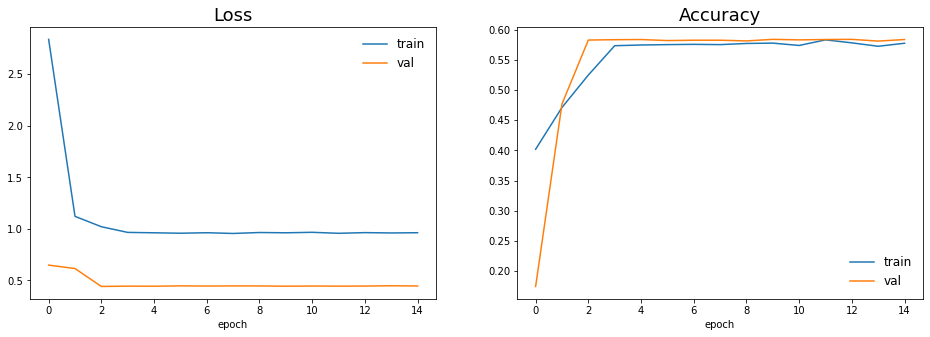

In [101]:
pa.plot_model_history(fitted_model)

**Without thresholds**

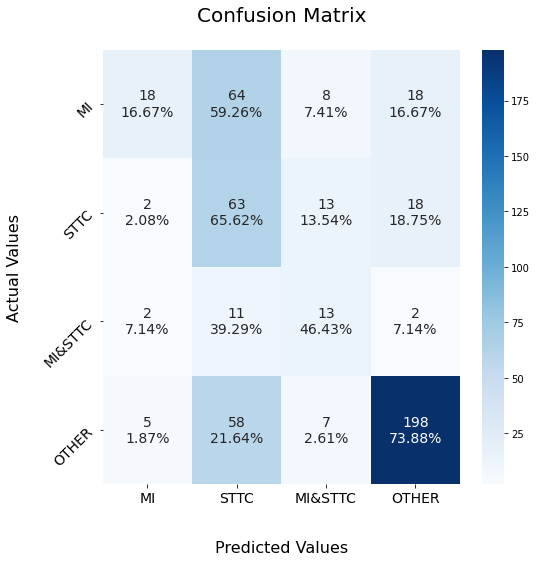

In [102]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

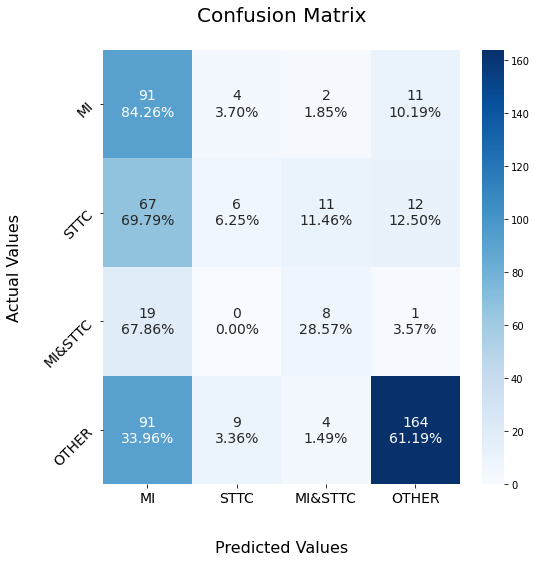

In [104]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Class Weights

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [83]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_cw_1.h5'

Parameters

In [84]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

weights = md.calculating_class_weights(np.array(strat_df.drop(['label'], 1)))

Load the model if it has been created, else create a new instance of it.

In [85]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            MaxPool1D(),
            BatchNormalization(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
            MaxPool1D(),
            BatchNormalization(),            

            Flatten(),
            Dense(d_model, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [86]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_6 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 batch_normalization_6 (Batc  (None, 250, 128)         512       
 hNormalization)                                                 
                                                                 
 conv1d_7 (Conv1D)           (None, 84, 256)           459008    
                                                                 
 max_pooling1d_5 (MaxPooling  (None, 42, 256)          0         
 1D)                                                             
                                                      

In [87]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),  
                               class_weight=weights,
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 7s 28ms/step - loss: 2.8694 - accuracy: 0.2831 - val_loss: 0.5729 - val_accuracy: 0.4888
Epoch 2/50
218/218 [==============================] - 6s 26ms/step - loss: 1.1455 - accuracy: 0.2709 - val_loss: 0.5818 - val_accuracy: 0.1709
Epoch 3/50
218/218 [==============================] - 6s 26ms/step - loss: 1.1566 - accuracy: 0.2406 - val_loss: 0.5887 - val_accuracy: 0.4013
Epoch 4/50
218/218 [==============================] - 6s 29ms/step - loss: 1.1349 - accuracy: 0.2587 - val_loss: 0.5576 - val_accuracy: 0.5710
Epoch 5/50
218/218 [==============================] - 7s 34ms/step - loss: 1.1327 - accuracy: 0.2875 - val_loss: 0.5821 - val_accuracy: 0.1955
Epoch 6/50
218/218 [==============================] - 8s 35ms/step - loss: 1.1325 - accuracy: 0.3689 - val_loss: 0.5468 - val_accuracy: 0.5587
Epoch 7/50
218/218 [==============================] - 8s 35ms/step - loss: 1.1290 - accuracy: 0.4013 - val_loss: 0.5679 - val_accuracy: 0.5243

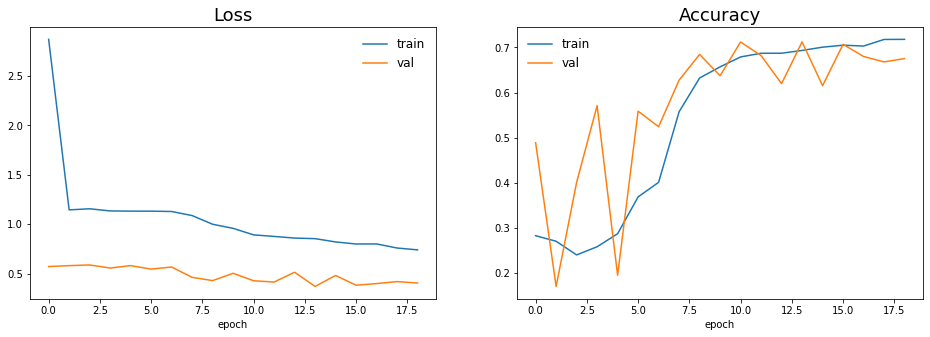

In [93]:
pa.plot_model_history(fitted_model)

In [92]:
fitted_model = pd.DataFrame(fitted_model.history)
fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

**Without thresholds**

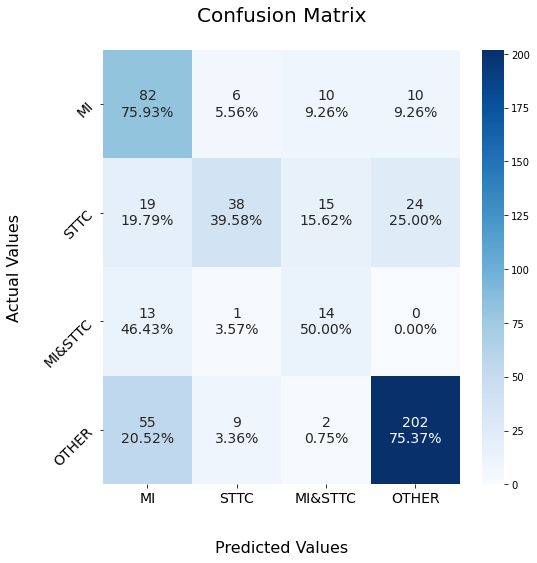

In [94]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

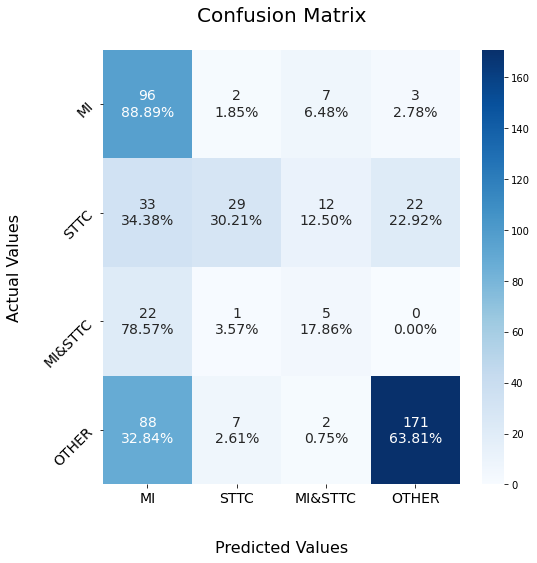

In [95]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Class Weights + Change order of Batch and ReLu

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [58]:
model_id = 'PTB-XL_labels/own/multibinary_bn_l1_cw_2.h5'

Parameters

In [59]:
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

weights = md.calculating_class_weights(np.array(strat_df.drop(['label'], 1)))

Load the model if it has been created, else create a new instance of it.

In [78]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(128, 14, strides=3, padding="same"),
            BatchNormalization(),
            ReLU(),
            MaxPool1D(),        

            Conv1D(256, 14, activation='relu', strides=3, padding="same"),
            BatchNormalization(),
            ReLU(),

            Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
            BatchNormalization(),
            ReLU(),

            Flatten(),
            Dense(64, activation='relu'),
            Dense(4, activation='sigmoid')
        ])

Summary.

In [61]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 batch_normalization_3 (Batc  (None, 500, 128)         512       
 hNormalization)                                                 
                                                                 
 re_lu (ReLU)                (None, 500, 128)          0         
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 conv1d_4 (Conv1D)           (None, 84, 256)           459008    
                                                                 
 batch_normalization_4 (Batc  (None, 84, 256)         

In [62]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),
                               class_weight=weights, 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 9s 32ms/step - loss: 1.2010 - accuracy: 0.5031 - val_loss: 0.5484 - val_accuracy: 0.4379
Epoch 2/50
218/218 [==============================] - 6s 30ms/step - loss: 0.9189 - accuracy: 0.5892 - val_loss: 0.4822 - val_accuracy: 0.5509
Epoch 3/50
218/218 [==============================] - 8s 36ms/step - loss: 0.8813 - accuracy: 0.6215 - val_loss: 0.3922 - val_accuracy: 0.6574
Epoch 4/50
218/218 [==============================] - 9s 40ms/step - loss: 0.8276 - accuracy: 0.6410 - val_loss: 0.4079 - val_accuracy: 0.6354
Epoch 5/50
218/218 [==============================] - 9s 40ms/step - loss: 0.7925 - accuracy: 0.6567 - val_loss: 0.4344 - val_accuracy: 0.6093
Epoch 6/50
218/218 [==============================] - 9s 40ms/step - loss: 0.7428 - accuracy: 0.6769 - val_loss: 0.4396 - val_accuracy: 0.6133
Epoch 7/50
218/218 [==============================] - 9s 40ms/step - loss: 0.7029 - accuracy: 0.6972 - val_loss: 0.4612 - val_accuracy: 0.5987

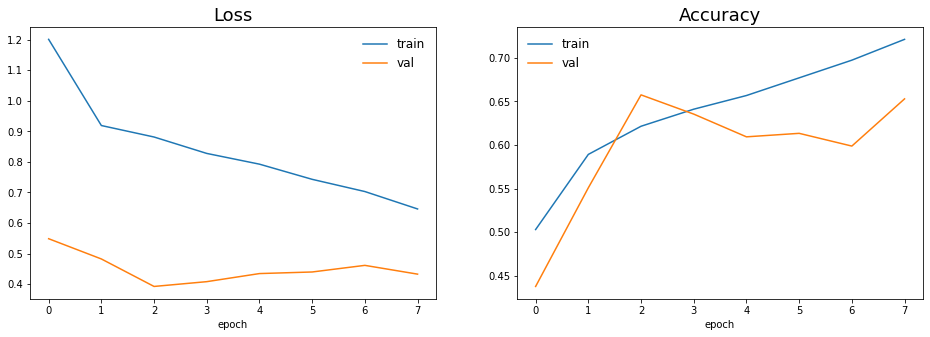

In [80]:
pa.plot_model_history(fitted_model)

**Without thresholds**

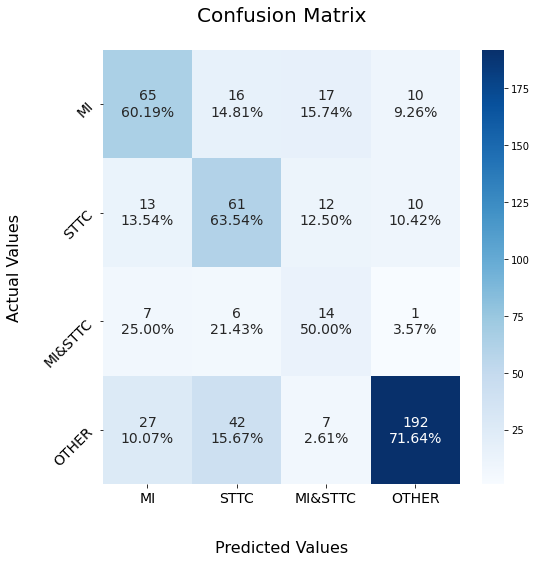

In [81]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

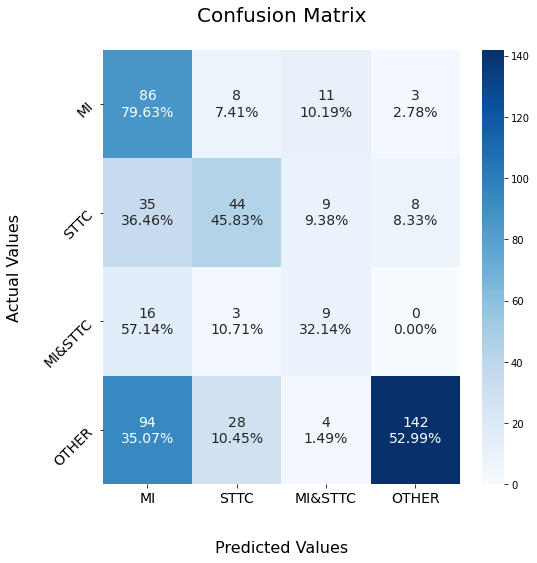

In [82]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

####  Multibinary - https://www.nature.com/articles/s41467-020-15432-4

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [42]:
model_id = 'PTB-XL_labels/antonior92/multibinary_original.h5'

Parameters

In [43]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256

optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [44]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = get_model(4, input_shape=(img_h, img_w))

Summary.

In [45]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 signal (InputLayer)            [(None, 1500, 12)]   0           []                               
                                                                                                  
 conv1d_3 (Conv1D)              (None, 1500, 64)     12288       ['signal[0][0]']                 
                                                                                                  
 batch_normalization_3 (BatchNo  (None, 1500, 64)    256         ['conv1d_3[0][0]']               
 rmalization)                                                                                     
                                                                                                  
 activation (Activation)        (None, 1500, 64)     0           ['batch_normalization_3[0][0]

 dropout_5 (Dropout)            (None, 75, 256)      0           ['activation_6[0][0]']           
                                                                                                  
 conv1d_14 (Conv1D)             (None, 75, 320)      1310720     ['dropout_5[0][0]']              
                                                                                                  
 batch_normalization_10 (BatchN  (None, 75, 320)     1280        ['conv1d_14[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_7 (Activation)      (None, 75, 320)      0           ['batch_normalization_10[0][0]'] 
                                                                                                  
 dropout_6 (Dropout)            (None, 75, 320)      0           ['activation_7[0][0]']           
          

In [46]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                               
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 204s 915ms/step - loss: 0.4001 - accuracy: 0.6498 - val_loss: 0.3508 - val_accuracy: 0.7029
Epoch 2/50
218/218 [==============================] - 333s 2s/step - loss: 0.3205 - accuracy: 0.7258 - val_loss: 0.3062 - val_accuracy: 0.7490
Epoch 3/50
218/218 [==============================] - 345s 2s/step - loss: 0.2909 - accuracy: 0.7488 - val_loss: 0.2939 - val_accuracy: 0.7444
Epoch 4/50
218/218 [==============================] - 354s 2s/step - loss: 0.2745 - accuracy: 0.7618 - val_loss: 0.2678 - val_accuracy: 0.7748
Epoch 5/50
218/218 [==============================] - 339s 2s/step - loss: 0.2603 - accuracy: 0.7802 - val_loss: 0.2840 - val_accuracy: 0.7650
Epoch 6/50
218/218 [==============================] - 313s 1s/step - loss: 0.2475 - accuracy: 0.7898 - val_loss: 0.2780 - val_accuracy: 0.7705
Epoch 7/50
218/218 [==============================] - 387s 2s/step - loss: 0.2417 - accuracy: 0.7968 - val_loss: 0.2650 - val_accuracy: 0.7

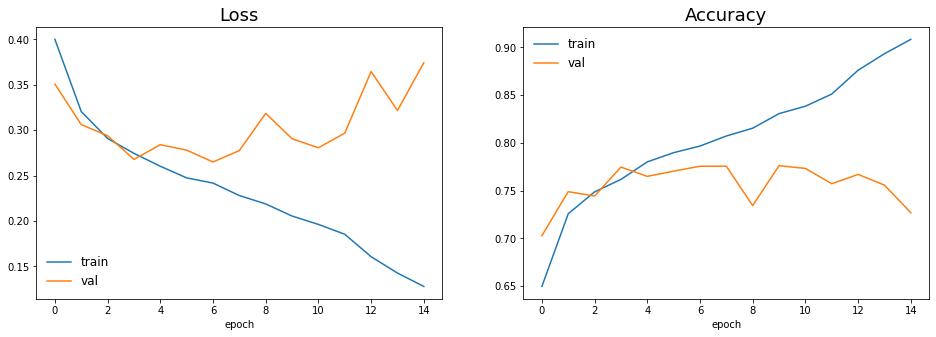

In [47]:
pa.plot_model_history(fitted_model)

**Without thresholds**

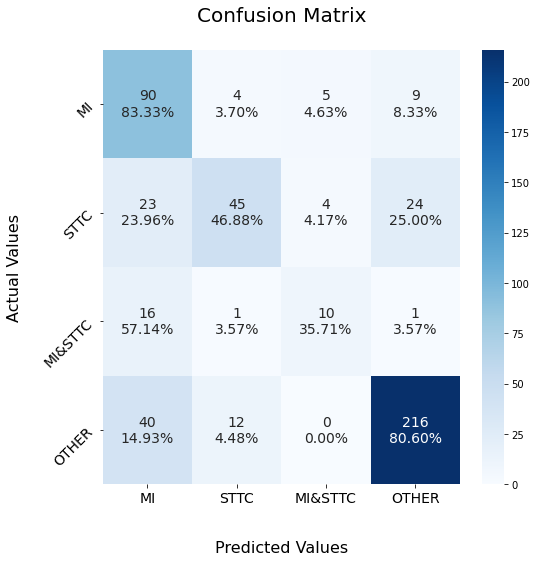

In [48]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

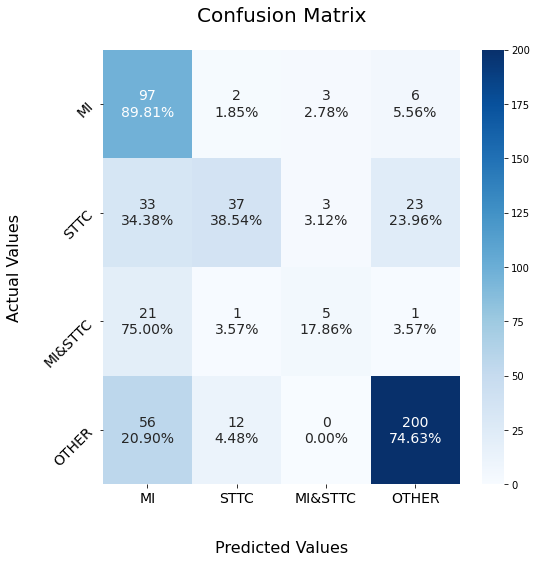

In [49]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - https://www.nature.com/articles/s41467-020-15432-4 + Weights + ReduceRL

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [57]:
model_id = 'PTB-XL_labels/antonior92/multibinary_cw_lr.h5'

Parameters

In [58]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

weights = md.calculating_class_weights(np.array(strat_df.drop(['label'], 1)))

reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1, verbose=1, mode='max',
    min_delta=0.0001, cooldown=0, min_lr=0
)

Load the model if it has been created, else create a new instance of it.

In [59]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = get_model(4, input_shape=(img_h, img_w))

Summary.

In [60]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 signal (InputLayer)            [(None, 1500, 12)]   0           []                               
                                                                                                  
 conv1d_16 (Conv1D)             (None, 1500, 64)     12288       ['signal[0][0]']                 
                                                                                                  
 batch_normalization_12 (BatchN  (None, 1500, 64)    256         ['conv1d_16[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_9 (Activation)      (None, 1500, 64)     0           ['batch_normalization_12[0]

 dropout_13 (Dropout)           (None, 75, 256)      0           ['activation_15[0][0]']          
                                                                                                  
 conv1d_27 (Conv1D)             (None, 75, 320)      1310720     ['dropout_13[0][0]']             
                                                                                                  
 batch_normalization_19 (BatchN  (None, 75, 320)     1280        ['conv1d_27[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 activation_16 (Activation)     (None, 75, 320)      0           ['batch_normalization_19[0][0]'] 
                                                                                                  
 dropout_14 (Dropout)           (None, 75, 320)      0           ['activation_16[0][0]']          
          

In [61]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),
                               class_weight=weights,
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5), reduce_lr])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 63s 280ms/step - loss: 1.0723 - accuracy: 0.5305 - val_loss: 0.4443 - val_accuracy: 0.6308 - lr: 0.0010
Epoch 2/50
218/218 [==============================] - 79s 362ms/step - loss: 0.8776 - accuracy: 0.6320 - val_loss: 0.4545 - val_accuracy: 0.5922 - lr: 0.0010
Epoch 3/50
218/218 [==============================] - ETA: 0s - loss: 0.7828 - accuracy: 0.6755
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
218/218 [==============================] - 79s 362ms/step - loss: 0.7828 - accuracy: 0.6755 - val_loss: 0.3127 - val_accuracy: 0.7321 - lr: 0.0010
Epoch 4/50
218/218 [==============================] - ETA: 0s - loss: 0.6635 - accuracy: 0.7284
Epoch 4: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
218/218 [==============================] - 101s 462ms/step - loss: 0.6635 - accuracy: 0.7284 - val_loss: 0.2916 - val_accuracy: 0.7387 - lr: 1.0000e-04
Epoch 5/50
218/218 [===================

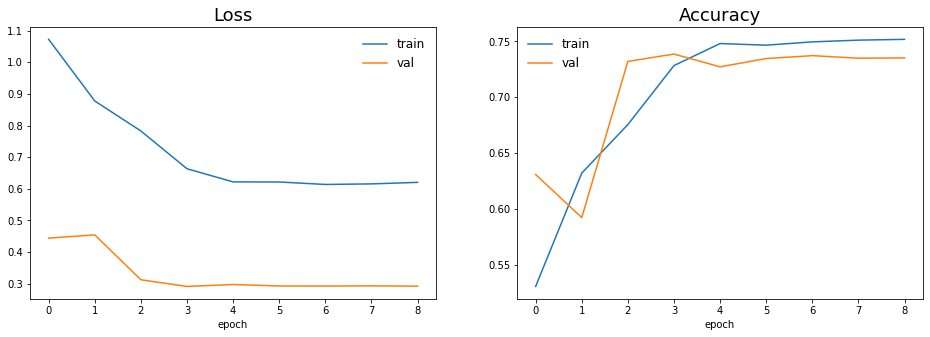

In [62]:
pa.plot_model_history(fitted_model)

**Without thresholds**

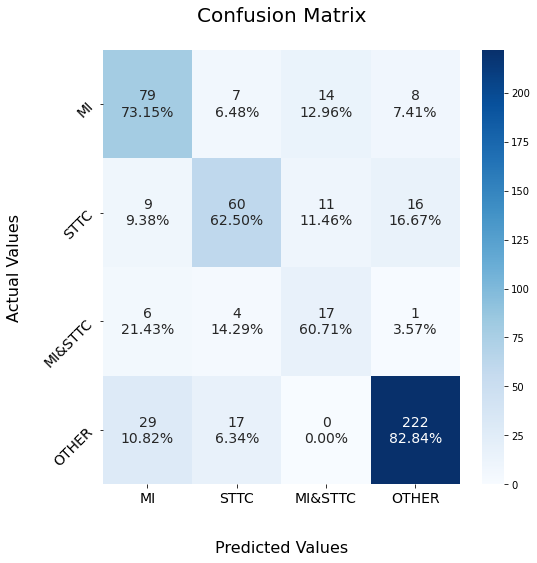

In [63]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

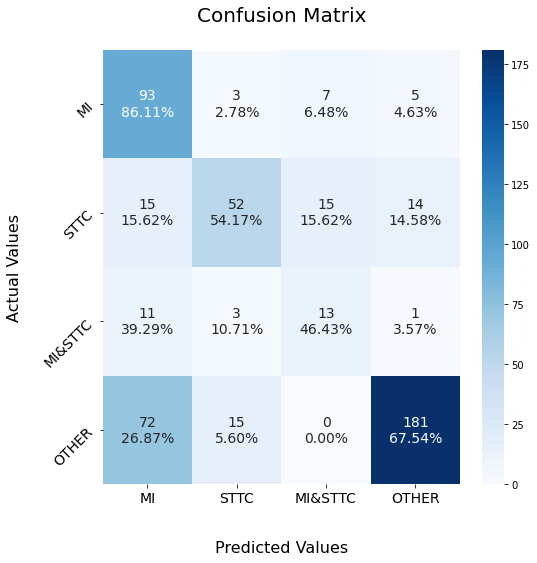

In [64]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multi-label

# =============================================================

In [261]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]

optimizer = 'adam'

In [137]:
CNN = Sequential([
    InputLayer(input_shape=(img_h, img_w)),
    
    Conv1D(128, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),
    BatchNormalization(),

    Conv1D(256, 14, activation='relu', strides=3, padding="same"),
    MaxPool1D(),
    BatchNormalization(),

    Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.01)),
    MaxPool1D(),
    BatchNormalization(),

    #Conv1D(64, 3, activation='relu'),
    #MaxPool2D(),

    Flatten(),
    Dense(d_model, activation='relu'),
    Dense(4, activation='softmax')
])

CNN.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_9 (Conv1D)           (None, 500, 128)          21632     
                                                                 
 max_pooling1d_9 (MaxPooling  (None, 250, 128)         0         
 1D)                                                             
                                                                 
 batch_normalization_9 (Batc  (None, 250, 128)         512       
 hNormalization)                                                 
                                                                 
 conv1d_10 (Conv1D)          (None, 84, 256)           459008    
                                                                 
 max_pooling1d_10 (MaxPoolin  (None, 42, 256)          0         
 g1D)                                                            
                                                      

In [138]:
# Compile: Define training parameters
CNN.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Train model
epochs = 50
batches = n_total_train//batch_size

### Following line overflows memory
fitted_model = CNN.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                       epochs=epochs, validation_data=(val_set_x, val_set_y),
                       callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])

Epoch 1/50
218/218 [==============================] - 7s 28ms/step - loss: 3.0669 - accuracy: 0.5601 - val_loss: 1.3019 - val_accuracy: 0.5756
Epoch 2/50
218/218 [==============================] - 6s 26ms/step - loss: 0.9750 - accuracy: 0.6380 - val_loss: 0.9421 - val_accuracy: 0.6571
Epoch 3/50
218/218 [==============================] - 6s 26ms/step - loss: 0.8521 - accuracy: 0.6915 - val_loss: 0.8371 - val_accuracy: 0.6998
Epoch 4/50
218/218 [==============================] - 6s 27ms/step - loss: 0.8038 - accuracy: 0.7141 - val_loss: 0.8647 - val_accuracy: 0.6703
Epoch 5/50
218/218 [==============================] - 6s 29ms/step - loss: 0.7594 - accuracy: 0.7228 - val_loss: 0.7796 - val_accuracy: 0.7075
Epoch 6/50
218/218 [==============================] - 7s 33ms/step - loss: 0.7351 - accuracy: 0.7384 - val_loss: 0.7474 - val_accuracy: 0.7272
Epoch 7/50
218/218 [==============================] - 7s 34ms/step - loss: 0.7237 - accuracy: 0.7409 - val_loss: 0.7451 - val_accuracy: 0.7281

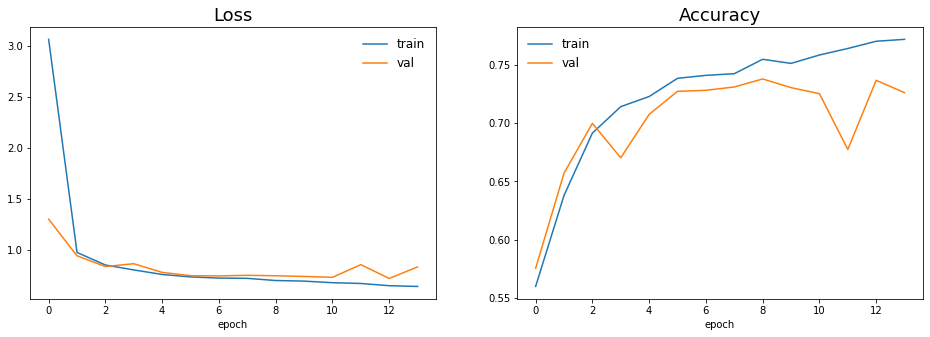

In [139]:
pa.plot_model_history(fitted_model)

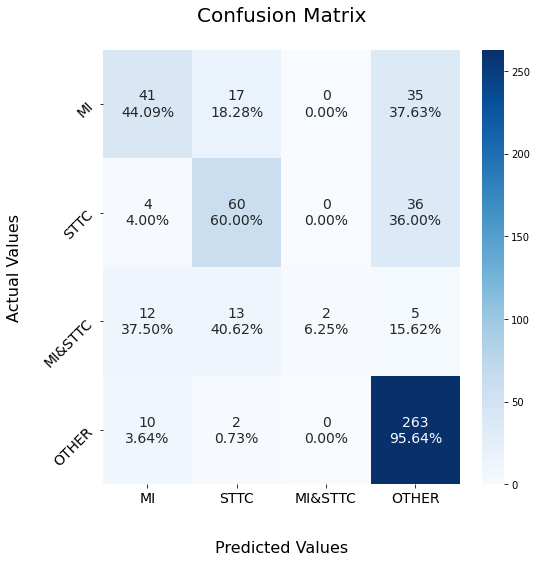

In [140]:
pa.plot_confusion_matrix(CNN, train_set_x, train_set_y, strat_df.columns[:-1], n_ex = n_ex, random_state = random_state)

# ----------------------------------------------------------------------------------------------------------

# =============================================================

## PTB-XL Superclasses (Train with 5 seconds, predict with 3)

# =============================================================

# ----------------------------------------------------------------------------------------------------------

### Loading Superclasses

Read the previously calculated DF:

In [193]:
superclasses_df = pd.read_csv('data/PTB-XL/Y_superclasses.csv', index_col=0)

We are mostly interested in the MI and STTC classes. For this reason, we OHE so that we have mutually exclusive columns for:

    i. MI (no STTC)
    ii. STTC (no MI)
    iii MI & STTC
    iv. Other

In [194]:
# Copy and keep only the classes of interest
strat_df = superclasses_df.copy()
strat_df = strat_df.reset_index()
strat_df.index = strat_df.index + 1
strat_df = strat_df[['MI', 'STTC']]

# Intersection between MI & STTC
strat_df['MI&STTC'] = (strat_df['MI'] == 1) & (strat_df['STTC'] == 1)
strat_df['MI&STTC'] = strat_df['MI&STTC'].astype(int)

# Correct MI and STTC columns given an intersection
strat_df['MI'] = strat_df['MI'] - strat_df['MI&STTC']
strat_df['STTC'] = strat_df['STTC'] - strat_df['MI&STTC']

# Create the OTHER column as the complement
strat_df['OTHER'] = (strat_df['MI'] == 0) & (strat_df['STTC'] == 0) & (strat_df['MI&STTC'] == 0)
strat_df['OTHER'] = strat_df['OTHER'].astype(int)

# Add a label column 
strat_df['label'] = strat_df.idxmax(axis=1)
print(strat_df.shape)
strat_df.head()

(21837, 5)


,MI,STTC,MI&STTC,OTHER,label
1,0,0,0,1,OTHER
2,0,0,0,1,OTHER
3,0,0,0,1,OTHER
4,0,0,0,1,OTHER
5,0,0,0,1,OTHER


### Train, Validation & Test

We first reduce the length of the signals since it would be too computationally costly otherwise atm.

In [195]:
# Notice that this way to cut currently works only for PTB-XL, since all records are the of
# the same duration and frequency sampling

cut = 0.5
X_cut = X[:, :int(train_cut * X.shape[1]), :]

Define the proportions for each set.

In [196]:
val_size = 0.2
test_size = 0.2

Define the indices so that we can recover them later

In [197]:
indices = np.arange(len(X_cut))

Retrieve the train, validation and test sets for:

    x : The signals
    y : The labels
    idx : The indices of the original X and Y
    age_n_sex : The age and sex

In [198]:
# Train and test
train_set_x, test_set_x = train_test_split(X_cut, test_size=test_size, random_state=random_state)
train_set_y, test_set_y = train_test_split(strat_df.drop(['label'], 1), test_size=test_size, random_state=random_state)
train_set_idx, test_set_idx = train_test_split(indices, test_size=test_size, random_state=random_state)

# Train and val
train_set_x, val_set_x = train_test_split(train_set_x, test_size=val_size, random_state=random_state)
train_set_y, val_set_y = train_test_split(train_set_y, test_size=val_size, random_state=random_state)
train_set_idx, val_set_idx = train_test_split(train_set_idx, test_size=test_size, random_state=random_state)

# Get the age and sex given the indices
train_set_age_n_sex, mean_age = md.age_and_sex_set(Y, train_set_idx)
val_set_age_n_sex = md.age_and_sex_set(Y, val_set_idx, mean_age)
test_set_age_n_sex = md.age_and_sex_set(Y, test_set_idx, mean_age)

n_total_train = train_set_x.shape[0]
batches = n_total_train//batch_size

train_set_y = np.array(train_set_y)
val_set_y = np.array(val_set_y)
test_set_y = np.array(test_set_y)

Verify if the total amount of values for each set is adequate

In [199]:
print(train_set_y.shape)
print(val_set_y.shape)
print(test_set_y.shape)

(13975, 4)
(3494, 4)
(4368, 4)


### Add zeros in the first and last seconds of validation and test sets

In [200]:
val_test_cut = 0.3 / cut 
val_set_x = md.pad_zeros_before_n_after(val_set_x, val_test_cut)
test_set_x = md.pad_zeros_before_n_after(test_set_x, val_test_cut)

Verify the dimensions are the same.

In [201]:
print(train_set_y.shape)
print(val_set_y.shape)
print(test_set_y.shape)

(13975, 4)
(3494, 4)
(4368, 4)


Verify the age and sex were correctly processed. 

### Note: At the moment, we are only using PTB-XL. When we use the other datasets, there is no guarantee that the preprocessing for age and sex will be the same.

In [147]:
Y.iloc[train_set_idx][['age', 'sex']].head()

,age,sex
5000,69,Male
16835,67,Female
12356,49,Female
3450,24,Male
10222,63,Male


In [148]:
train_set_age_n_sex[:5]

array([[69,  1],
       [67,  0],
       [49,  0],
       [24,  1],
       [63,  1]], dtype=int64)

We verify that we have a stratified distribution of labels inthe 3 sets.

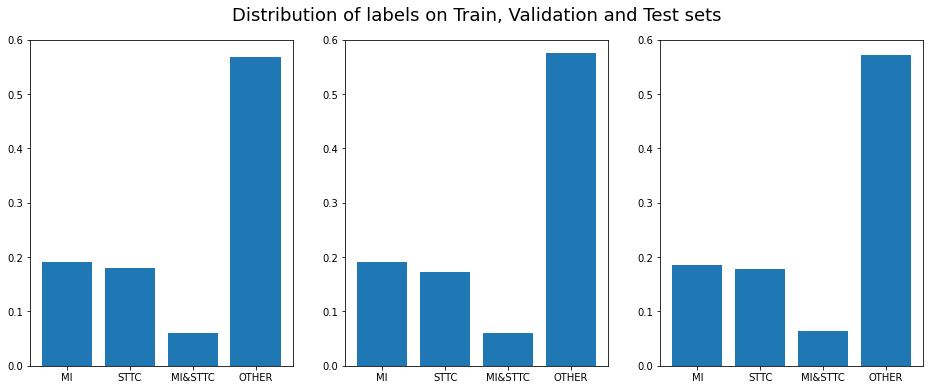

In [151]:
fig, axs = plt.subplots(1,3, figsize = (16,6))
axs[0].bar(strat_df.columns[:-1], train_set_y.sum(0) /  train_set_y.sum(), )
axs[1].bar(strat_df.columns[:-1], val_set_y.sum(0) /  val_set_y.sum())
axs[2].bar(strat_df.columns[:-1], test_set_y.sum(0) /  test_set_y.sum())
[ax.set_ylim(0,0.6) for ax in axs]

axs[1].set_title('Distribution of labels on Train, Validation and Test sets', y = 1.04, fontsize=18);

# =============================================================

### CNN Implementation

# =============================================================

#### Multibinary - Simplest model

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [152]:
model_id = 'PTB-XL_labels/own/5-3/multibinary_1.h5'

Parameters

In [153]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [154]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    model = Sequential([
            InputLayer(input_shape=(img_h, img_w)),

            Conv1D(64, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Conv1D(128, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Conv1D(256, 3, activation='relu', strides=1, padding="same"),
            MaxPool1D(),

            Flatten(),
            Dense(128, activation='relu'),
            Dense(4, activation='sigmoid')
])

Summary.

In [155]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 2500, 64)          2368      
                                                                 
 max_pooling1d (MaxPooling1D  (None, 1250, 64)         0         
 )                                                               
                                                                 
 conv1d_1 (Conv1D)           (None, 1250, 128)         24704     
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 625, 128)         0         
 1D)                                                             
                                                                 
 conv1d_2 (Conv1D)           (None, 625, 256)          98560     
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 312, 256)         0

In [156]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit(train_set_x, train_set_y, steps_per_epoch=batches,
                               epochs=epochs, validation_data=(val_set_x, val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=5)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/50
218/218 [==============================] - 21s 46ms/step - loss: 0.4497 - accuracy: 0.6090 - val_loss: 0.3786 - val_accuracy: 0.6468
Epoch 2/50
218/218 [==============================] - 8s 38ms/step - loss: 0.3297 - accuracy: 0.7047 - val_loss: 0.3562 - val_accuracy: 0.6726
Epoch 3/50
218/218 [==============================] - 10s 44ms/step - loss: 0.2864 - accuracy: 0.7498 - val_loss: 0.3773 - val_accuracy: 0.6425
Epoch 4/50
218/218 [==============================] - 10s 47ms/step - loss: 0.2452 - accuracy: 0.7898 - val_loss: 0.3974 - val_accuracy: 0.6471
Epoch 5/50
218/218 [==============================] - 10s 47ms/step - loss: 0.1858 - accuracy: 0.8516 - val_loss: 0.4500 - val_accuracy: 0.6417
Epoch 6/50
218/218 [==============================] - 10s 47ms/step - loss: 0.1217 - accuracy: 0.9153 - val_loss: 0.7017 - val_accuracy: 0.5655
Epoch 7/50
218/218 [==============================] - 10s 47ms/step - loss: 0.0742 - accuracy: 0.9601 - val_loss: 0.7634 - val_accuracy: 

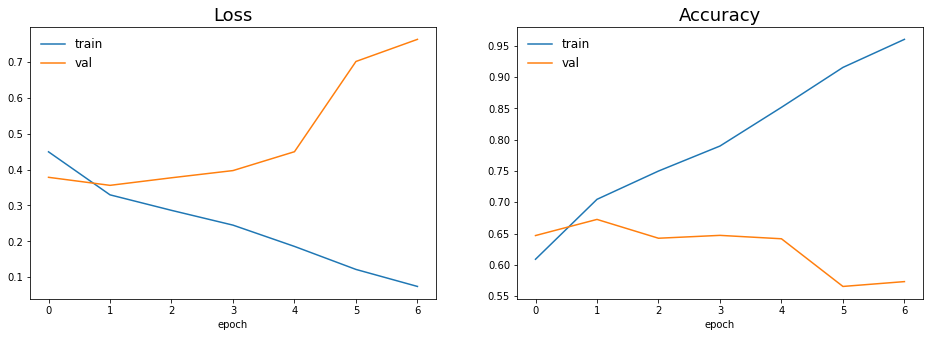

In [157]:
pa.plot_model_history(fitted_model)

**Without thresholds**

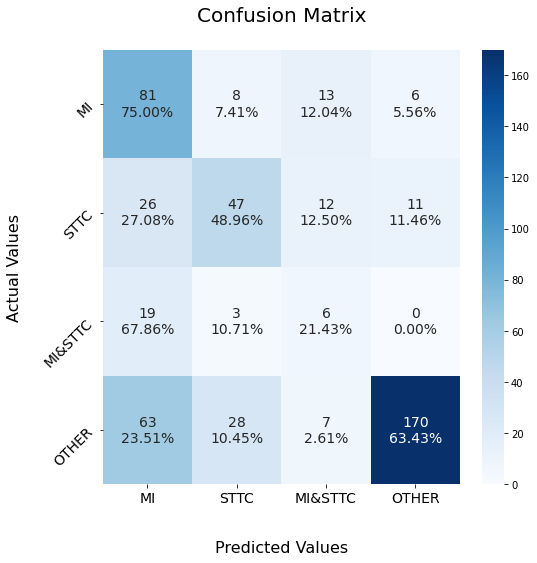

In [158]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

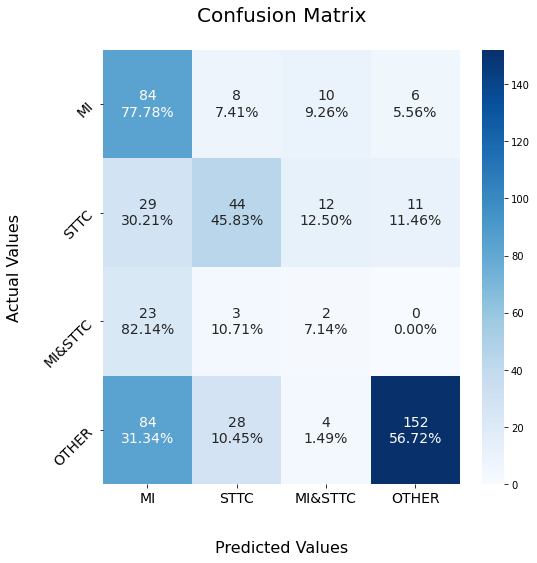

In [159]:
pa.plot_confusion_matrix(model, test_set_x, test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# =============================================================

#### Multibinary - Adding different Kernel and Stride Sizes + BatchNormalization + L1 Regularizer + Dropout + Age + Sex

# =============================================================

Define the model id. This must be different from any other since we are not overwritting.

In [202]:
model_id = 'PTB-XL_labels/own/5-3/multibinary_bn_l1_dr_as_1.h5'

Parameters

In [203]:
batch_size = 64
img_h = X_cut.shape[1]
img_w = X_cut.shape[2]
d_model = 256
optimizer = 'adam'

Load the model if it has been created, else create a new instance of it.

In [204]:
found = False

for path, currentDirectory, files in os.walk("models"):
    for file in files:
        if 'models/' + model_id == os.path.join(path, file).replace("\\", "/"):  
            
            model = tf.keras.models.load_model('models/' + model_id)
            fitted_model = pd.read_csv('models/' + model_id[:-2] + 'csv', index_col=0)
            
            found = True

if not found:
    pa.make_dir('./models/' + '/'.join(model_id.split('/')[:-1]))
    
    ### Convolutional Model
    conv_input = Input(shape=(img_h, img_w))

    x = Conv1D(128, 14, activation='relu', strides=3, padding="same")(conv_input)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(256, 14, activation='relu', strides=3, padding="same")(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(d_model, 10, activation='relu', strides=2, padding="same")(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Conv1D(d_model, 10, activation='relu', strides=2, padding="same", activity_regularizer=L1(l1=0.006))(x)
    x = MaxPool1D()(x)
    x = Dropout(rate=0.3)(x)
    x = BatchNormalization()(x)

    x = Flatten()(x)

    x = Model(inputs = conv_input, outputs = x)
    
    
    ### Age and Sex Model
    wide_input = Input(shape=(2,))    
    y = Dense(10, activation='relu')(wide_input)    
    y = Model(inputs = wide_input, outputs = y)
    
    
    ### Combined Model
    combined = concatenate([x.output, y.output])
    z = Dense(d_model, activation='relu')(combined)
    z = Dense(4, activation='sigmoid')(z)

    model = Model(inputs=[x.input, y.input], outputs=z)

Summary.

In [205]:
model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 2500, 12)]   0           []                               
                                                                                                  
 conv1d_7 (Conv1D)              (None, 834, 128)     21632       ['input_4[0][0]']                
                                                                                                  
 max_pooling1d_7 (MaxPooling1D)  (None, 417, 128)    0           ['conv1d_7[0][0]']               
                                                                                                  
 dropout_4 (Dropout)            (None, 417, 128)     0           ['max_pooling1d_7[0][0]']        
                                                                                            

In [206]:
if not found:

    # Compile
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])

    # Train
    fitted_model = model.fit((train_set_x, train_set_age_n_sex), train_set_y, steps_per_epoch=batches,
                               epochs=100, validation_data=((val_set_x, val_set_age_n_sex), val_set_y),                                 
                               callbacks=[EarlyStopping(monitor='val_accuracy', patience=15)])
    
    # Save
    model.save('models/' + model_id)
    
    fitted_model = pd.DataFrame(fitted_model.history)
    fitted_model.to_csv('models/' + model_id[:-2] + 'csv')

Epoch 1/100
218/218 [==============================] - 20s 77ms/step - loss: 0.8944 - accuracy: 0.5467 - val_loss: 0.5638 - val_accuracy: 0.5753
Epoch 2/100
218/218 [==============================] - 16s 74ms/step - loss: 0.4581 - accuracy: 0.5630 - val_loss: 0.4548 - val_accuracy: 0.5750
Epoch 3/100
218/218 [==============================] - 15s 71ms/step - loss: 0.4446 - accuracy: 0.5758 - val_loss: 0.4152 - val_accuracy: 0.5873
Epoch 4/100
218/218 [==============================] - 16s 72ms/step - loss: 0.4139 - accuracy: 0.6115 - val_loss: 0.3973 - val_accuracy: 0.6239
Epoch 5/100
218/218 [==============================] - 16s 71ms/step - loss: 0.3956 - accuracy: 0.6345 - val_loss: 0.3919 - val_accuracy: 0.6388
Epoch 6/100
218/218 [==============================] - 16s 72ms/step - loss: 0.3882 - accuracy: 0.6424 - val_loss: 0.4780 - val_accuracy: 0.4946
Epoch 7/100
218/218 [==============================] - 16s 73ms/step - loss: 0.3758 - accuracy: 0.6658 - val_loss: 0.4000 - val_ac

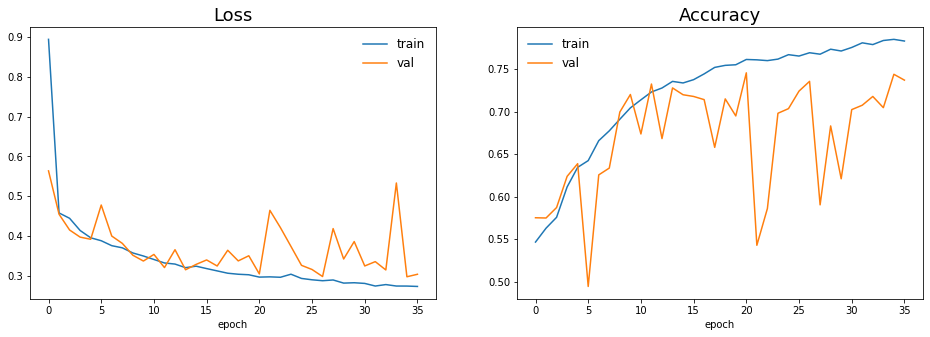

In [207]:
pa.plot_model_history(fitted_model)

**Without thresholds**

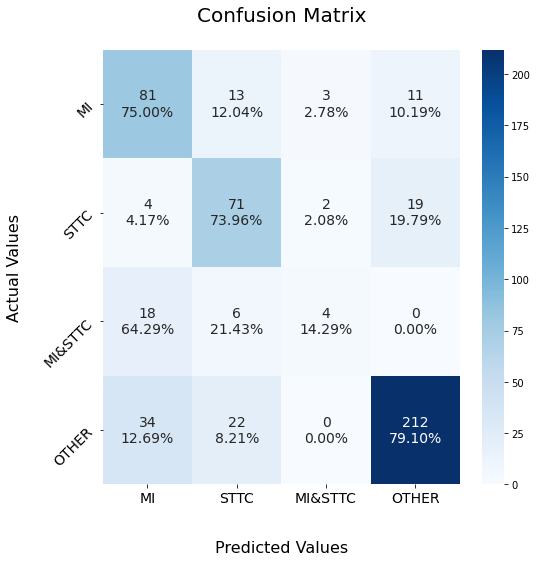

In [210]:
pa.plot_confusion_matrix(model, (test_set_x, test_set_age_n_sex), test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state)

**With thresholds**

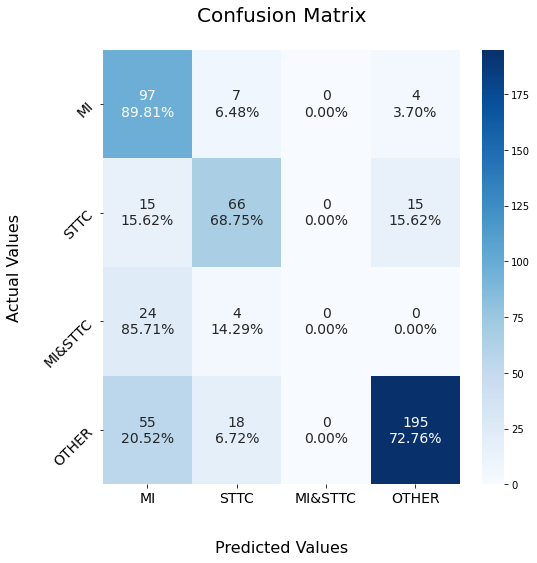

In [211]:
pa.plot_confusion_matrix(model, (test_set_x, test_set_age_n_sex), test_set_y, strat_df.columns[:-1], n_ex = n_ex, 
                         random_state = random_state, thresholds = thresholds)

# PyTorch

Since some of the best models in the Physionet Challenge run with PyTorch, we will try to implement some ideas here to be more familiarized with the structure.

#### Multibinary (PyTorch)

In [ ]:
# CNN = Sequential([
#     InputLayer(input_shape=(img_h, img_w)),
    
#     Conv1D(64, 3, activation='relu', strides=1, padding="same"),
#     MaxPool1D(),

#     Conv1D(128, 3, activation='relu', strides=1, padding="same"),
#     MaxPool1D(),

#     Conv1D(256, 3, activation='relu', strides=1, padding="same"),
#     MaxPool1D(),

#     Flatten(),
#     Dense(128, activation='relu'),
#     Dense(4, activation='sigmoid')
# ])

# CNN.summary()

In [232]:
PT_CNN = nn.Sequential(
        nn.Conv1d(12, 64, kernel_size=3, stride=1, padding=0),
        nn.ReLU(inplace=True),
        nn.MaxPool1d(kernel_size=2),
        
        nn.Conv1d(64, 128, kernel_size=3, stride=1, padding=0),
        nn.ReLU(inplace=True),
        nn.MaxPool1d(kernel_size=2),
        
        nn.Conv1d(128, 256, kernel_size=3, stride=1, padding=0),
        nn.ReLU(inplace=True),
        nn.MaxPool1d(kernel_size=2),
    
        nn.Flatten(),
        nn.Linear(256, 128),
        nn.ReLU(inplace=True),
        nn.Linear(128, 4),
        nn.Sigmoid()

    )

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
PT_CNN = PT_CNN.to(device)

In [233]:
print(PT_CNN)

Sequential(
  (0): Conv1d(12, 64, kernel_size=(3,), stride=(1,))
  (1): ReLU(inplace=True)
  (2): MaxPool1d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (3): Conv1d(64, 128, kernel_size=(3,), stride=(1,))
  (4): ReLU(inplace=True)
  (5): MaxPool1d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (6): Conv1d(128, 256, kernel_size=(3,), stride=(1,))
  (7): ReLU(inplace=True)
  (8): MaxPool1d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (9): Flatten(start_dim=1, end_dim=-1)
  (10): Linear(in_features=256, out_features=128, bias=True)
  (11): ReLU(inplace=True)
  (12): Linear(in_features=128, out_features=4, bias=True)
  (13): Sigmoid()
)


In [260]:
import torch.optim as optim

criterion = nn.BCELoss()
optimizer_ = optim.Adam(PT_CNN.parameters(), lr=0.001)

In [236]:
train_set_x[:5].shape

(5, 1500, 12)

In [240]:
torch.rand((1, 1, 28, 28)).numpy()

array([[[[0.07850492, 0.7071954 , 0.4410476 , 0.62976867, 0.96928436,
          0.03754109, 0.88383985, 0.45030224, 0.53081346, 0.2672997 ,
          0.27991247, 0.31832224, 0.04732007, 0.78439945, 0.01587111,
          0.0967235 , 0.7041161 , 0.8732855 , 0.68786085, 0.947271  ,
          0.5994733 , 0.40782785, 0.8676642 , 0.4896505 , 0.48018825,
          0.57564515, 0.67646456, 0.01002741],
         [0.8176576 , 0.8441457 , 0.737309  , 0.1428402 , 0.21607089,
          0.2469173 , 0.29752153, 0.77747697, 0.814424  , 0.9364723 ,
          0.3001573 , 0.77605027, 0.73736125, 0.06819248, 0.9039592 ,
          0.41613513, 0.9617667 , 0.34523332, 0.27729225, 0.380149  ,
          0.7422409 , 0.49301773, 0.14055306, 0.34430975, 0.41086644,
          0.48338288, 0.44448346, 0.94969976],
         [0.36642337, 0.32404476, 0.5269145 , 0.85006505, 0.24958557,
          0.8627256 , 0.4346696 , 0.44943482, 0.7465017 , 0.31090033,
          0.8922697 , 0.36361015, 0.8156876 , 0.1396488 , 0.792422

In [234]:
PT_CNN(torch.from_numpy(train_set_x[:5]))

RuntimeError: Given groups=1, weight of size [64, 12, 3], expected input[5, 1500, 12] to have 12 channels, but got 1500 channels instead

# Normales

In [381]:
outliers

,outlier
179,True
291,True
420,True
472,True
515,True
...,...
21590,True
21600,True
21716,True
21816,True


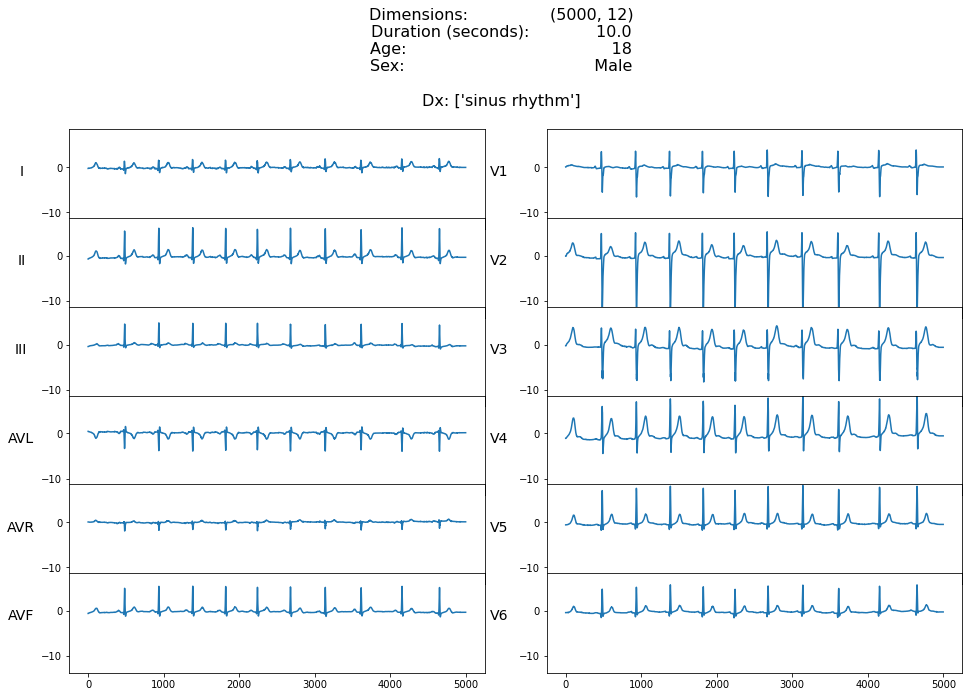

In [389]:
k = 150
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [396]:
s = 6
y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [397]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=5, analysis=True)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed)

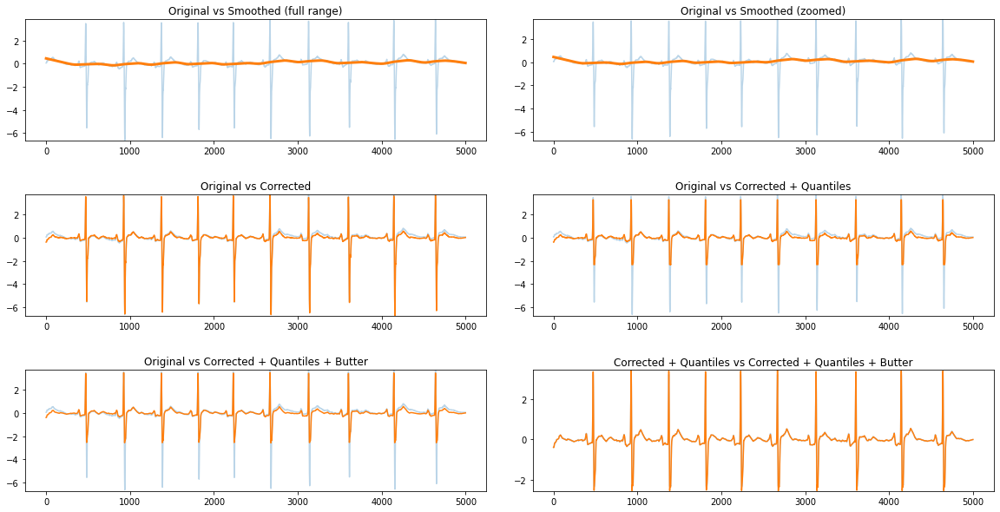

In [398]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

# Atrial Fibrillation

In [118]:
af = 164889003
Y_af = Y_df[Y_df[af] > 0]

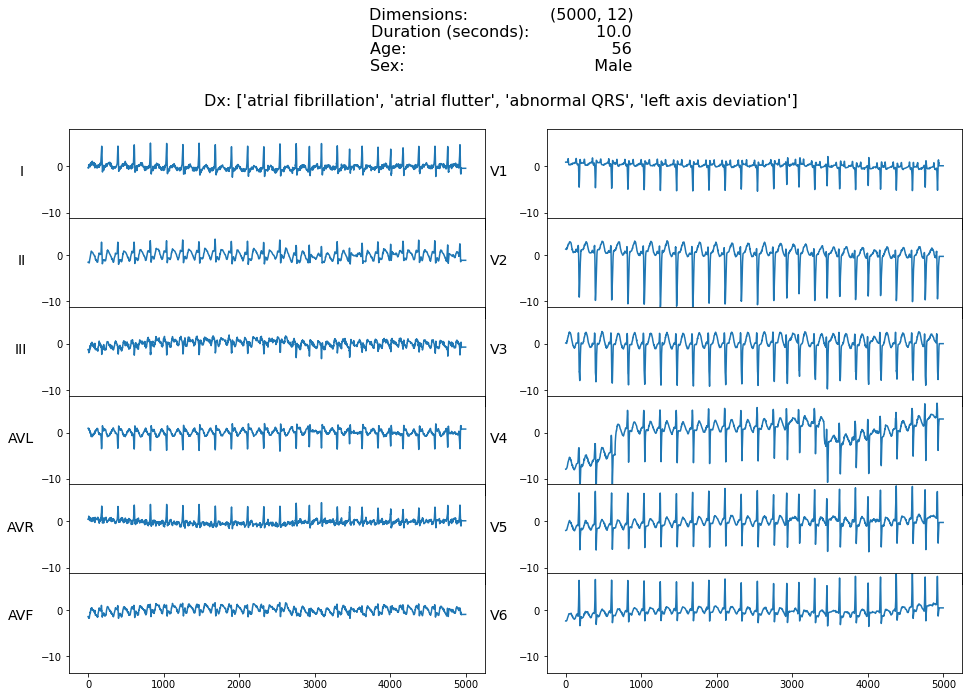

In [119]:
k = Y_af.index[0]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [120]:
s = 9
y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [142]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=5, analysis=True)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.03)

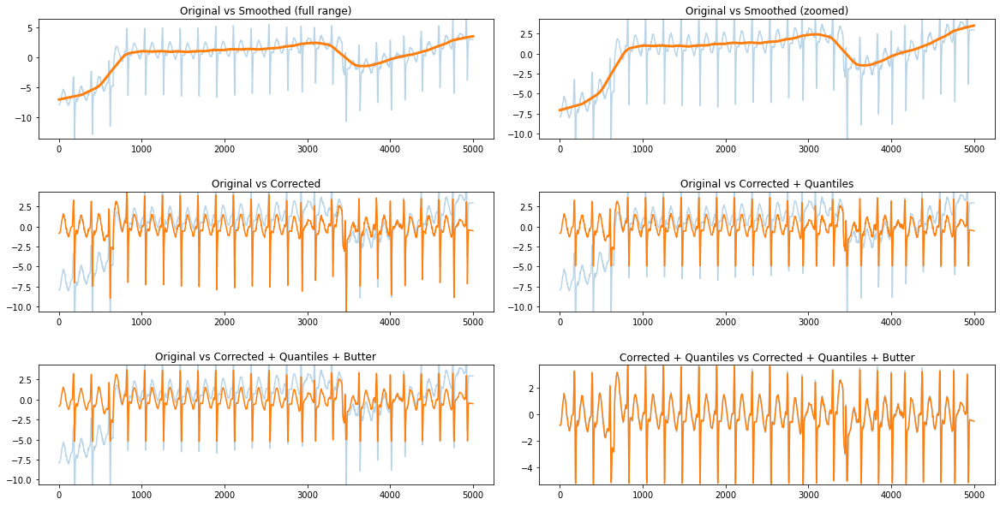

In [143]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [292]:
s = 5
y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [293]:
y_smoothed = md.smooth_ecg_signal(x, y, std_threshold=5)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed)

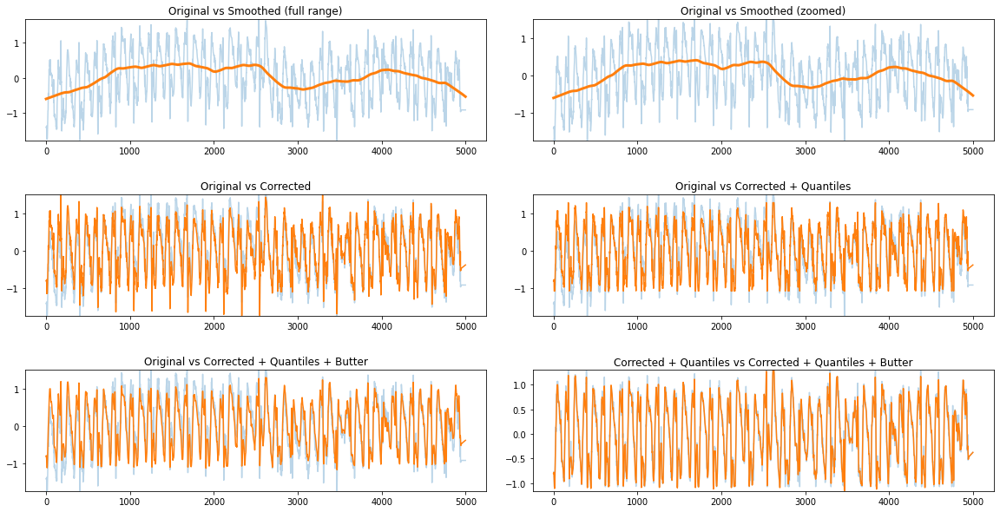

In [294]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

# Processing Data

In this section we aim to correct several aspects of the ECG signals. Given different circumstances, like spikes in the electrical current, muscle spasms, overall white noise, etc., some signals show unexpected behaviours. These make it harder for the model to properly train, since it finds non dx related patterns and tries to make sense of them.

At the moment, we have managed to fix a few certain signals, but the process is still too manual. We have to find a way to automatize it based on observed statistics and patterns of each signal, along with the other 11 ones for each register.

Most critical things to automatize (all of this should be tested on both normal and outlier examples):

    stds : The smoothing is too sensitive to the std_threshold. An idea to follow is to set the threshold given quantiles
           and absolute distance between them.
    low_q & upp_q : This are sometimes too low or too high (in particular low_q). I'm not so sure how to fix these 
                    automatically but one idea could be using the overall distance between quantiles and choose the last 
                    quantile that generated the maximum distance.
                    
In several ocassions, when we correct too far out values, these simply go flat since their correct structure is too hard to detect. This could result in ommiting important sections, like a skipped QRS, an ommited T wave. Is this in general worth it? Is it better to try to standarize the data as much as we can even though we lose some information (that is very hard to correct, but at least it would be cleaner)?

In the following dictionary we will save some parameters that induced the best fit, so that we can analyze and automatize a criteria for every record.

In [32]:
print('Done!')

Done!


In [38]:
stds_dict = {}
low_q_dict = {}
upp_q_dict = {}
wn_dict = {}

We will correct various individual signals, store the parameters that helped with its smoothing, and perform an analysis on them.

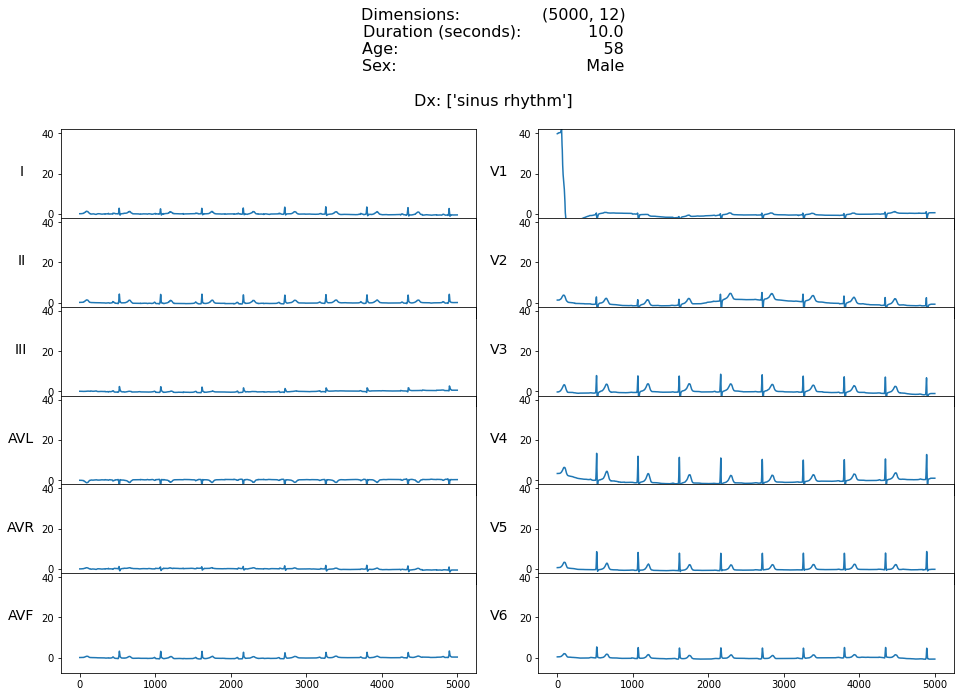

In [226]:
k = outliers.index[3]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [227]:
s = 6
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [228]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=2, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, analysis=True)

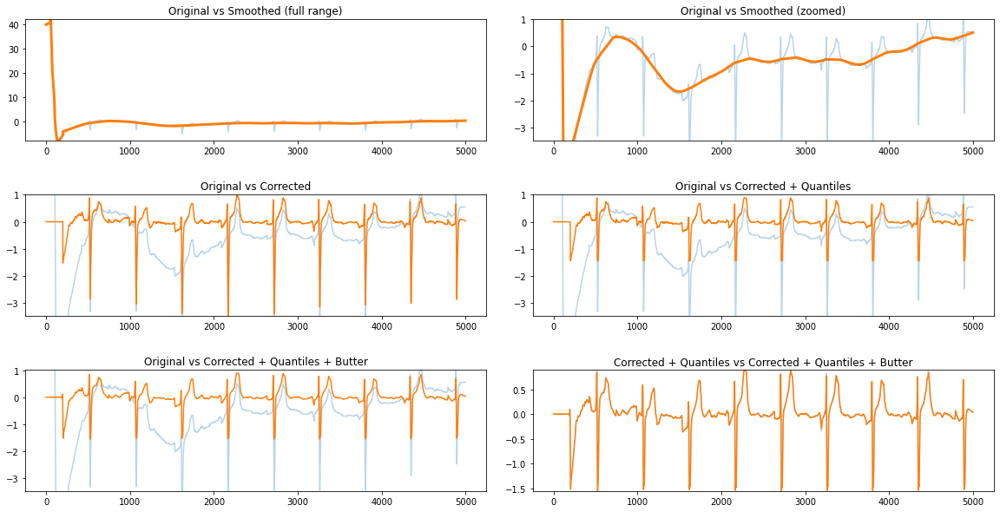

In [229]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [230]:
s = 3
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [231]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=2, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.015, analysis=True)

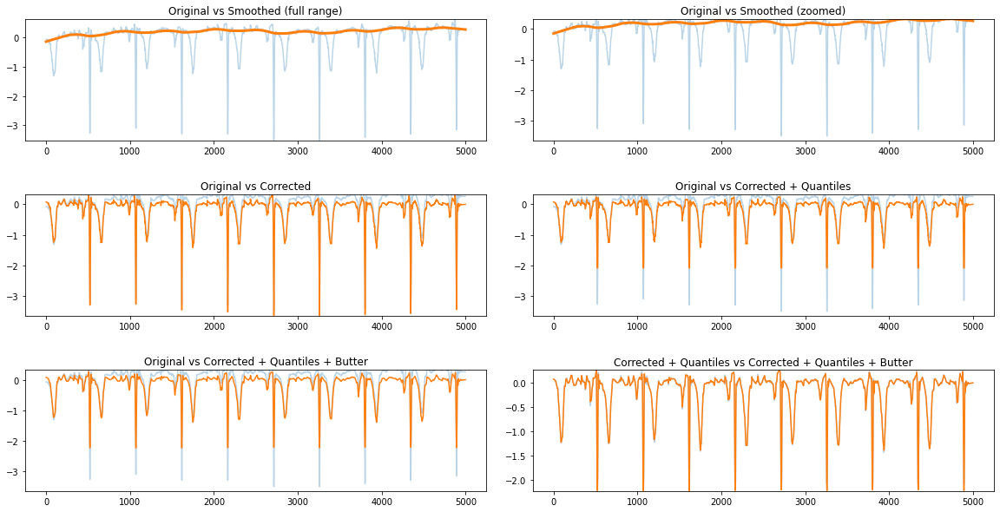

In [232]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

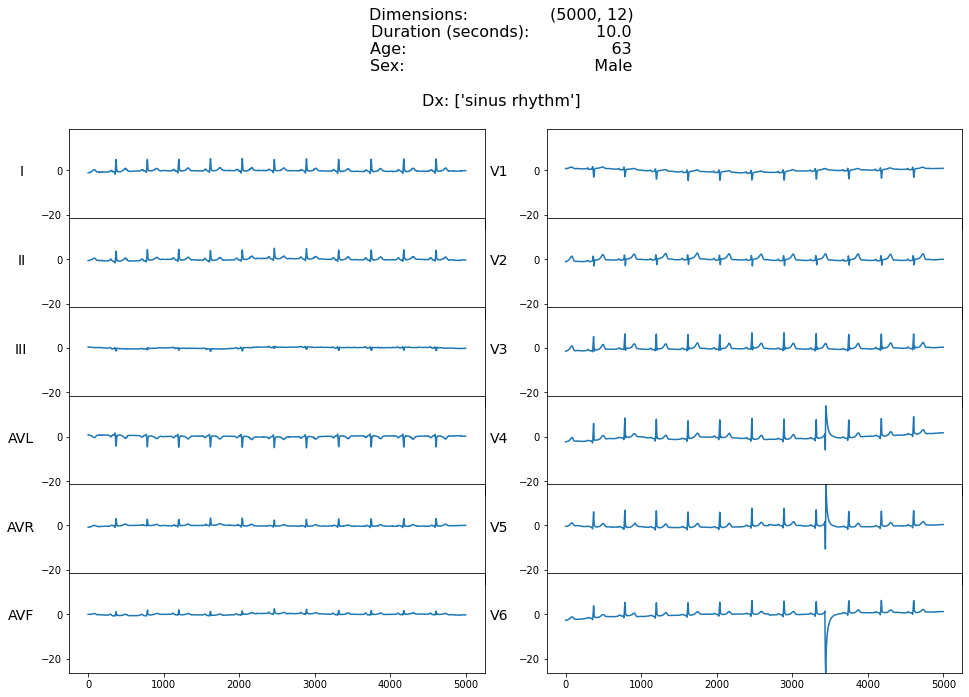

In [399]:
k = outliers.index[10]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**Was it worth losing the T wave over eliminating the outlier?**

In [400]:
s = 10
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [406]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=5, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.005,analysis=True)

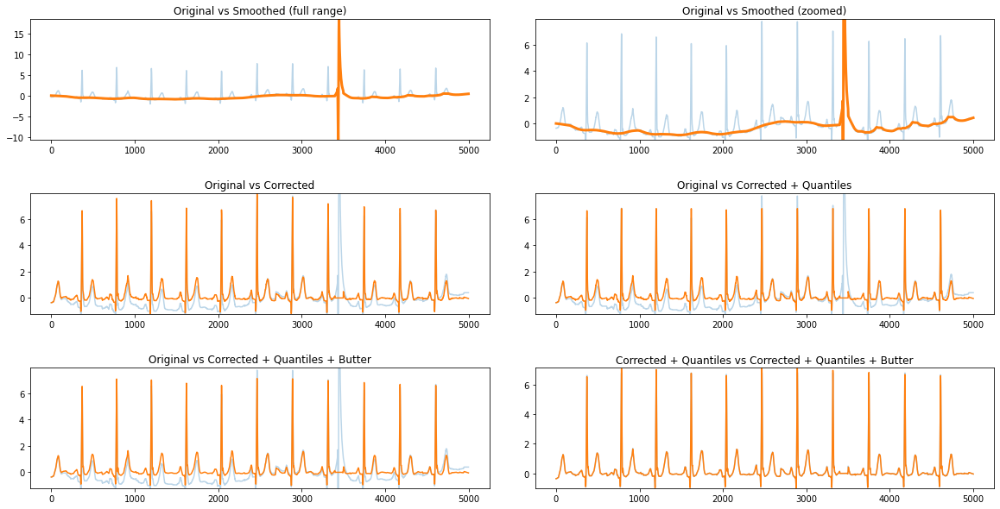

In [407]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [252]:
s = 11
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [253]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, analysis=True)

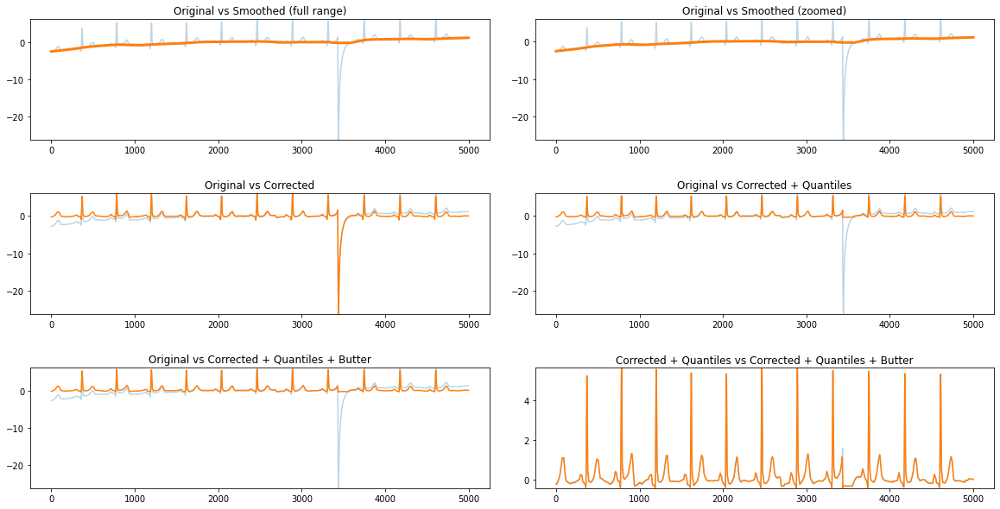

In [254]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

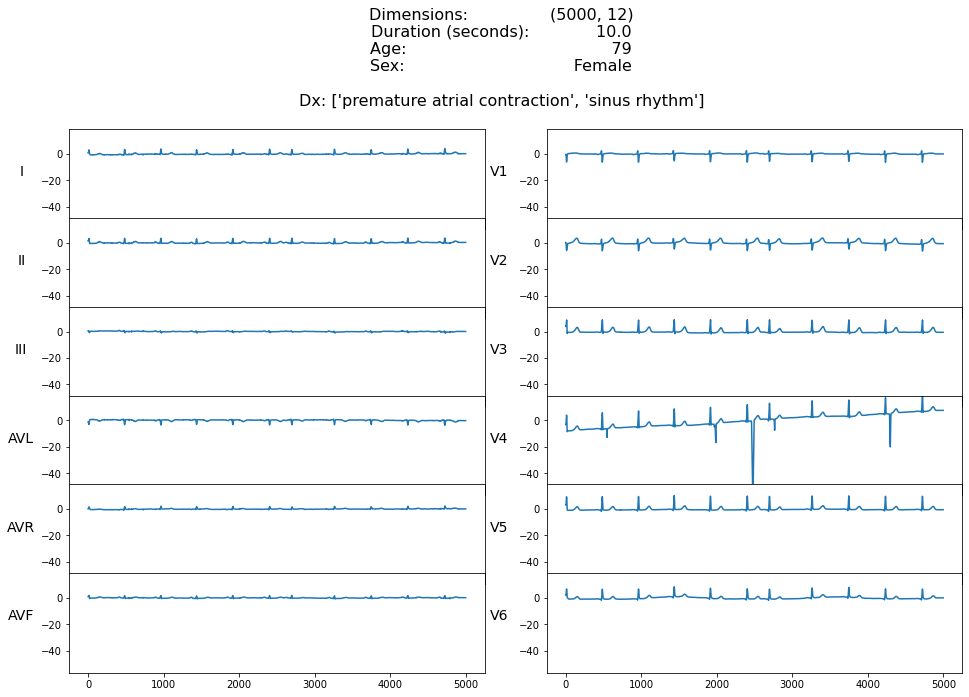

In [408]:
k = outliers.index[2]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [409]:
s = 9
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [410]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.005, analysis=True)

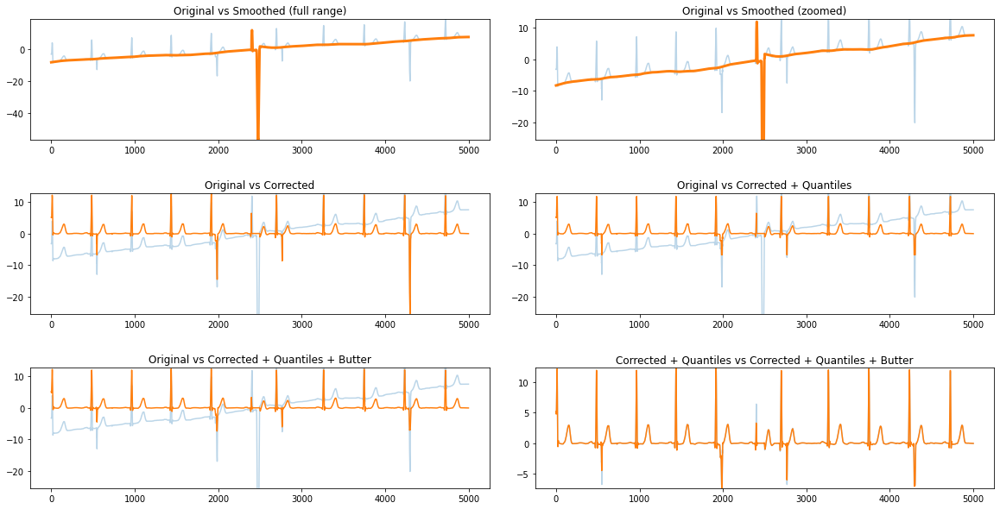

In [411]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

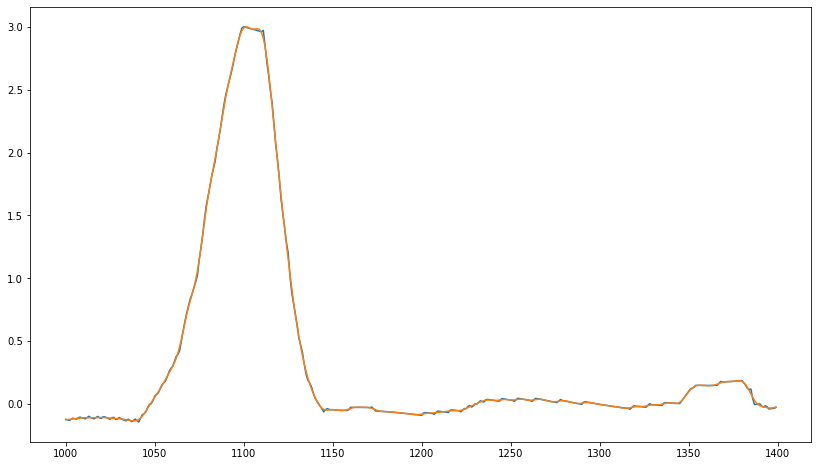

In [412]:
fig, ax = plt.subplots(figsize=(14,8))
a,b = 1000,1400
ax.plot(x[a:b], y_corrected[a:b])
ax.plot(x[a:b], y_butter[a:b])

**Was the heavier butter smoothing correct here? Should we rather not have that much butter smoothing? Is the noise in this ECG relatively normal or should we try to reduce it?**

In [413]:
s = 2
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [420]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.005, Wn=0.1, analysis=True)

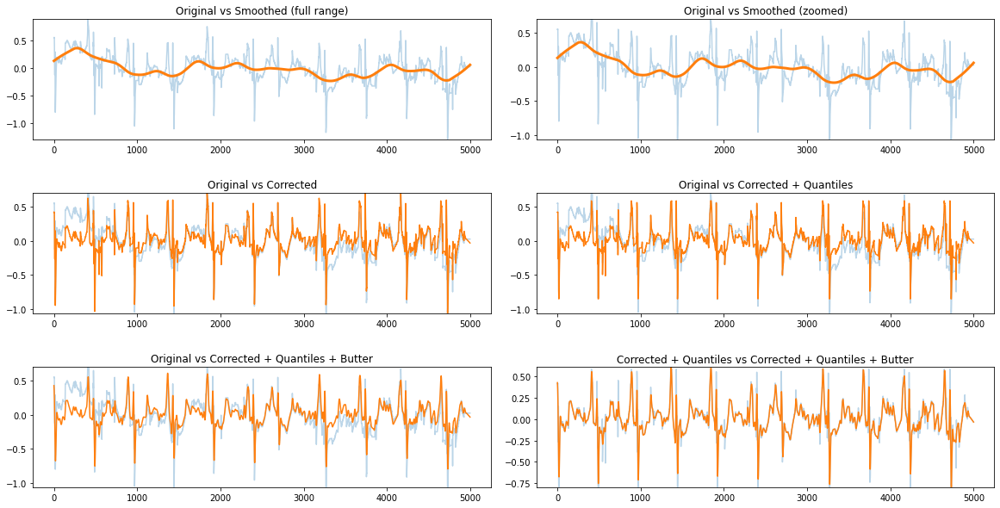

In [421]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

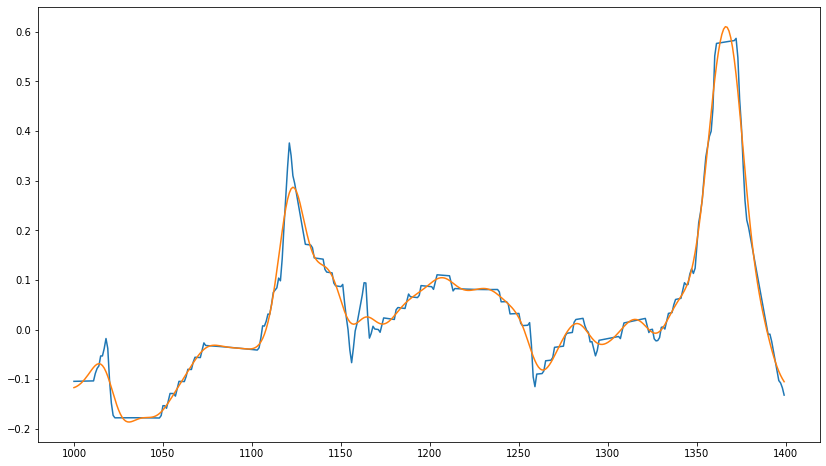

In [422]:
fig, ax = plt.subplots(figsize=(14,8))
a,b = 1000,1400
ax.plot(x[a:b], y_corrected[a:b])
ax.plot(x[a:b], y_butter[a:b])

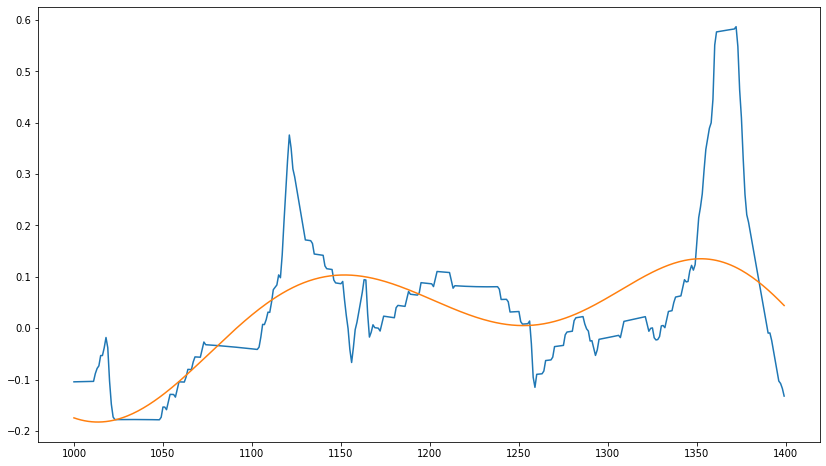

In [419]:
fig, ax = plt.subplots(figsize=(14,8))
a,b = 1000,1400
ax.plot(x[a:b], y_corrected[a:b])
ax.plot(x[a:b], y_butter[a:b])

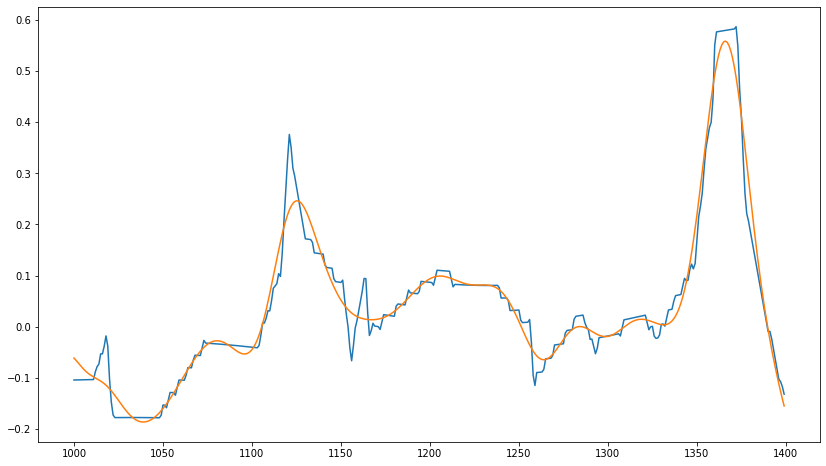

In [416]:
fig, ax = plt.subplots(figsize=(14,8))
a,b = 1000,1400
ax.plot(x[a:b], y_corrected[a:b])
ax.plot(x[a:b], y_butter[a:b])

**Are the dx traceable in this ecg or is it too noisy to determine?**

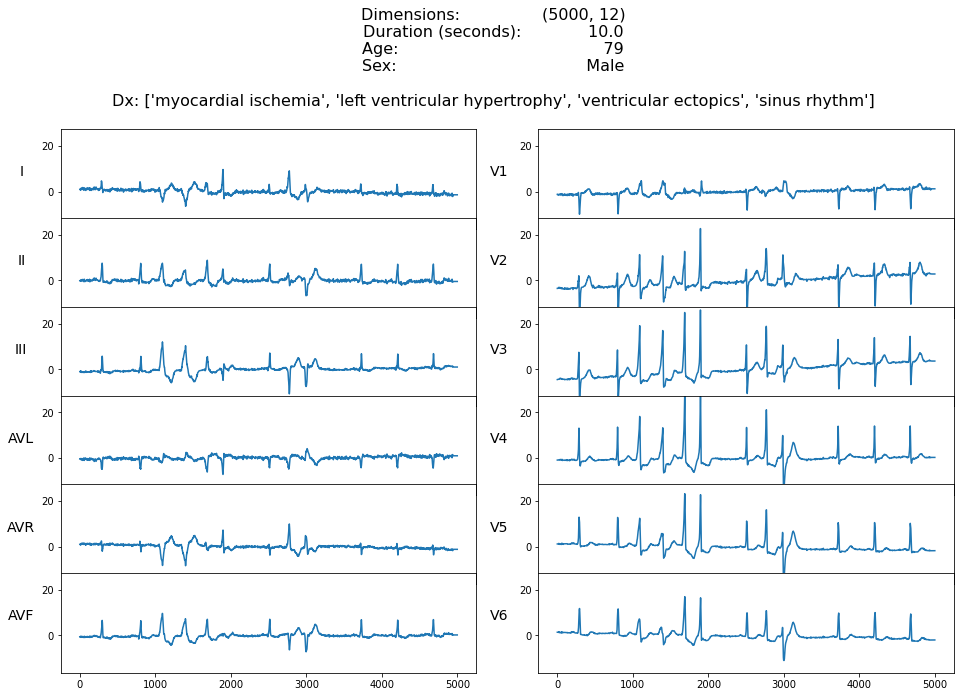

In [325]:
k = outliers.index[20]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [326]:
s = 10
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [327]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.005, Wn=0.06, analysis=True)

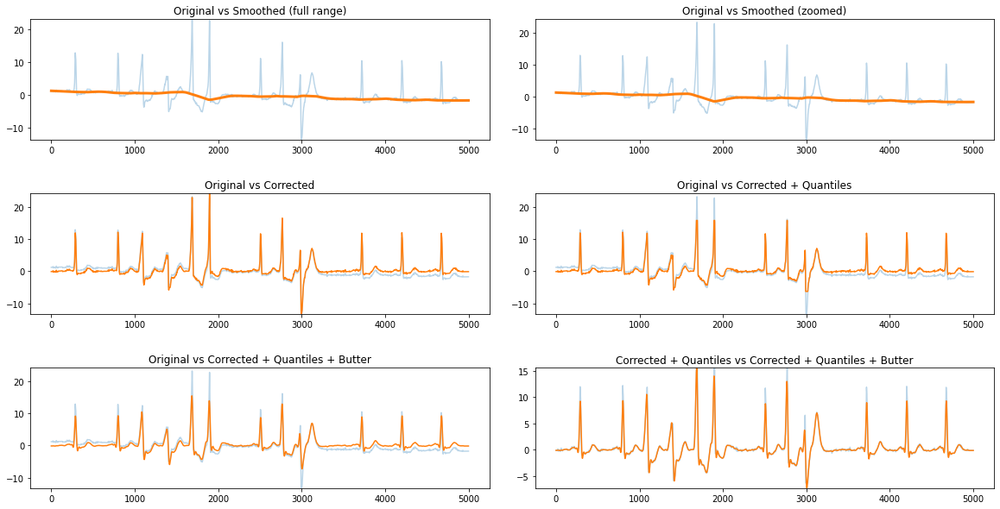

In [328]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

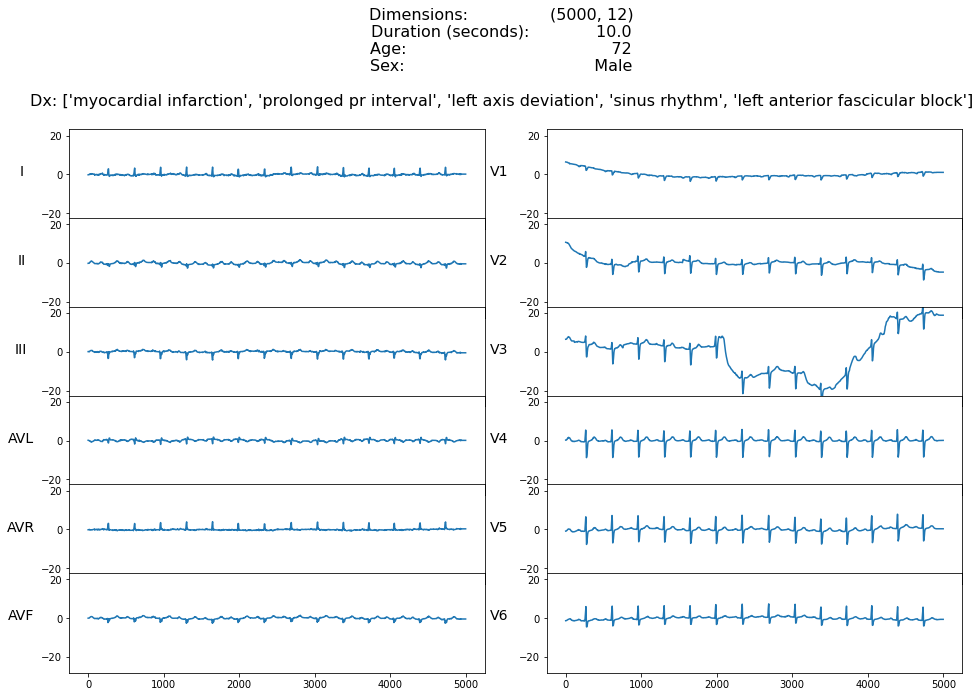

In [33]:
k = outliers.index[25]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**This particular case is interesting. If we choose std_threshold=4, then 2 outliers are detected, in which one of them causes us to "lose" a heartbeat. However, if we choose 5, then there are no outliers and there is a spike in the place of the other outlier. If we pick 4.08, then the series looks "its best". The problem here is that the difference between the stds of both outliers was too small, so how can we automate a criteria here?**

In [34]:
s = 8
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [366]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=4.1, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, Wn=0.06, analysis=True)

In [362]:
np.sort(stds_dict[idx][1])

array([0.17004297, 0.18442006, 0.19155759, 0.204701  , 0.20542578,
       0.29071612, 0.32336256, 0.34939426, 0.3835245 , 0.45614779,
       0.49575704, 0.51082505, 0.52164591, 0.52901154, 0.55599905,
       0.63878724, 0.67835587, 0.7384262 , 0.76568629, 0.80963116,
       0.81945662, 0.84183903, 0.87540046, 0.89540639, 0.94866767,
       0.94997768, 0.9742737 , 1.17850895, 1.21647486, 1.58445321,
       1.66513715, 1.72202783, 1.98614763, 1.98908834, 2.42552754,
       2.4679801 , 2.59574328, 2.62363679, 2.64765956, 2.65983355,
       2.66673369, 2.67683568, 2.69367027, 2.69506957, 2.69823869,
       2.72547049, 3.23664589, 3.29623302, 4.07362991, 4.1015081 ])

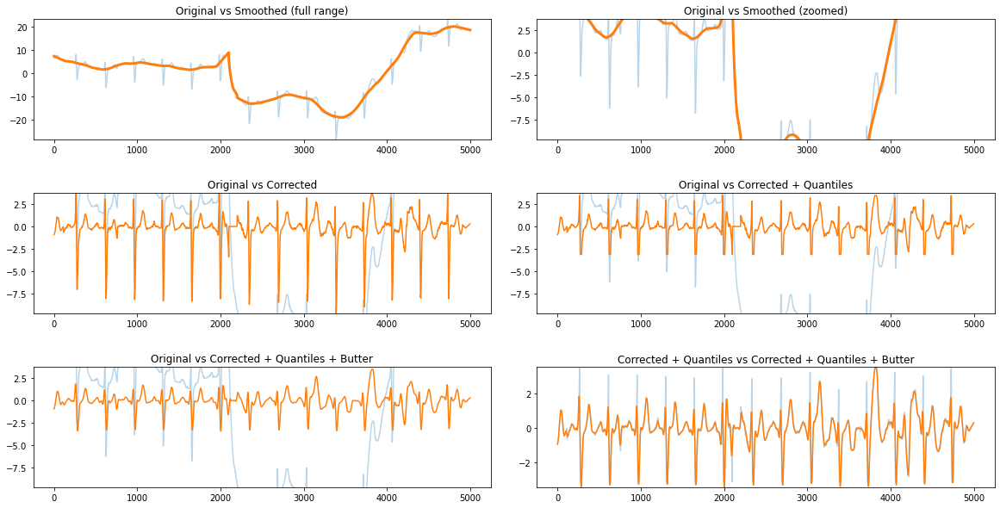

In [367]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

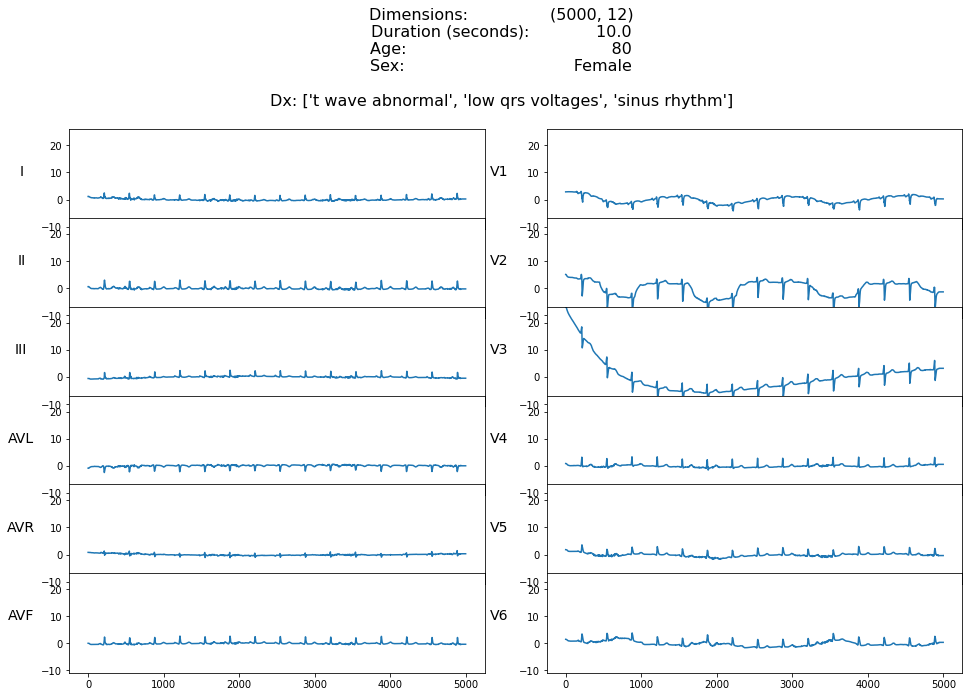

In [1246]:
k = outliers.index[31]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [1247]:
y = example[0]
y = y[:, 7]
x = np.arange(0, len(y), 1)

In [1248]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=4)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.05)

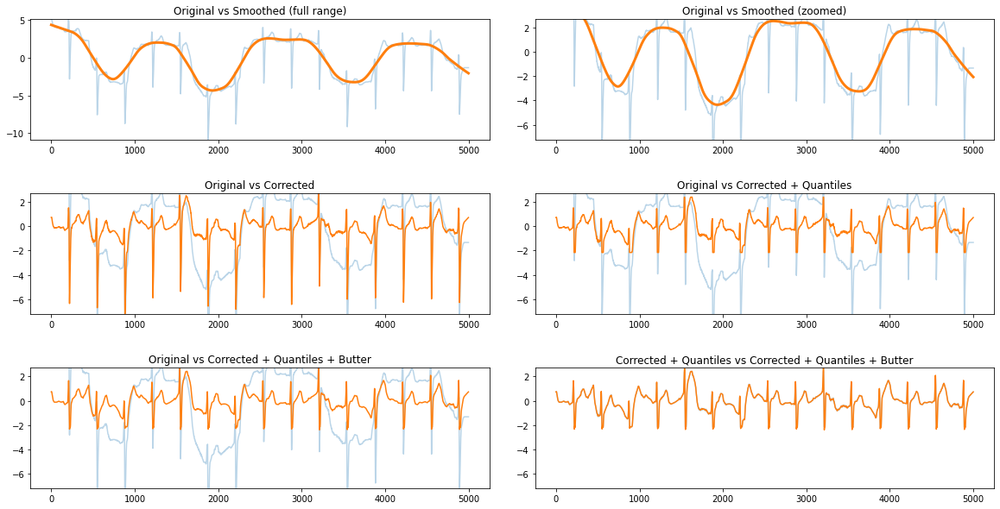

In [1249]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [1250]:
y = example[0]
y = y[:, 8]
x = np.arange(0, len(y), 1)

In [1251]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=4)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.05)

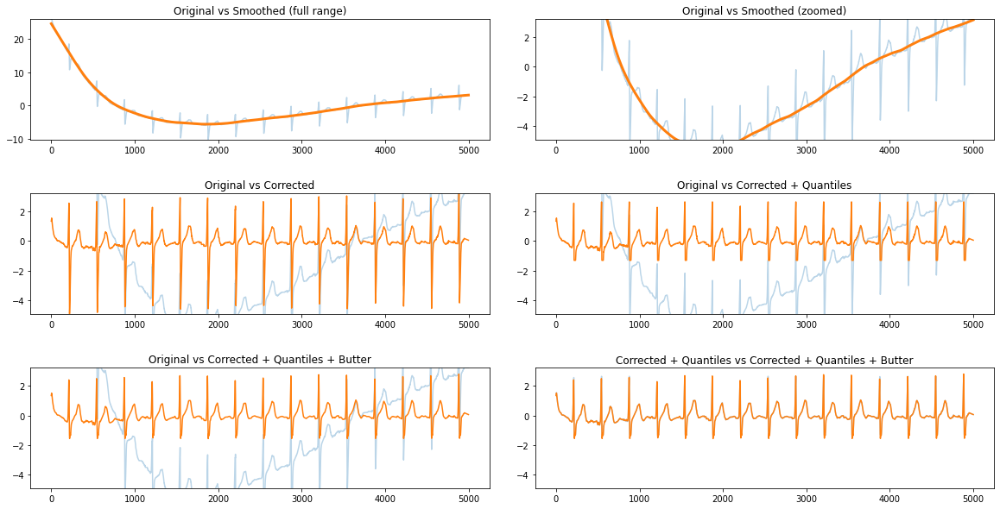

In [1252]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

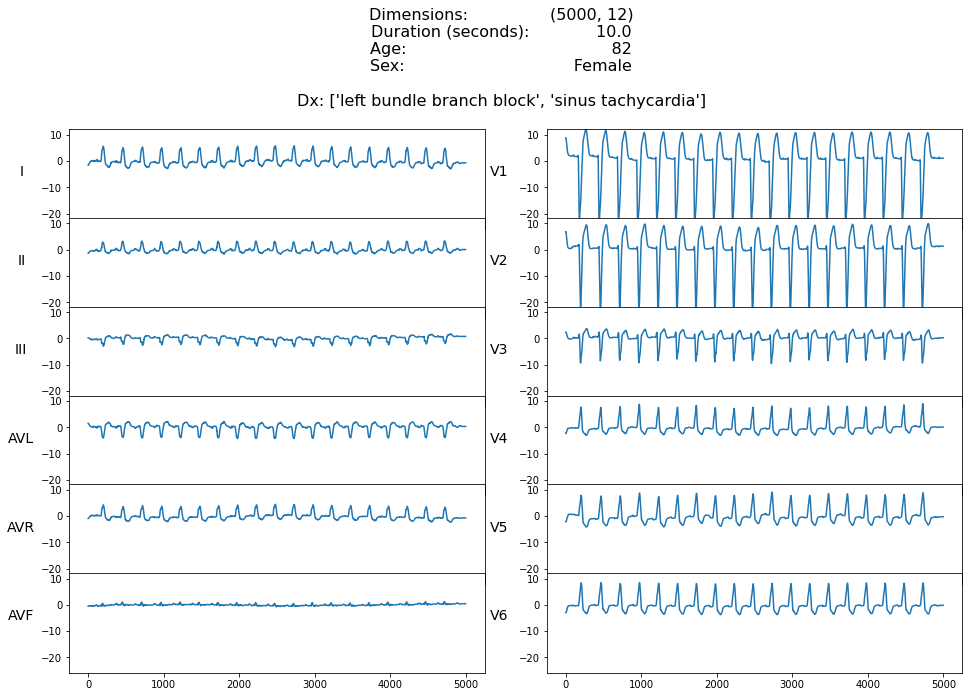

In [225]:
k = outliers.index[43]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**This is a strange case since the std_threshold is relying on each of the signals to fail the thresholds. This shows that a good approach is to both use quantiles and distance between them, so that if the upper or lower stds quantiles are very close, then there the threshold should not exist (or be defined as 1+max(stds) ). Also, should we be cutting with low_q here? This case seems more like a simple divide all by a constant case, or maybe it is okay for the signal to be between -20 and 10?**

In [226]:
y = example[0]
y = y[:, 6]
x = np.arange(0, len(y), 1)

In [237]:
y_smoothed = md.smooth_ecg_signal(x, y, std_threshold=15)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.08, Wn= 0.2)

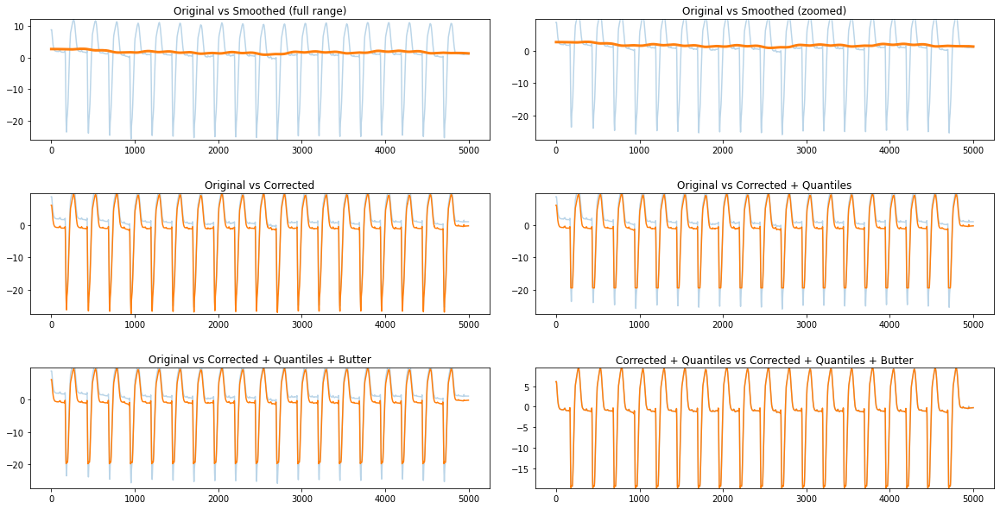

In [238]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

**Should we attempt to reduce noise here?**

In [1281]:
y = example[0]
y = y[:, 5]
x = np.arange(0, len(y), 1)

In [1282]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=15)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.15)

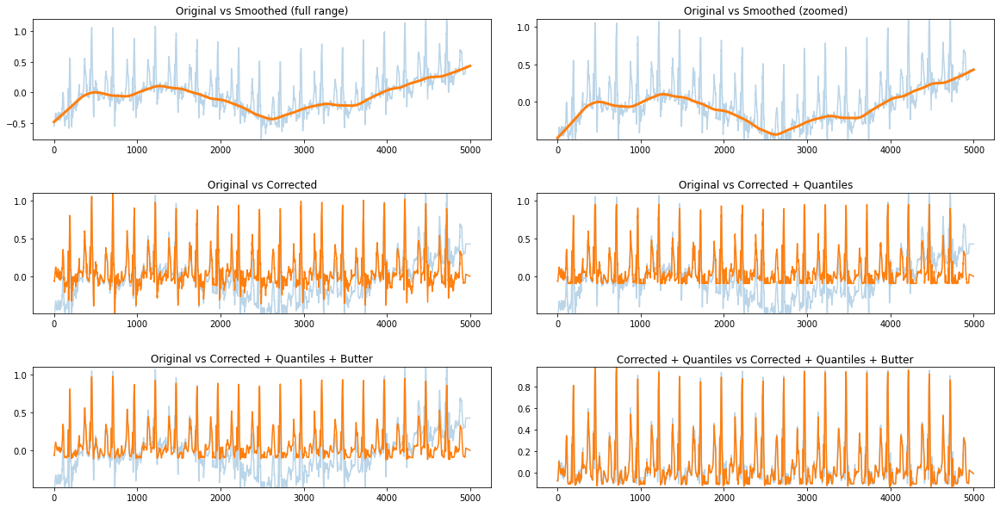

In [1283]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [1250]:
y = example[0]
y = y[:, 8]
x = np.arange(0, len(y), 1)

In [1251]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=4)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.05)

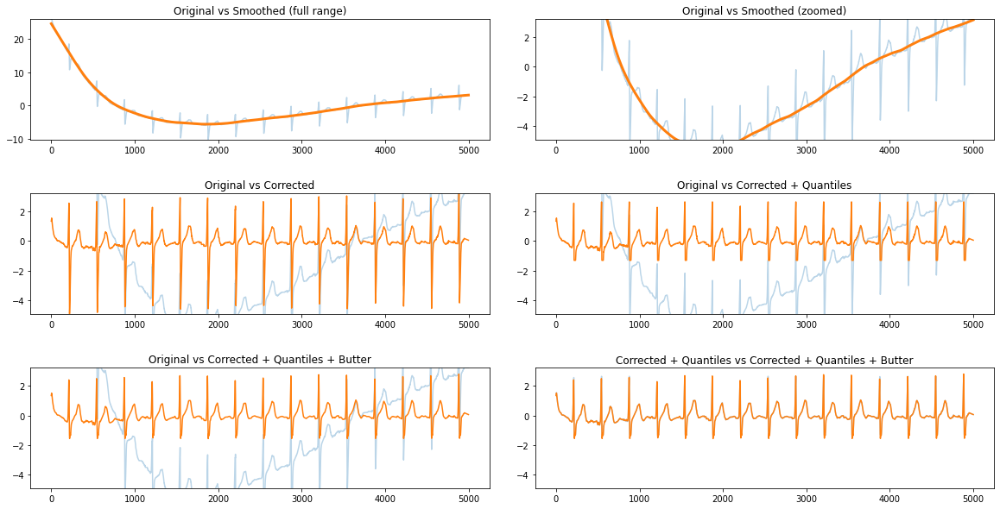

In [1252]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

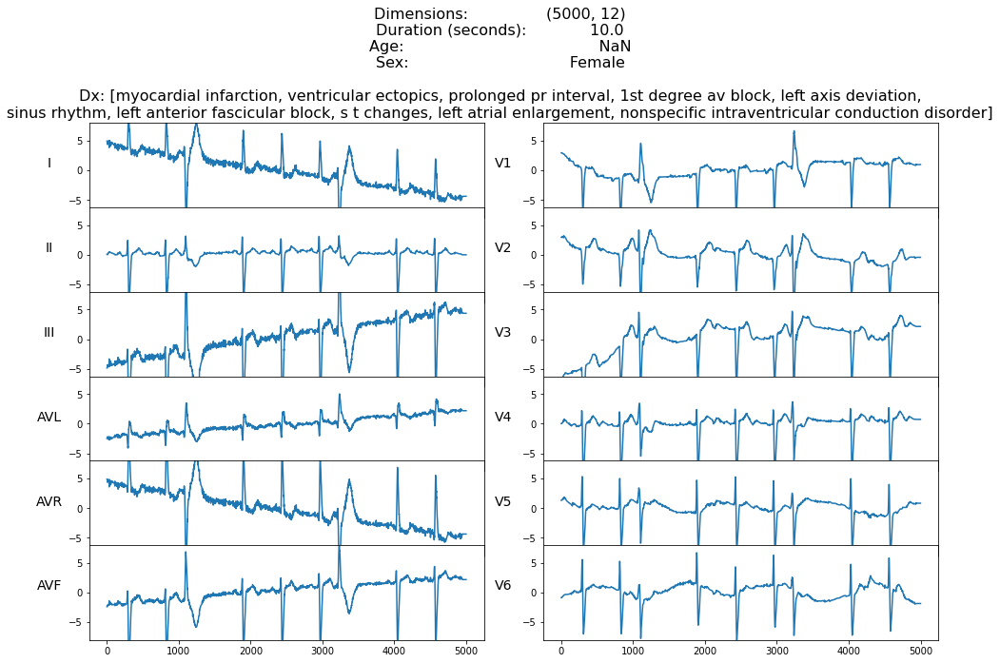

In [1416]:
# We put this example just to remember that we still need to make some upgrades to the visualization
k = 1188
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], ylim=(-8,8), metadata=metadata)

In [1420]:
s = 8
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [1423]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, analysis=True)

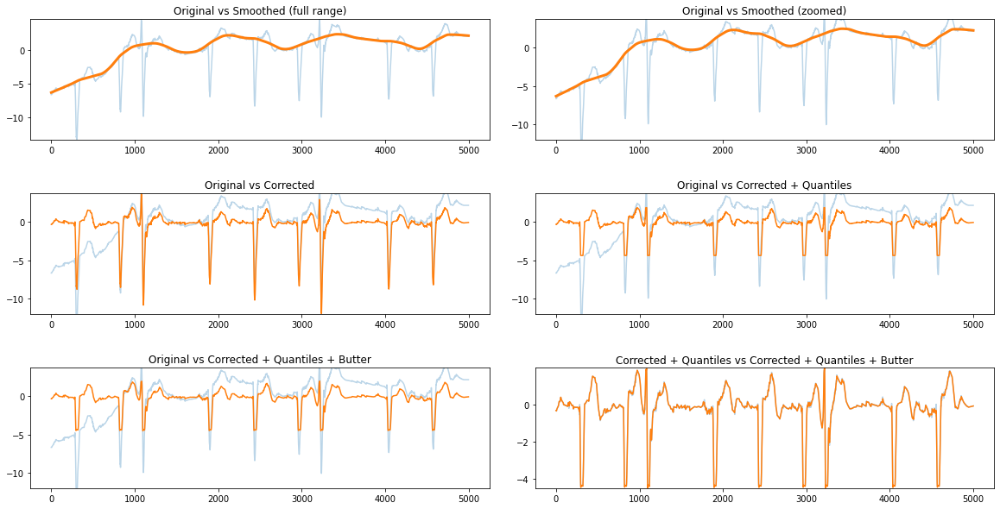

In [1424]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

In [1425]:
s = 0
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [1436]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=15, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.01, upp_q=0.975, analysis=True)

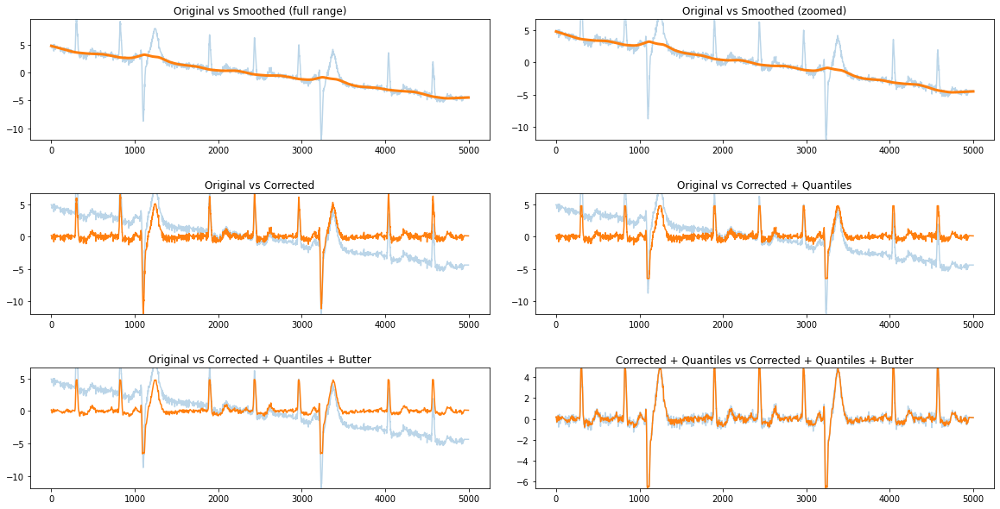

In [1437]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

**This sinus rhythm example is proving to be quite hard to correct. Also, is it really a synus rhythm? If not, then maybe we can drop it**

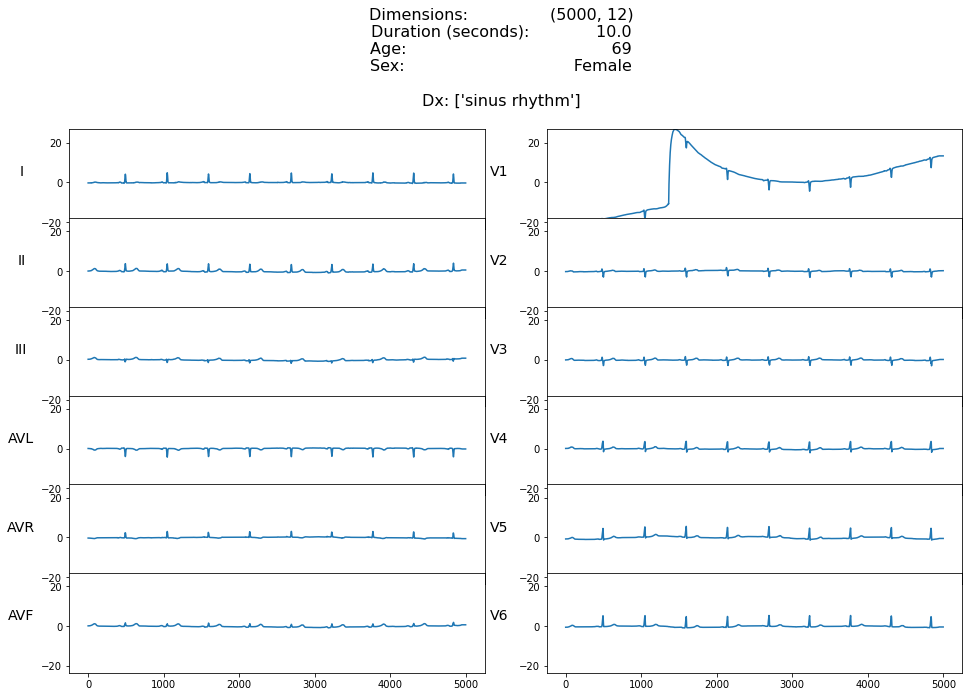

In [1171]:
k = outliers.index[1]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [1172]:
y = example[0]
y = y[:, 6]
x = np.arange(0, len(y), 1)

In [1183]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=10)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.02)

In [1175]:
stds

[0.16911725961592425,
 0.3194803436833008,
 0.22194269530669383,
 0.22813263685847313,
 1.1558225426076445,
 0.5144700647268019,
 0.19479478945803436,
 0.25212760162267034,
 0.18672316406916412,
 0.1638149794737954,
 1.3581574825844018,
 0.12516088646218523,
 0.22596127986891898,
 12.117927506281758,
 1.249034563172693,
 2.034047993534076,
 1.067430647630093,
 1.0247004001170295,
 0.811354686619853,
 0.6622348073002505,
 0.5382161647516729,
 1.3467386569041522,
 0.49774142634504515,
 0.28129200130824905,
 0.2691755932472333,
 0.17697775990219788,
 1.3282363598019744,
 0.22832701876913294,
 0.11710785626933828,
 0.02628193295783246,
 0.028217503433152977,
 0.06992272520432824,
 1.2885701339081235,
 0.03415914957957822,
 0.11998608252626634,
 0.1299788444324691,
 0.13819380413028653,
 1.255411959278706,
 0.12444375235422624,
 0.14424947140284433,
 0.2559422737650035,
 0.3275975999606835,
 0.41905429242521786,
 1.4624757262942862,
 0.20569149228881586,
 0.2744699437096893,
 0.301398121261

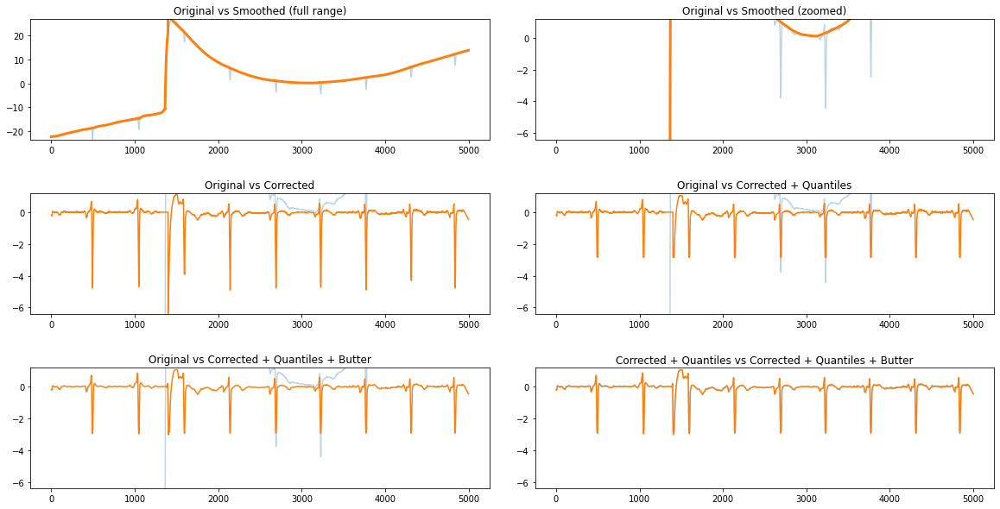

In [1184]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

# Spectogram

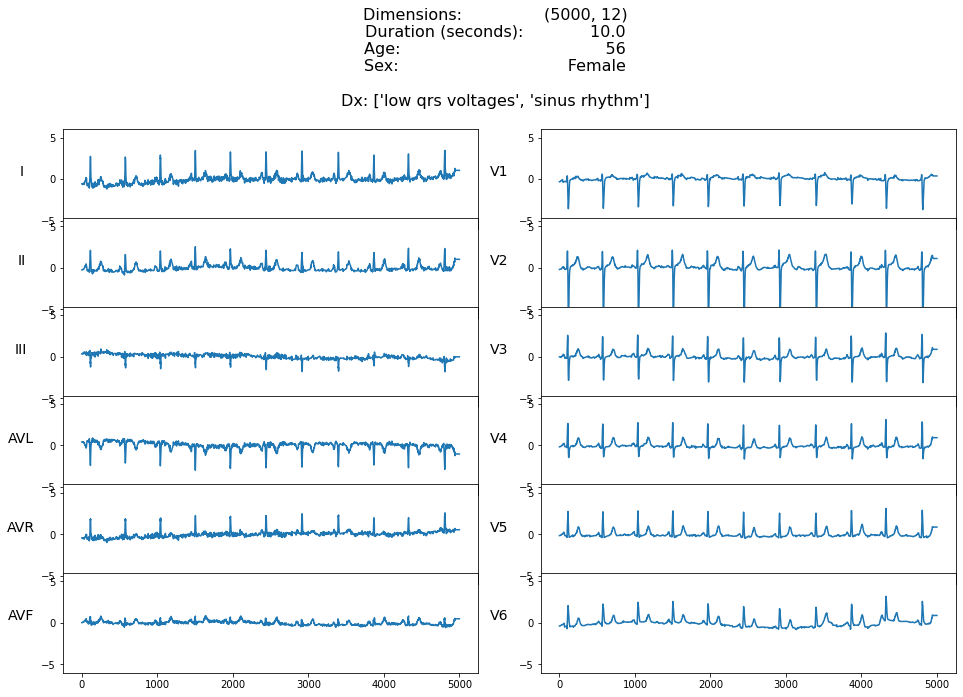

In [659]:
k = 0
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

There is too much variablity in the spectogram given the _nperseg_ and _noverlap_ parameters. Is there an optimal option?

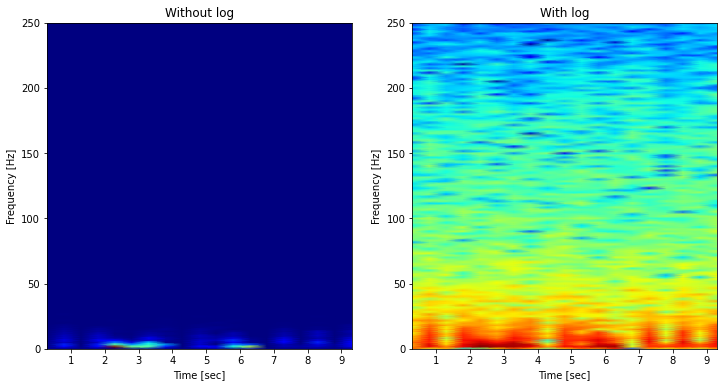

In [680]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=300, noverlap=50)

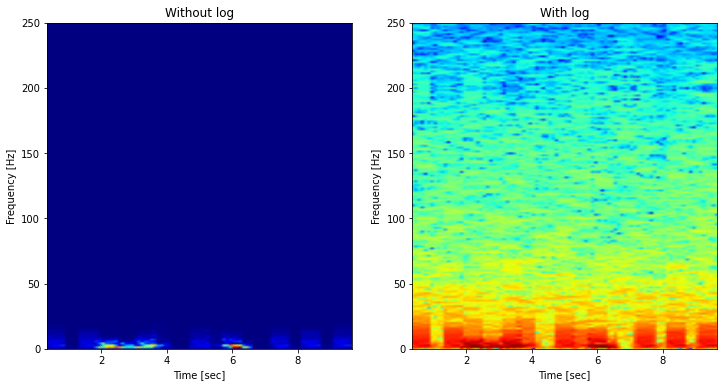

In [687]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=350, noverlap=300)

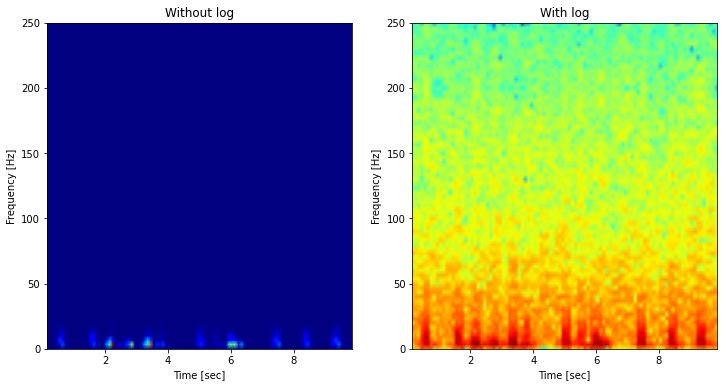

In [689]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

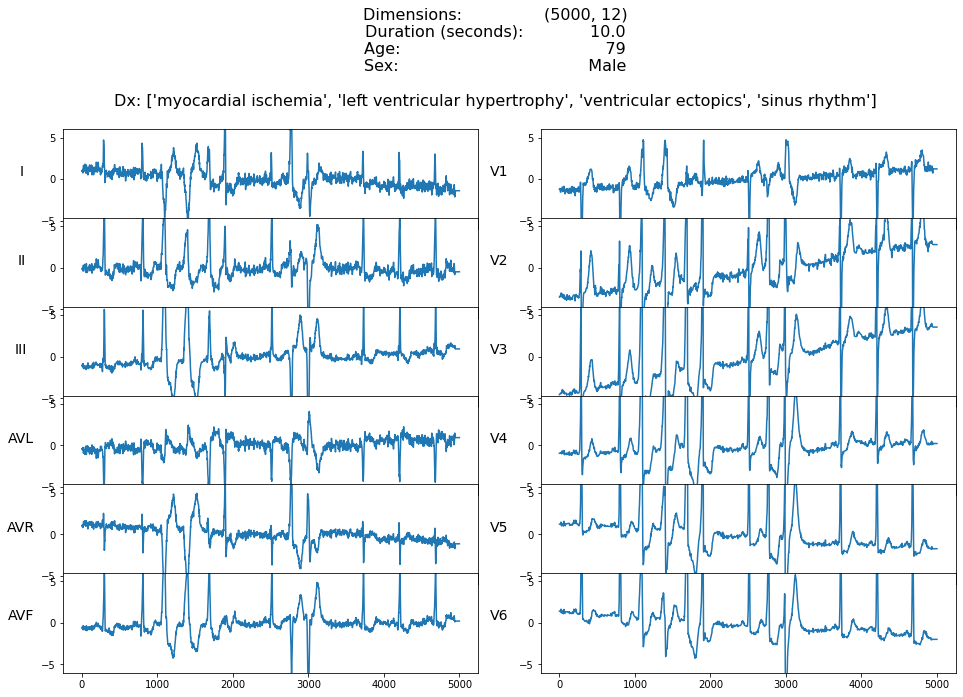

In [694]:
k = outliers.index[20]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

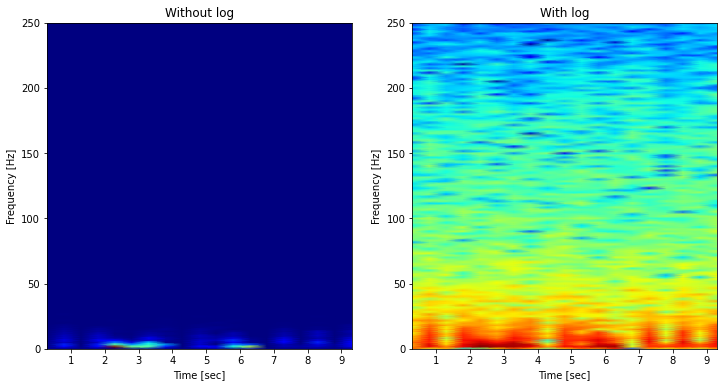

In [691]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=300, noverlap=50)

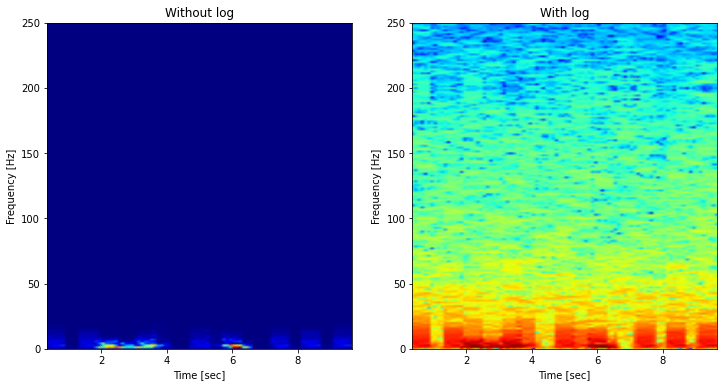

In [692]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=350, noverlap=300)

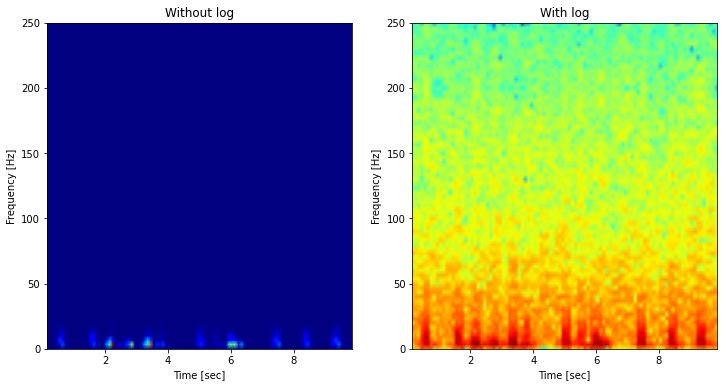

In [693]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

Reminder that some signals have a lot of noise, and it would be optimal to remove it.

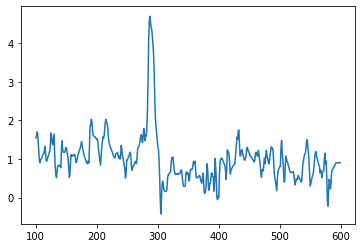

In [620]:
x = np.arange(0, len(y), 1)
plt.plot(x[100:600], y[100:600])

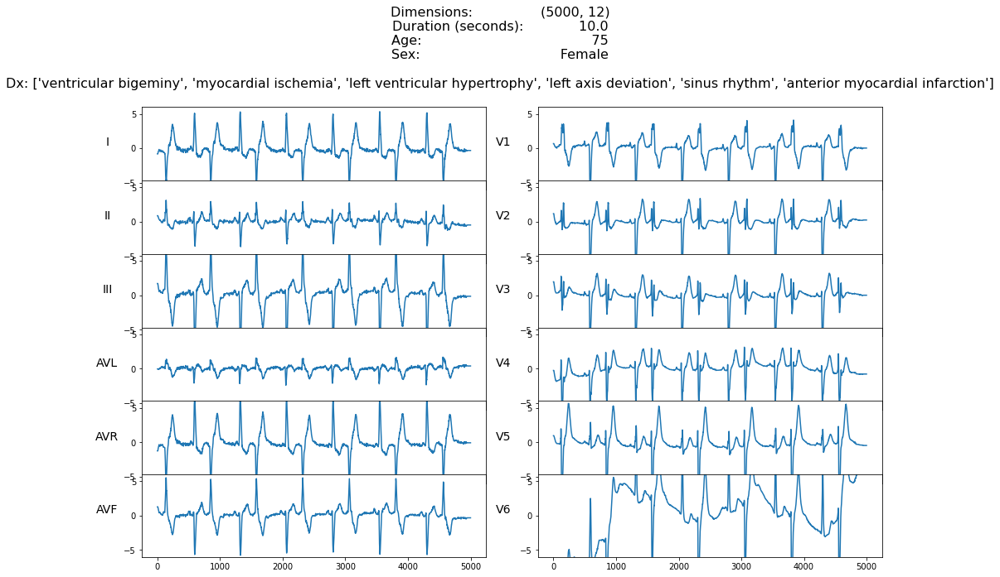

In [695]:
k = outliers.index[50]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

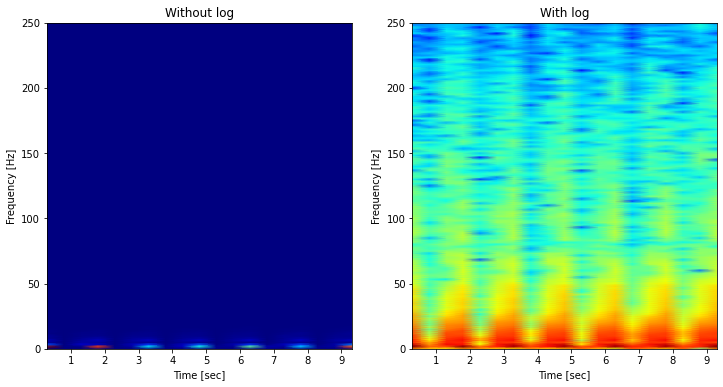

In [696]:
y = example[0]; y = y[:, -1]
pa.plot_spectogram(y, fs=500, nperseg=300, noverlap=50)

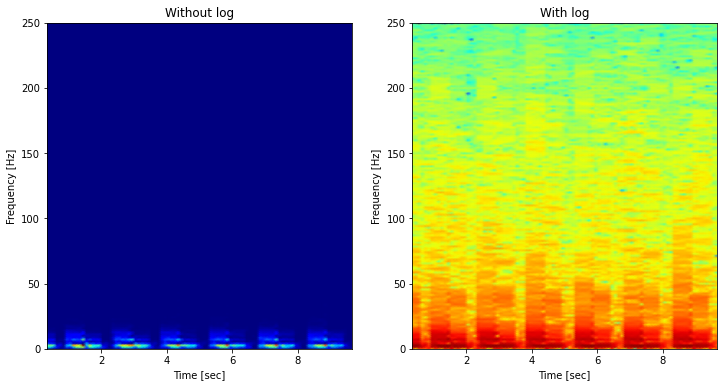

In [697]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=350, noverlap=300)

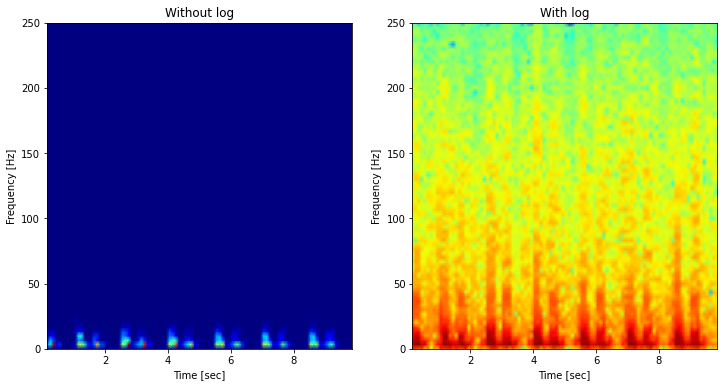

In [698]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

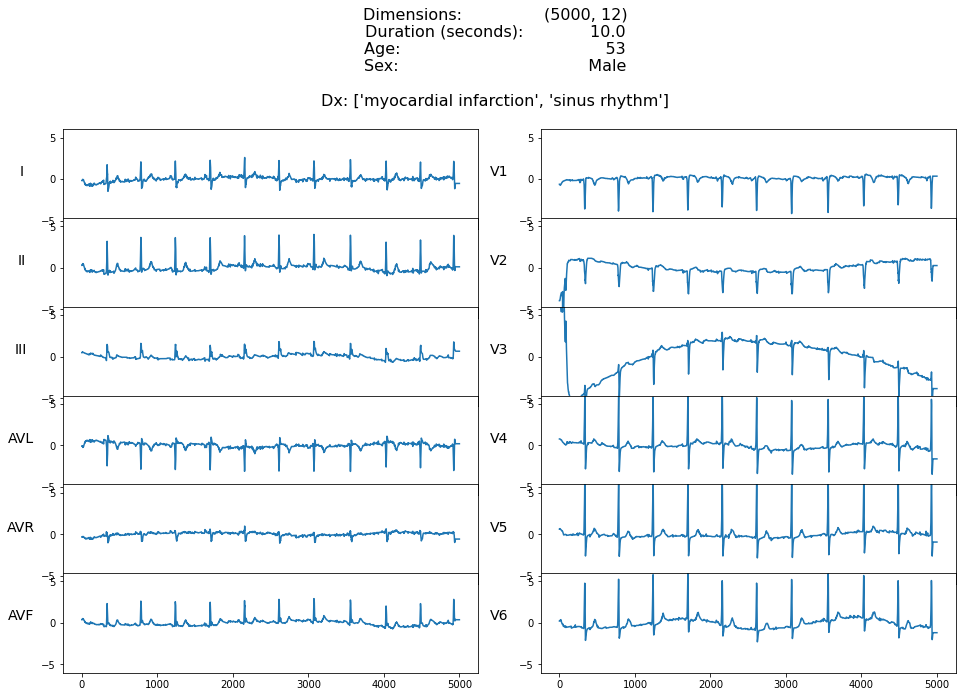

In [699]:
k = outliers.index[100]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

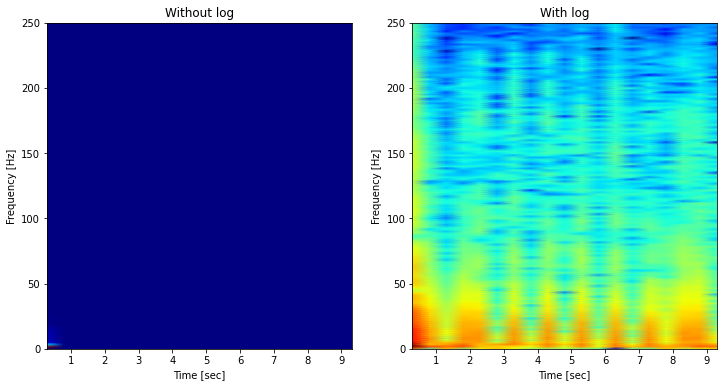

In [701]:
y = example[0]; y = y[:, 8]
pa.plot_spectogram(y, fs=500, nperseg=300, noverlap=50)

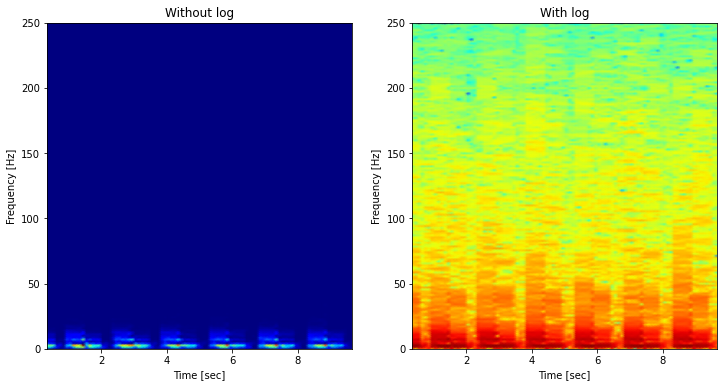

In [697]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=350, noverlap=300)

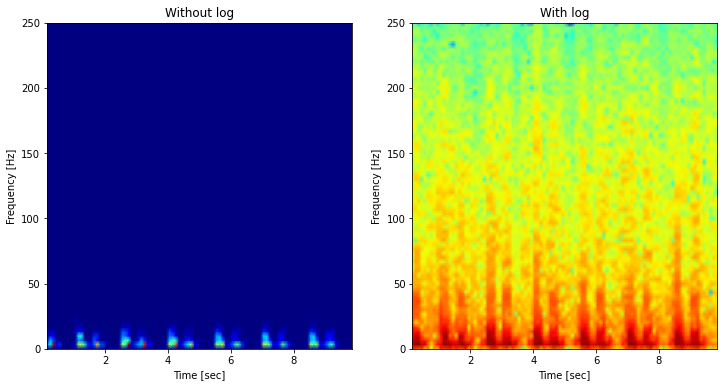

In [698]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

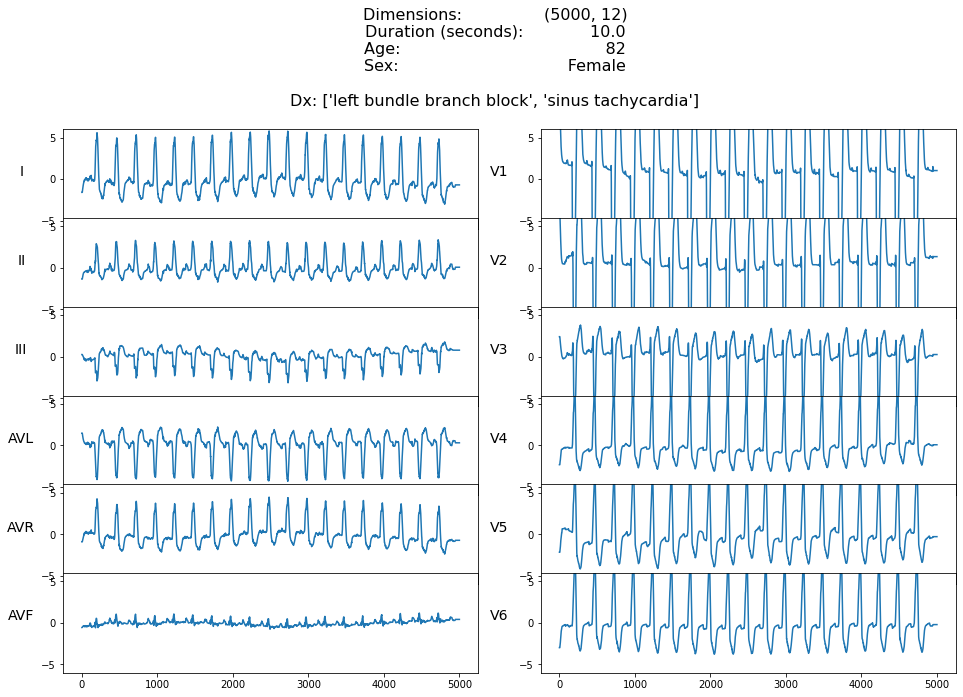

In [1284]:
k = outliers.index[43]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata)

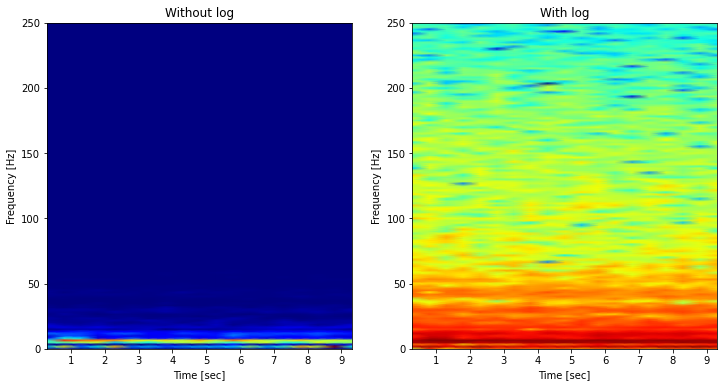

In [1285]:
y = example[0]; y = y[:, 5]
pa.plot_spectogram(y, fs=500, nperseg=300, noverlap=50)

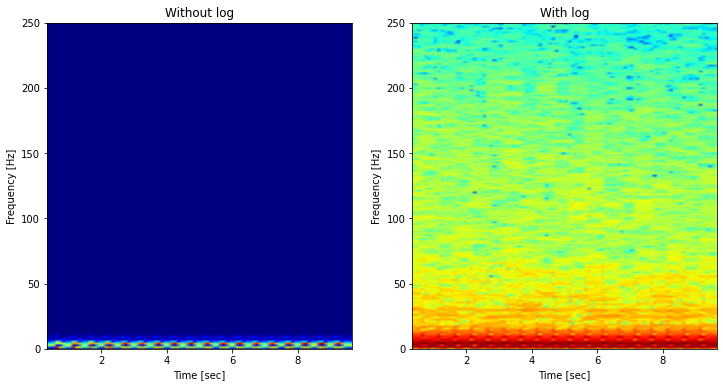

In [1286]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=350, noverlap=300)

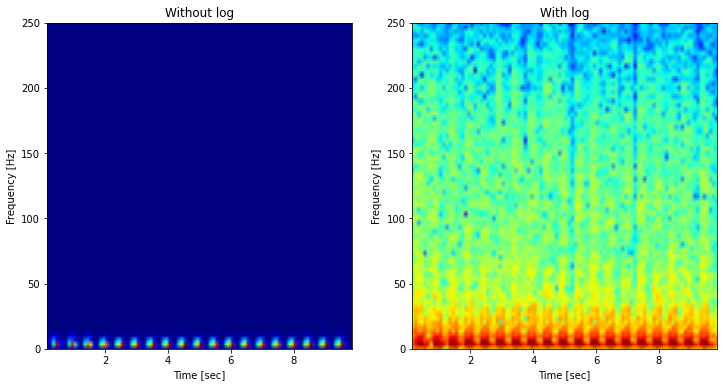

In [1287]:
y = example[0]; y = y[:, 1]
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

## Spectogram of original vs corrected

We wanted to see if the spectogram of an ecg signal is similar to the one of the processed signal. Based at least on 2 examples, it does not seem so.

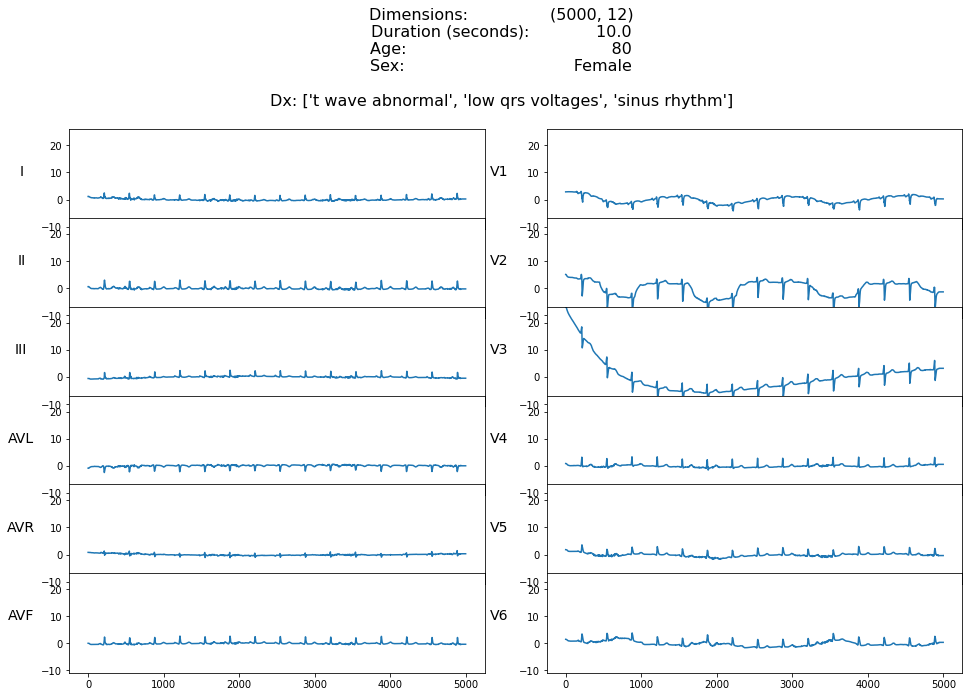

In [1294]:
k = outliers.index[31]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [1295]:
y = example[0]
y = y[:, 7]
x = np.arange(0, len(y), 1)

In [1296]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=4)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.05)

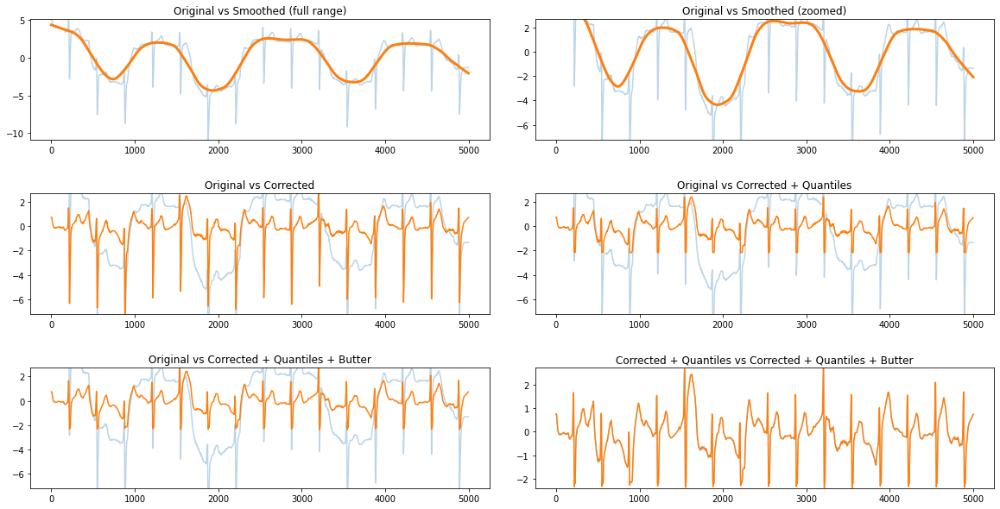

In [1297]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

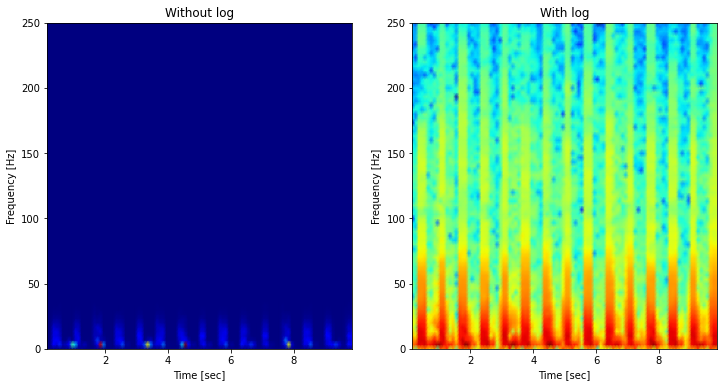

In [1298]:
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

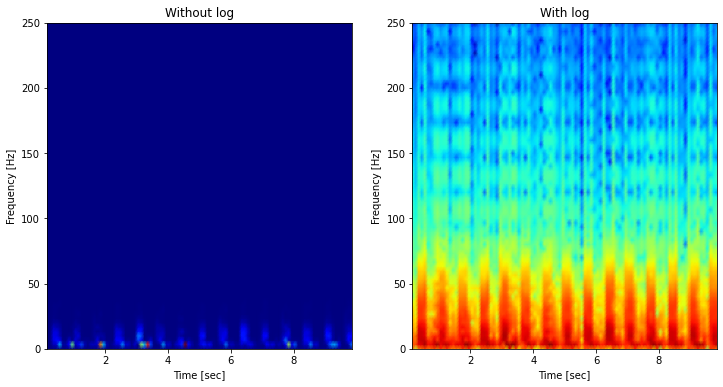

In [1299]:
pa.plot_spectogram(y_butter, fs=500, nperseg=150, noverlap=100)

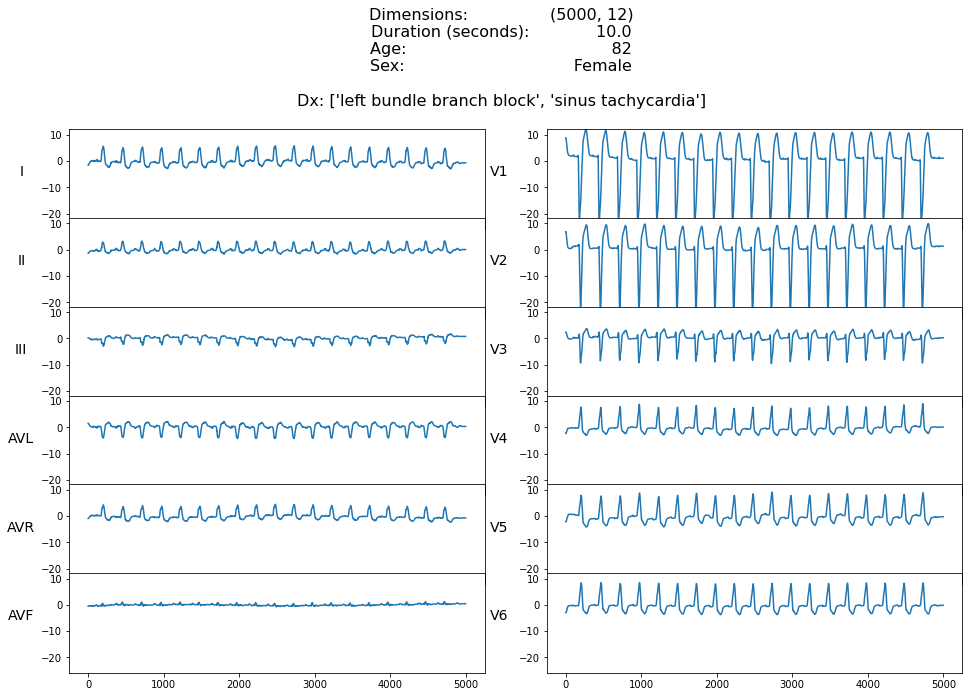

In [1300]:
k = outliers.index[43]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [1301]:
y = example[0]
y = y[:, 5]
x = np.arange(0, len(y), 1)

In [1302]:
y_smoothed, stds = md.smooth_ecg_signal(x, y, std_threshold=4)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed, low_q=0.05)

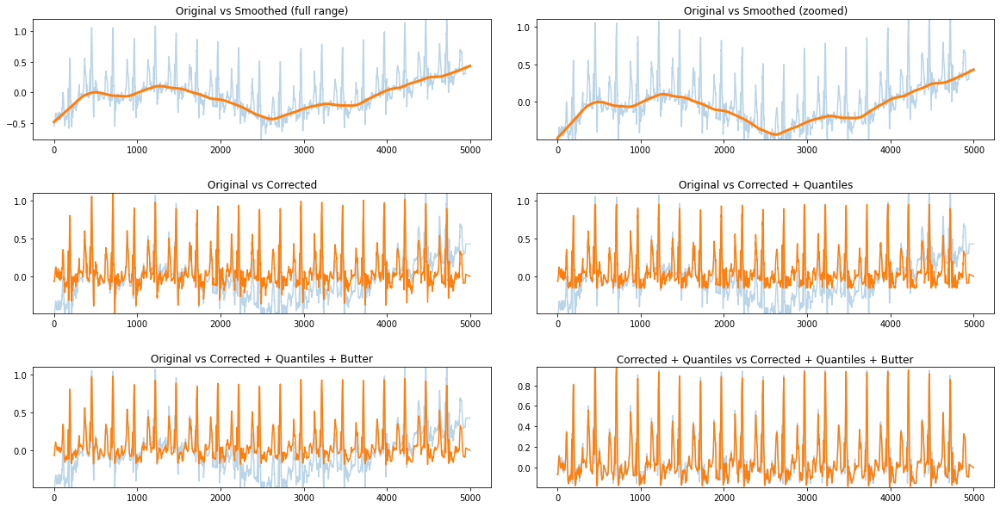

In [1303]:
pa.plot_smoothing_evolution(x, y, y_smoothed, y_new, y_corrected, y_butter)

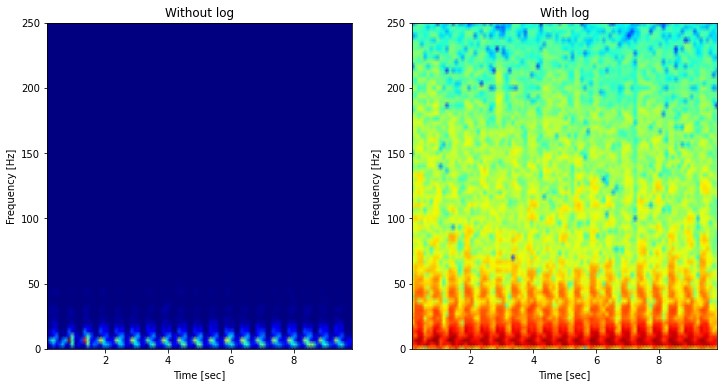

In [1305]:
pa.plot_spectogram(y, fs=500, nperseg=150, noverlap=100)

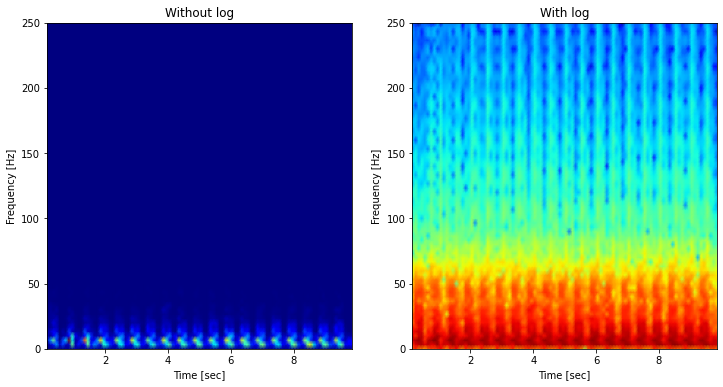

In [1306]:
pa.plot_spectogram(y_butter, fs=500, nperseg=150, noverlap=100)

# Filtering Signals

In [426]:
# !pip install biosppy

In [73]:
from scipy.fft import fft, ifft
from biosppy.signals import ecg
from biosppy.signals.tools import filter_signal

In [74]:
filter_bandwidth = [3, 45]

In [75]:
# Function from #1 team in Physionet Challenga 
def apply_filter(signal, filter_bandwidth, fs=500):
    # Calculate filter order
    order = int(0.3 * fs)
    # Filter signal
    signal, _, _ = filter_signal(signal=signal, ftype='FIR', band='bandpass',
                                 order=order, frequency=filter_bandwidth, 
                                 sampling_rate=fs)
    return signal


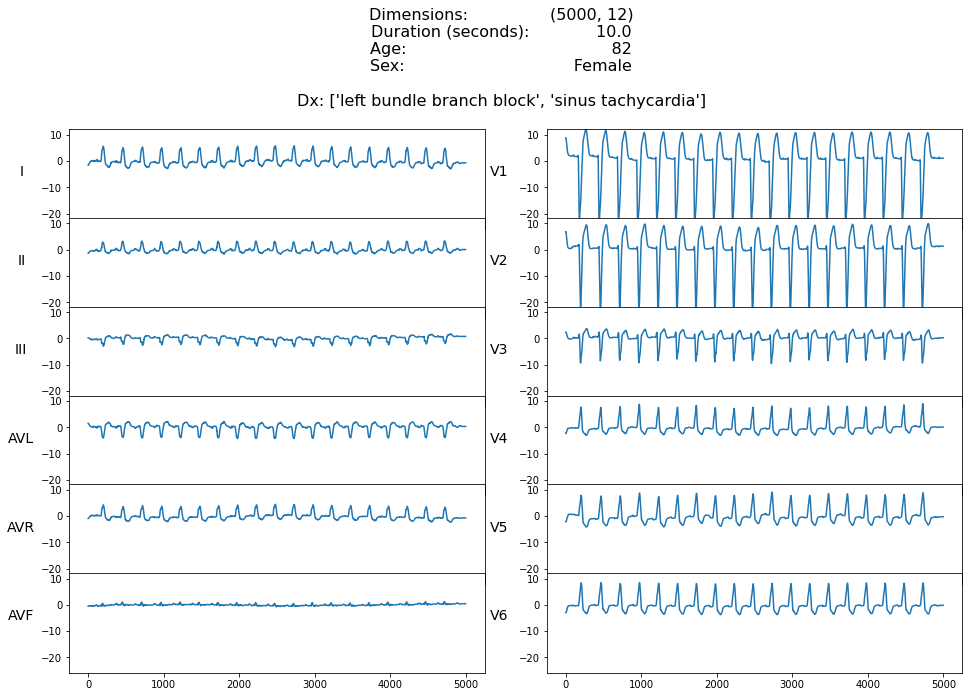

In [454]:
k = outliers.index[43]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [455]:
s = 7
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

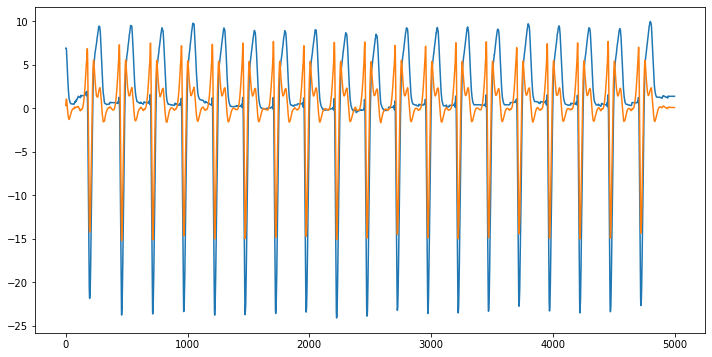

In [490]:
yf = apply_filter(y, filter_bandwidth)
yf = apply_filter(y, filter_bandwidth=[3, 60])

fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, y)
ax.plot(x, yf)

In [465]:
np.real(y_fft[0])

733.7150000000003

In [467]:
y_fft = fft(y)
y_inv = ifft(y_fft)

In [479]:
ffts = np.zeros(shape=(1000, 5000, 12))

for k in range(1000):
    for ch in range(12):
        ffts[k, :, ch] = np.real(fft(X[k, :, ch]))

In [487]:
np.quantile(ffts, 0.5)

0.0024224519729614258

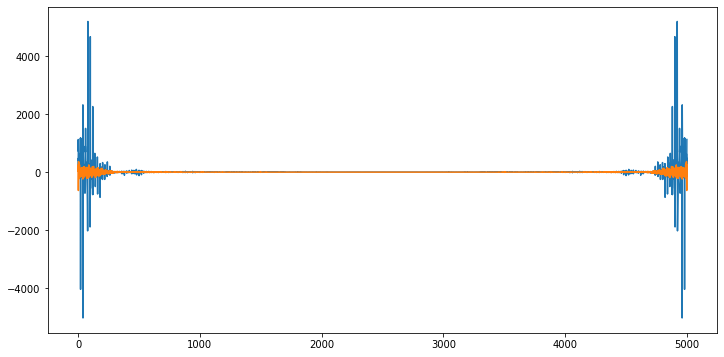

In [486]:
fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, np.real(y_fft))
# ax.plot(x, np.real(ffts[14, :, 3]))

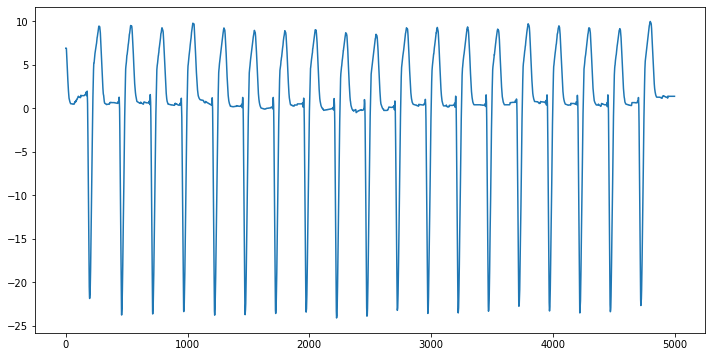

In [472]:
fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, np.real(y_inv))
# ax.plot(x, y)

In [445]:
y_ecg = ecg.ecg(signal=y, sampling_rate=500, show=False)

In [448]:
y_ecg['rpeaks']

array([ 176,  439,  695,  949, 1203, 1454, 1705, 1955, 2205, 2454, 2704,
       2954, 3203, 3453, 3702, 3953, 4203, 4453, 4703])

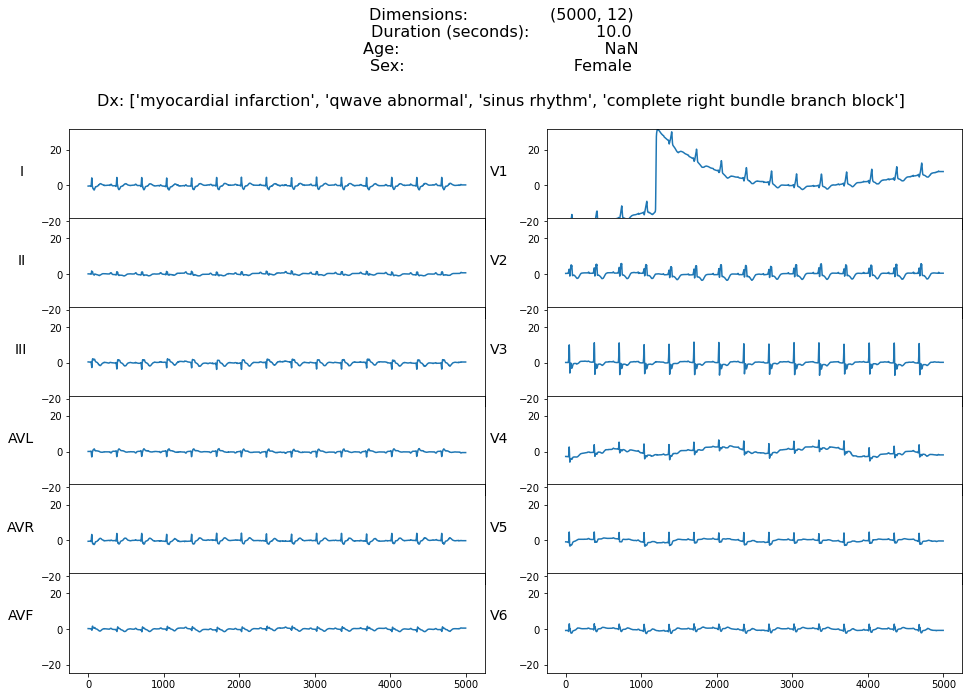

In [491]:
k = outliers.index[33]
example = wfdb.rdsamp(path+hea_files[k])
metadata = {"info": example, "labels": labels, "path": None}
pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [492]:
s = 6
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

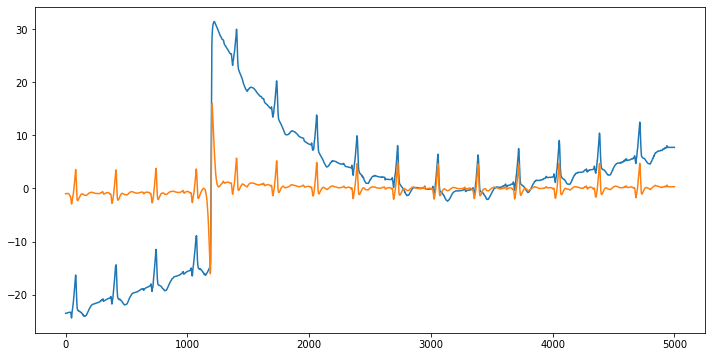

In [493]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, y)
ax.plot(x, yf)

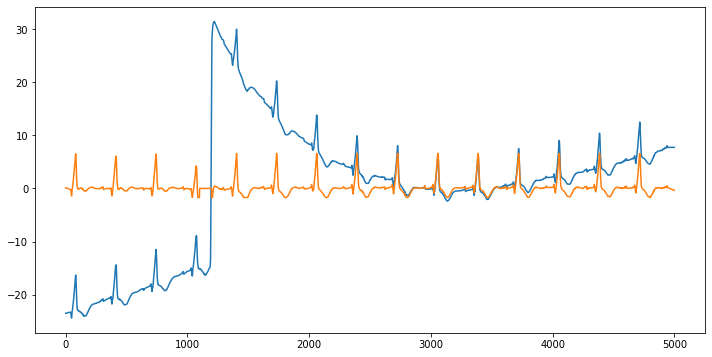

In [494]:
y_smoothed = md.smooth_ecg_signal(x, y, std_threshold=5)
y_new, y_corrected, y_butter = md.clean_ecg_signal(y, y_smoothed)

fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, y)
ax.plot(x, y_corrected)

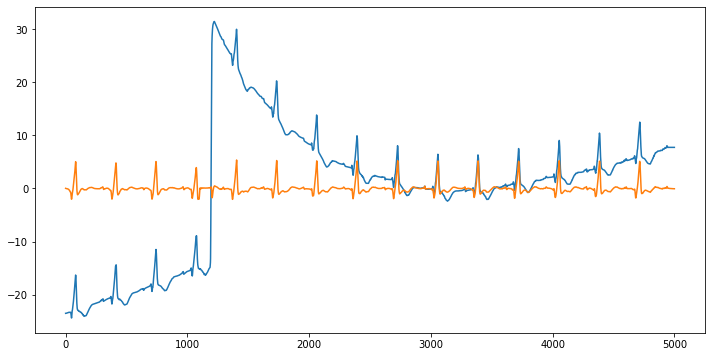

In [521]:
yf_corrected = apply_filter(y_corrected, filter_bandwidth=[2, 60])

fig, ax = plt.subplots(figsize=(12,6))
ax.plot(x, y)
ax.plot(x, yf_corrected)

# September 9 Presentation

### Filters Explanation

In [264]:
k = outliers.index[25]
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

**This particular case is interesting. If we choose std_threshold=4, then 2 outliers are detected, in which one of them causes us to "lose" a heartbeat. However, if we choose 5, then there are no outliers and there is a spike in the place of the other outlier. If we pick 4.08, then the series looks "its best". The problem here is that the difference between the stds of both outliers was too small, so how can we automate a criteria here?**

In [265]:
s = 8
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [269]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=4.1, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, Wn=0.09, analysis=True)

In [40]:
np.sort(stds_dict[idx][1])

array([0.17004297, 0.18442006, 0.19155759, 0.204701  , 0.20542578,
       0.29071612, 0.32336256, 0.34939426, 0.3835245 , 0.45614779,
       0.49575704, 0.51082505, 0.52164591, 0.52901154, 0.55599905,
       0.63878724, 0.67835587, 0.7384262 , 0.76568629, 0.80963116,
       0.81945662, 0.84183903, 0.87540046, 0.89540639, 0.94866767,
       0.94997768, 0.9742737 , 1.17850895, 1.21647486, 1.58445321,
       1.66513715, 1.72202783, 1.98614763, 1.98908834, 2.42552754,
       2.4679801 , 2.59574328, 2.62363679, 2.64765956, 2.65983355,
       2.66673369, 2.67683568, 2.69367027, 2.69506957, 2.69823869,
       2.72547049, 3.23664589, 3.29623302, 4.07362991, 4.1015081 ])

Text(0, 0.5, 'Amplitude [mV]')

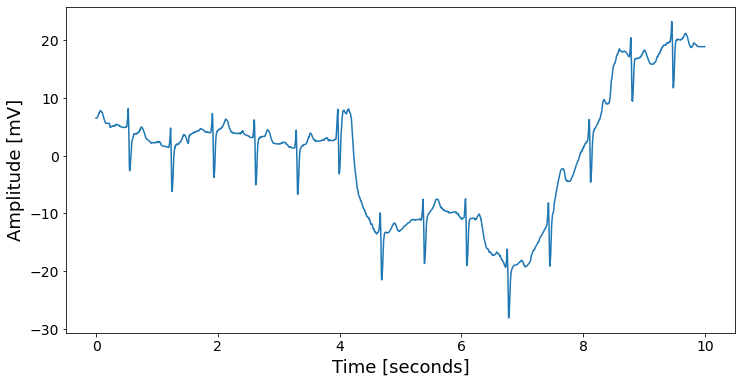

In [54]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

Text(0, 0.5, 'Amplitude [mV]')

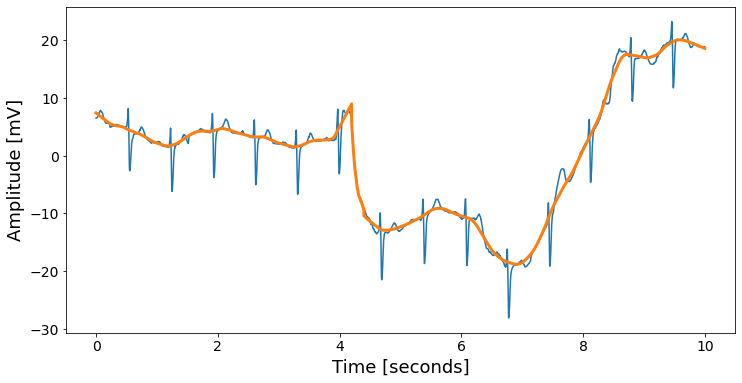

In [57]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y)
ax.plot(x/500, y_smoothed, linewidth=3)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

Text(0, 0.5, 'Amplitude [mV]')

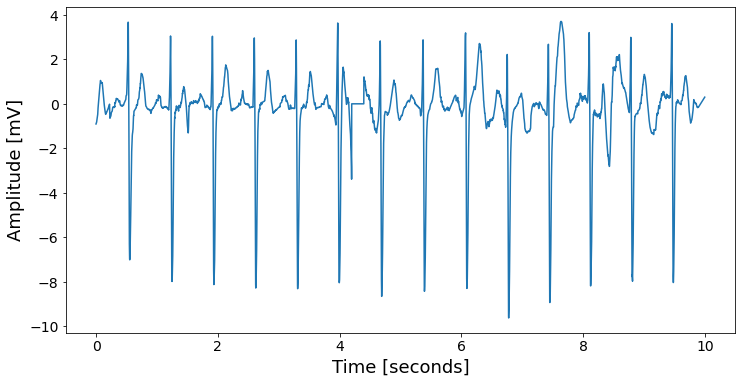

In [55]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y_new)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

Text(0, 0.5, 'Amplitude [mV]')

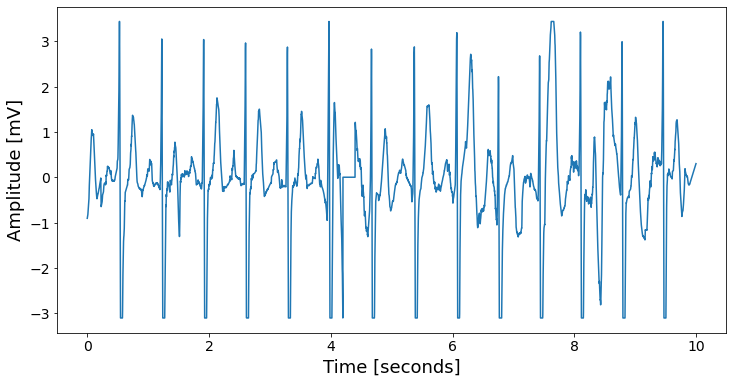

In [58]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y_corrected)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

Text(0, 0.5, 'Amplitude [mV]')

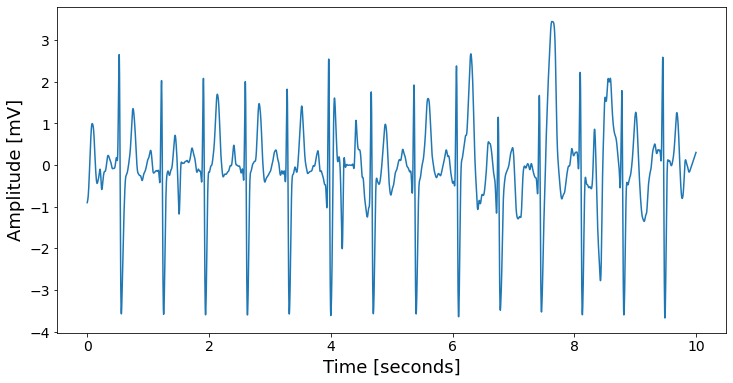

In [92]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y_butter)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

In [280]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=4.1, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, Wn=0.12, analysis=True)

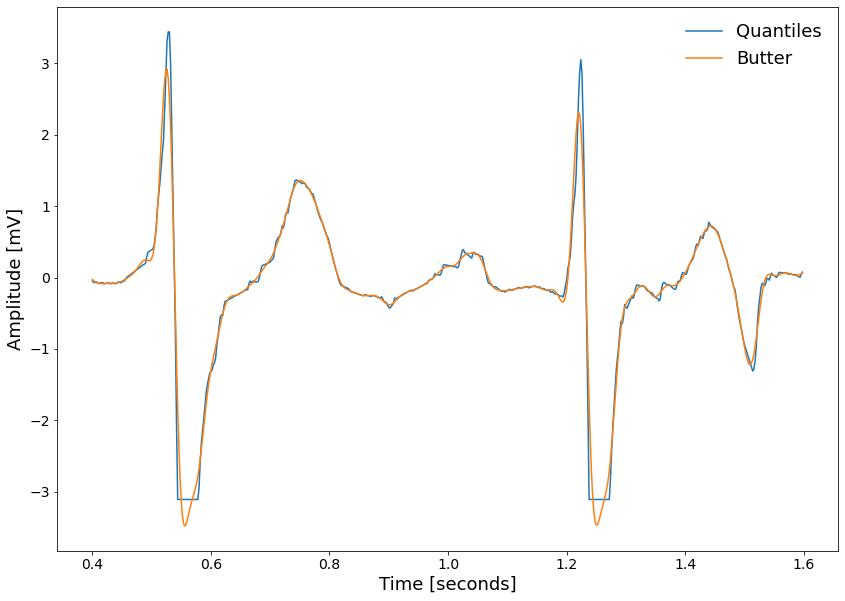

In [281]:
fig, ax = plt.subplots(figsize=(14,10))

ax.plot(x[200:800]/500, y_corrected[200:800], label='Quantiles')
ax.plot(x[200:800]/500, y_butter[200:800], label='Butter')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

Text(0, 0.5, 'Amplitude [mV]')

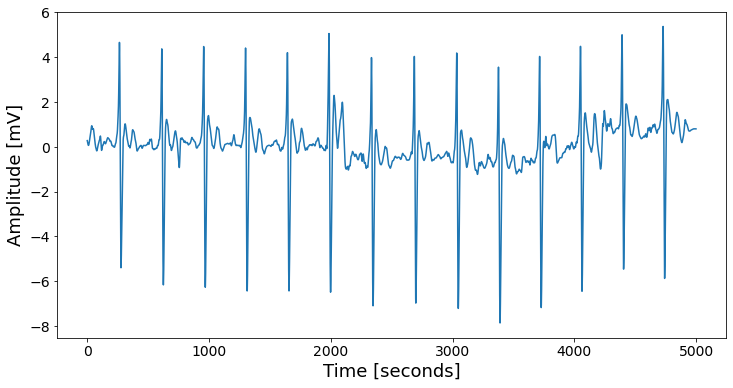

In [273]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(12,6))

# ax.plot(x, y)
ax.plot(x, yf)
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

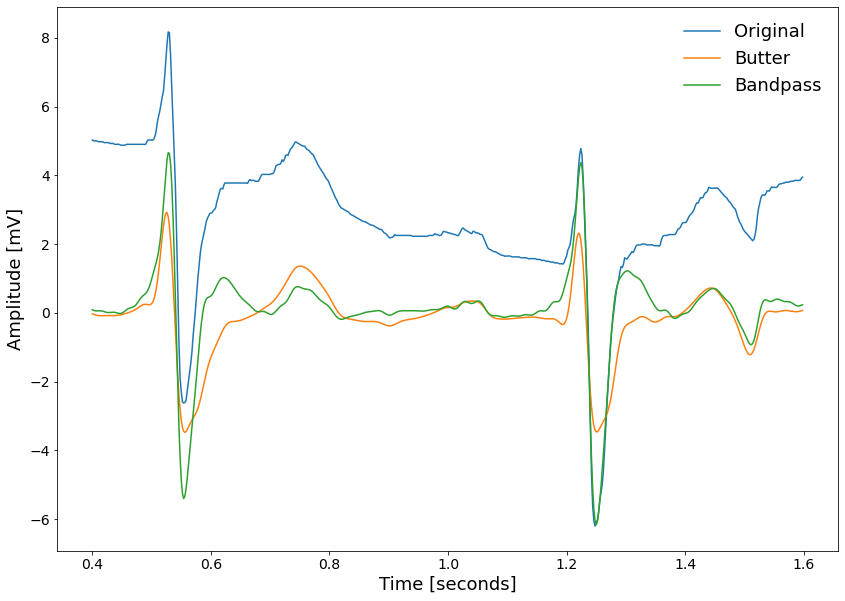

In [282]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))

ax.plot(x[200:800]/500, y[200:800], label='Original')
ax.plot(x[200:800]/500, y_butter[200:800], label='Butter')
ax.plot(x[200:800]/500, yf[200:800], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

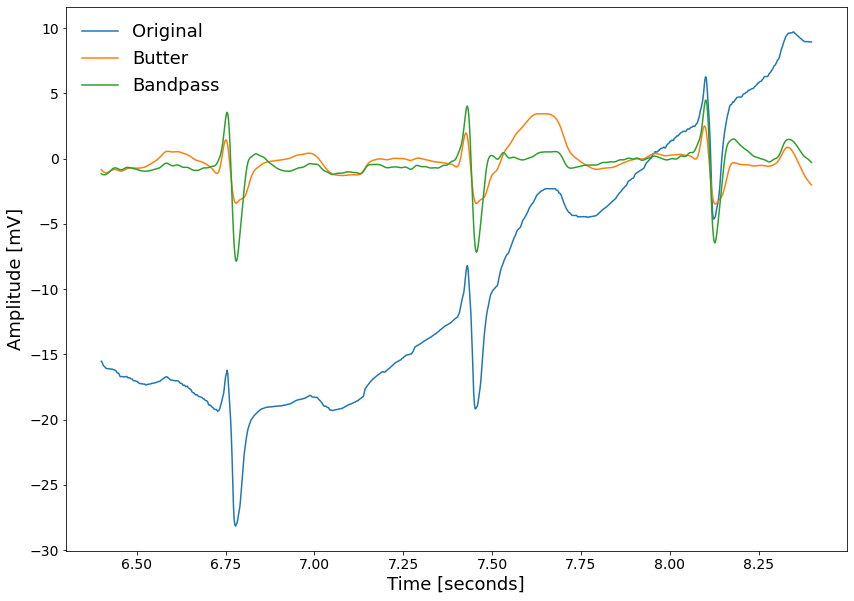

In [283]:
fig, ax = plt.subplots(figsize=(14,10))

ax.plot(x[3200:4200]/500, y[3200:4200], label='Original')
ax.plot(x[3200:4200]/500, y_butter[3200:4200], label='Butter')
ax.plot(x[3200:4200]/500, yf[3200:4200], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

### Example #1

In [186]:
k = Y_af.index[0]
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [187]:
s = 9
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [193]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=5, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.03, Wn=0.08, analysis=True)

Text(0, 0.5, 'Amplitude [mV]')

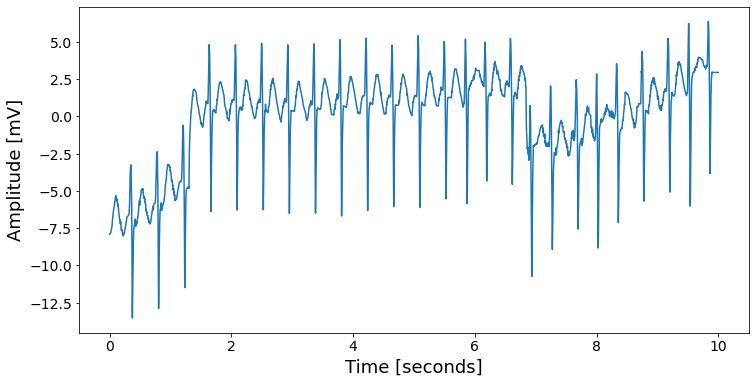

In [189]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y, label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

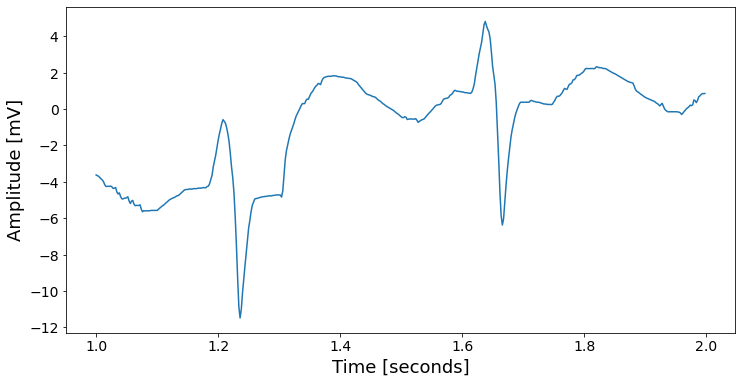

In [190]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=500,1000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

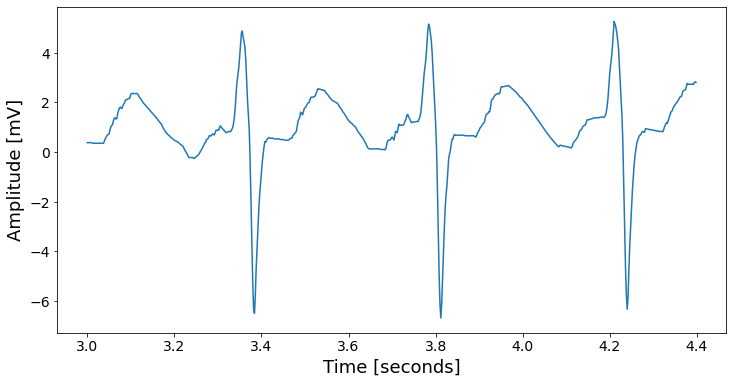

In [180]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=1500,2200
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

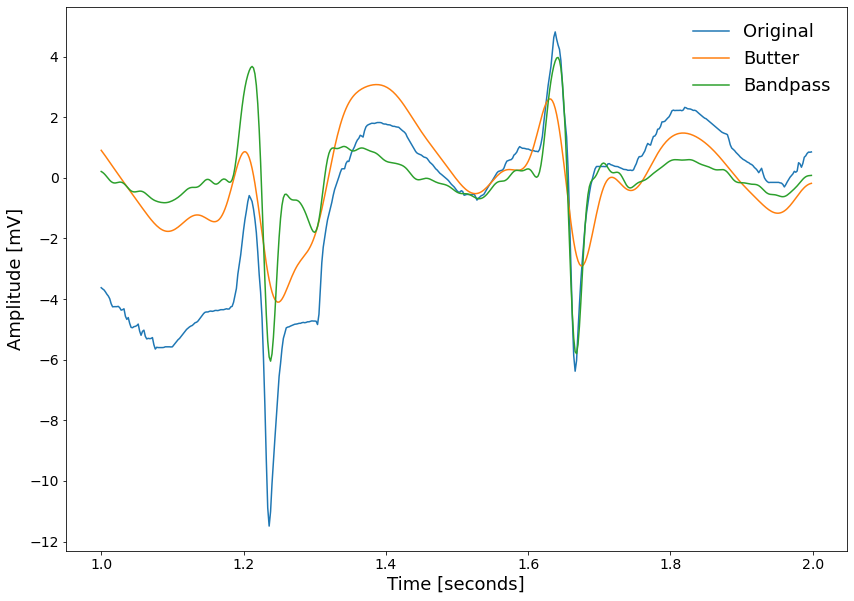

In [191]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=500,1000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

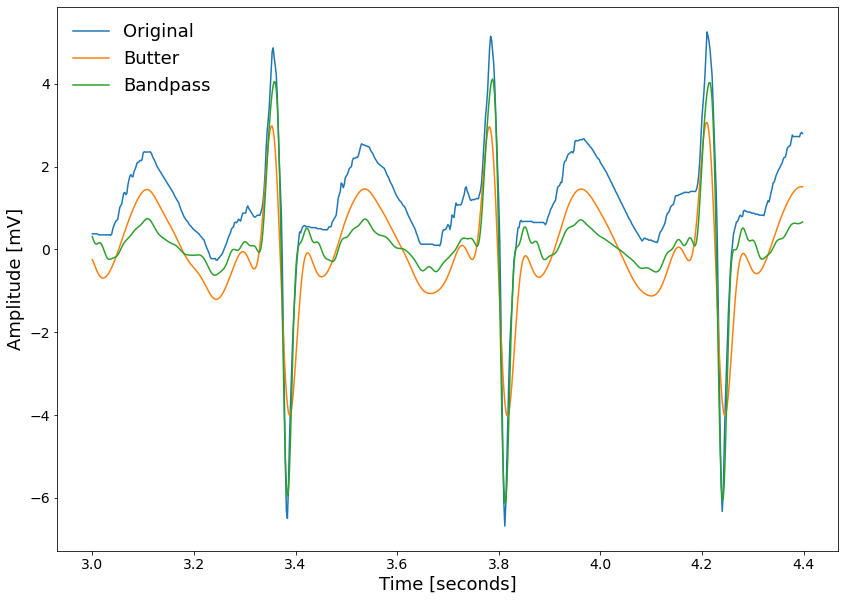

In [194]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=1500,2200
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

### Example #2

In [197]:
k = outliers.index[33]
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [198]:
s = 6
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [199]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=5, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.03, Wn=0.08, analysis=True)

Text(0, 0.5, 'Amplitude [mV]')

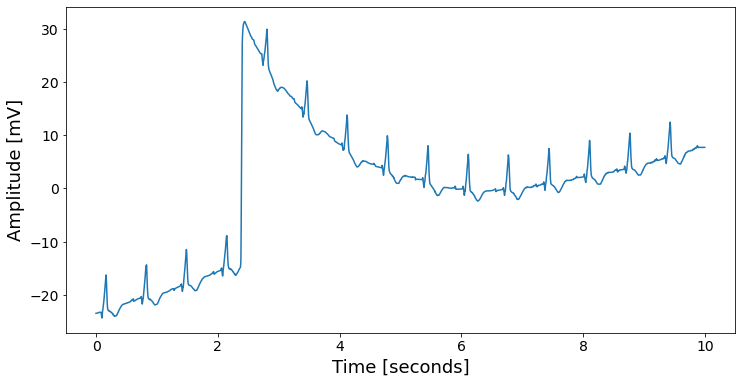

In [200]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y, label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

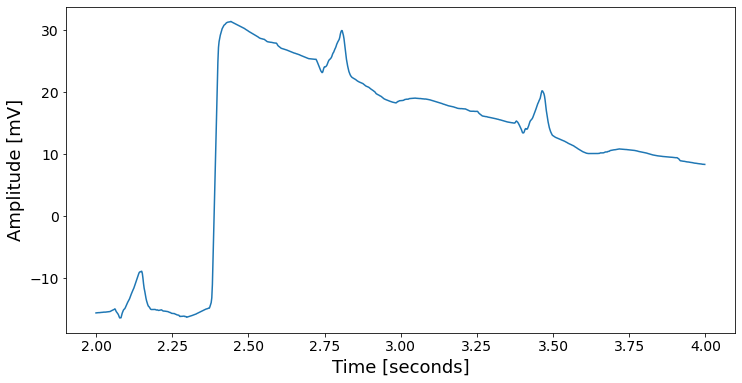

In [201]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

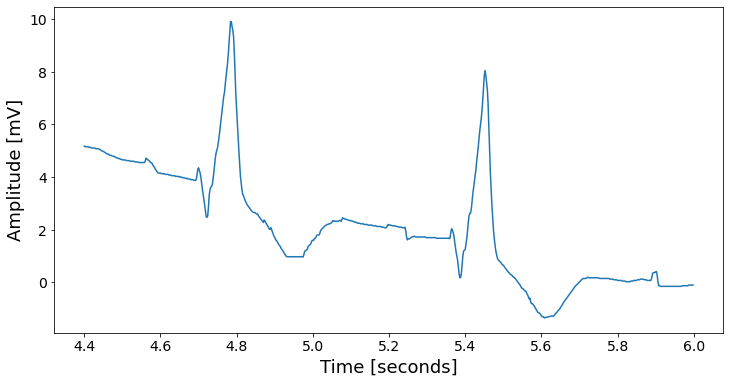

In [202]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=2200,3000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

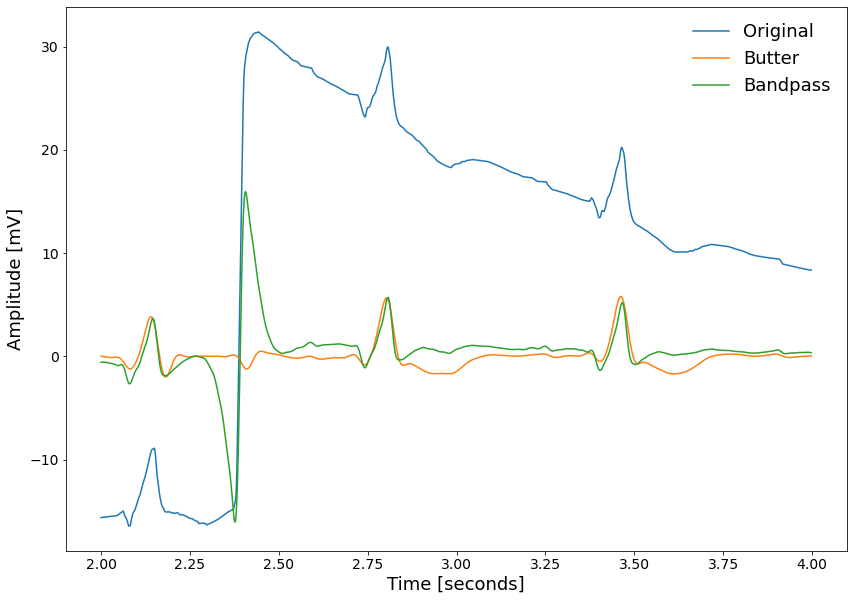

In [204]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

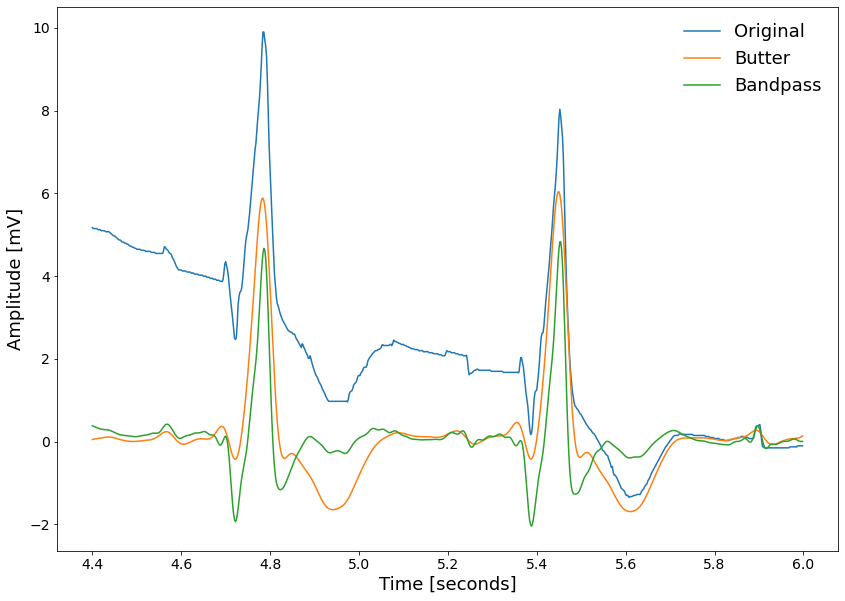

In [205]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=2200,3000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

### Example #3

In [206]:
k = outliers.index[43]
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [207]:
s = 7
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [220]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=12, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.03, Wn=0.08, analysis=True)

Text(0, 0.5, 'Amplitude [mV]')

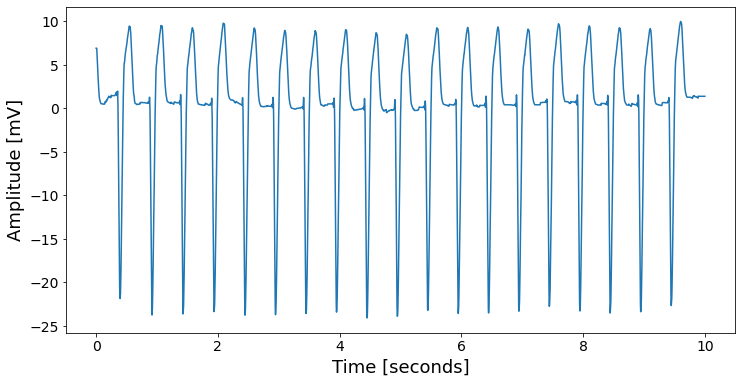

In [209]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y, label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

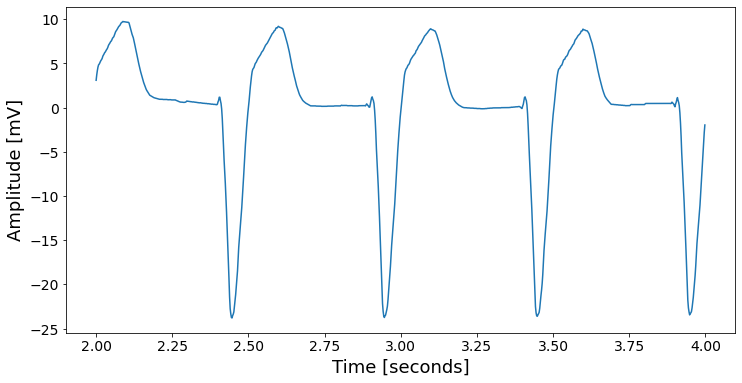

In [215]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

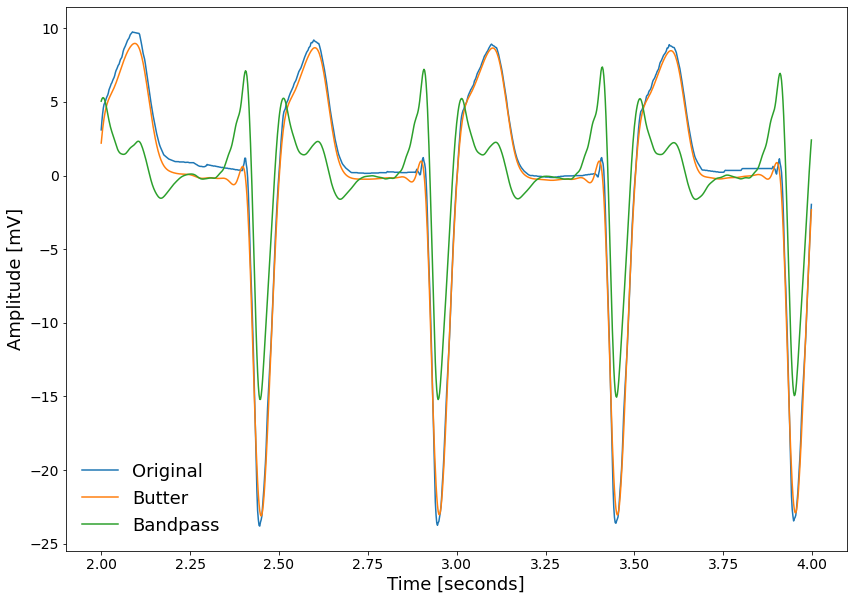

In [224]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

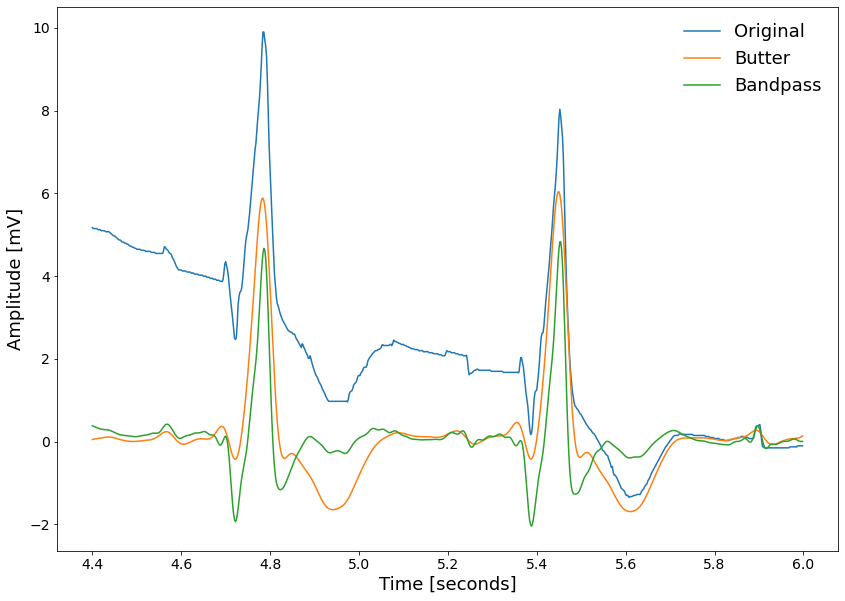

In [205]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=2200,3000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

### Example #4

In [239]:
k = outliers.index[25]
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [246]:
s = 3
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [262]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=0.62, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, Wn=0.06, analysis=True)

In [261]:
np.sort(stds_dict[idx][1])

array([0.06731085, 0.13911236, 0.16472112, 0.17616055, 0.20572346,
       0.21847386, 0.22747929, 0.24678705, 0.2487559 , 0.27531057,
       0.28021249, 0.2802919 , 0.29459835, 0.29596442, 0.29955455,
       0.31392674, 0.31520934, 0.32590726, 0.32799084, 0.32859341,
       0.33117648, 0.33694413, 0.33773741, 0.33932466, 0.33942295,
       0.34669712, 0.34869463, 0.35244086, 0.37062608, 0.39392016,
       0.39599085, 0.40583882, 0.45801003, 0.46783635, 0.4811637 ,
       0.48757179, 0.50827035, 0.51168605, 0.53808666, 0.54130369,
       0.57152384, 0.5716795 , 0.5733556 , 0.58871456, 0.60475716,
       0.61757186, 0.61894543, 0.6437172 , 0.64643444, 0.68300944])

Text(0, 0.5, 'Amplitude [mV]')

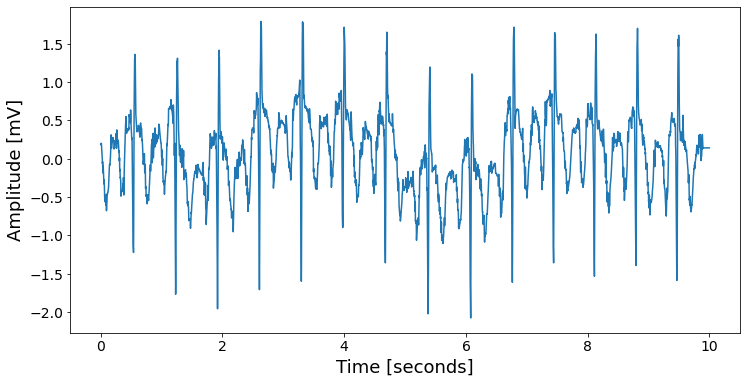

In [249]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y, label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

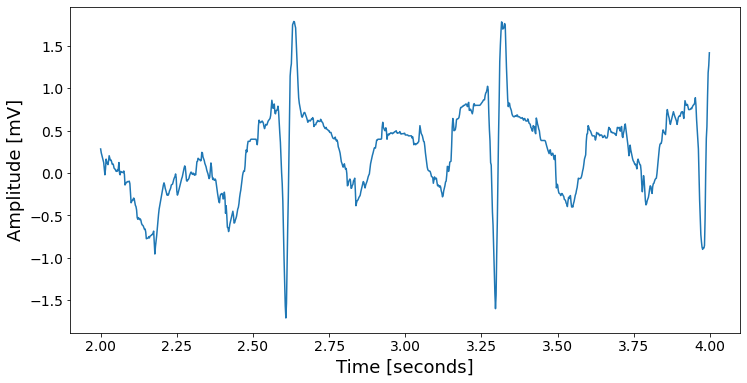

In [250]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

### Example #5

In [285]:
k = 0
example = wfdb.rdsamp(path+hea_files[k])
# metadata = {"info": example, "labels": labels, "path": None}
# pa.plot_ecg(example[0], metadata=metadata, ylim=(example[0].min(), example[0].max()))

In [286]:
s = 3
idx = str(k) + ',' + str(s)

y = example[0]
y = y[:, s]
x = np.arange(0, len(y), 1)

In [291]:
y_smoothed, stds_dict[idx] = md.smooth_ecg_signal(x, y, std_threshold=2, analysis=True)
y_new, y_corrected, y_butter, low_q_dict[idx], upp_q_dict[idx] = md.clean_ecg_signal(y, y_smoothed, low_q=0.05, Wn=0.06, analysis=True)

Text(0, 0.5, 'Amplitude [mV]')

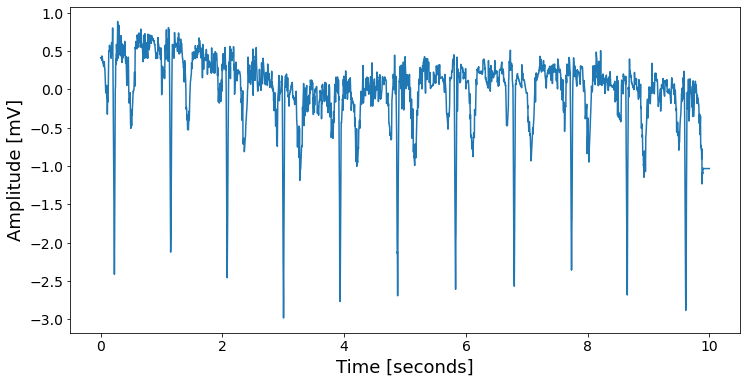

In [288]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(x/500, y, label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

Text(0, 0.5, 'Amplitude [mV]')

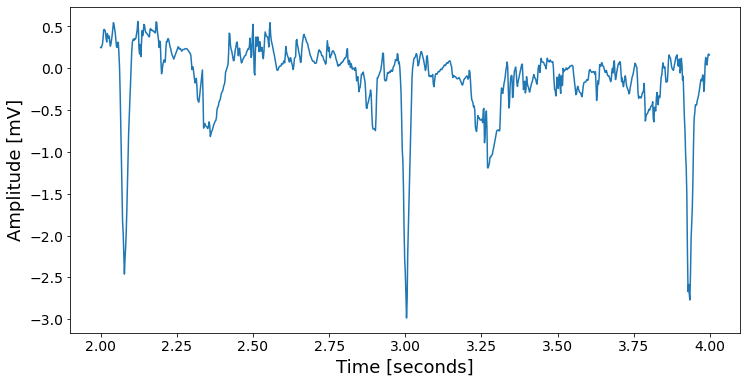

In [289]:
fig, ax = plt.subplots(figsize=(12,6))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)

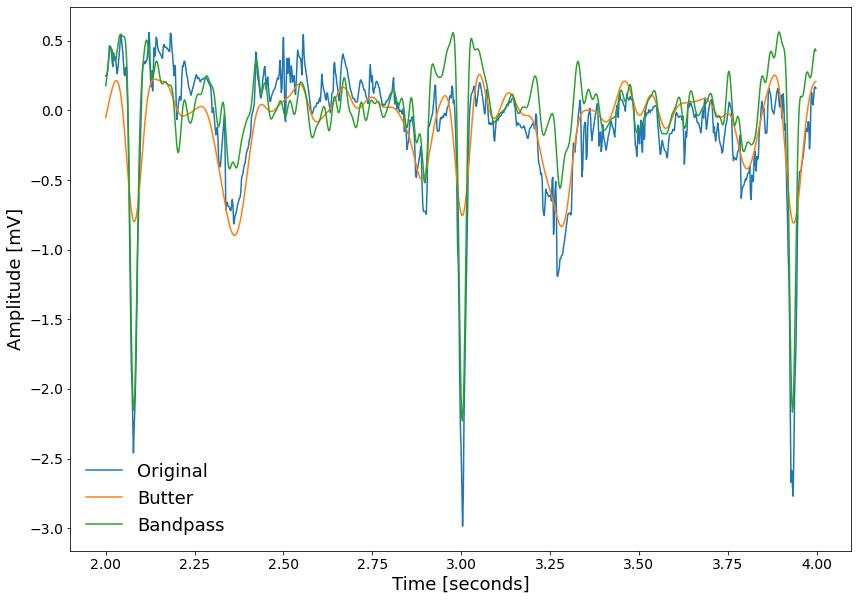

In [292]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

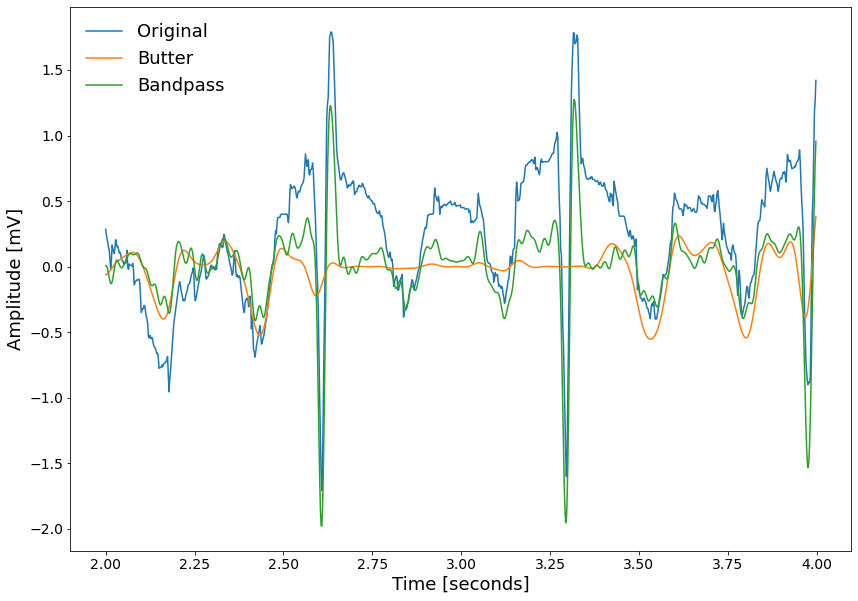

In [263]:
yf = apply_filter(y, filter_bandwidth)

fig, ax = plt.subplots(figsize=(14,10))
a,b=1000,2000
ax.plot(x[a:b]/500, y[a:b], label='Original')
ax.plot(x[a:b]/500, y_butter[a:b], label='Butter')
ax.plot(x[a:b]/500, yf[a:b], label='Bandpass')
ax.tick_params(axis='both', which='major', labelsize=14)    
ax.set_xlabel('Time [seconds]', fontsize=18)
ax.set_ylabel('Amplitude [mV]', fontsize=18)
plt.legend(fontsize=18, frameon=False)
# ax.set_title('Original Signal', fontsize=20, y=1.02)

# Best Models

We look for each model, retrieve its validation accuracy history, and calculate the mean of the last n values. This will be one metric to select the best models.

In [229]:
# Amount of values at the end to compute the mean
n_to_calculate_mean = 6

# Initialize to store the validation accuracies
mean_final_val_accuracies = {}

# For each file, retrieve the validation accuracy and store it
for path, currentDirectory, files in os.walk("models"):
    for file in files:        
        if 'csv' in file:
            
            fitted_model = pd.read_csv(os.path.join(path, file), index_col=0)
            mean_final_val_accuracies[path.split('\\')[-1] + '/' + file[:-4]] \
                    = fitted_model['val_accuracy'].tail(n_to_calculate_mean).mean()

# Convert to pd.DataFrame for easier usage
mean_final_val_accuracies = pd.DataFrame({key : [value] for key, value in mean_final_val_accuracies.items()})

# Sort
sorted_models = mean_final_val_accuracies.iloc[0].sort_values(ascending=False)
sorted_models

own/multibinary_bn_l1_dr_as_2      0.766027
own/multibinary_bn_l1_dr_3         0.763690
own/multibinary_bn_l1_dr_2         0.760876
own/multibinary_bn_l1_dr_9         0.760780
antonior92/multibinary_original    0.759445
own/multibinary_bn_l1_dr_5         0.758729
own/multibinary_bn_l1_dr_7         0.758443
own/multibinary_bn_l1_dr_8         0.758157
own/multibinary_bn_l1_dr_1         0.753673
own/multibinary_bn_l1_dr_6         0.750048
own/multibinary_bn_l1_5            0.743274
own/multibinary_bn_l1_2            0.741843
own/multibinary_bn_3               0.741748
own/multibinary_bn_l1_dr_4         0.741462
own/multibinary_bn_l1_dr_as_1      0.741080
own/multibinary_bn_2               0.740269
antonior92/multibinary_cw_lr       0.734688
own/multibinary_bn_l1_3            0.731826
own/multibinary_bn_1               0.728201
own/multibinary_2                  0.725720
own/multibinary_bn_l1_1            0.713366
own/multibinary_1                  0.705686
own/multibinary_bn_l1_cw_1      

# Checking mV differences

The mV signal might